# Step one: Question(main goal)
### What are the major trends and sentiment by tourists in Ethiopia? What are the major tourist sites and what can be improved?


# Step two: Get and clean the data
### Data Gathering 
**Current Data**- already annotated data.


In [2]:
import pandas as pd
alldata=pd.read_excel('TripAdvisorData.xlsx')
alldata.Review_Content[0]

"Do it!  Unique building with al fresco dining complete with breathtaking views.  Excellent food which I only downgraded one star because some of the meat was chewy and probably would have benefited from a more slow and low cook process.  But that's just me!  I'm...More"

In [3]:
import matplotlib.pyplot as plt

### Data Cleaning
**Lowercase**<br>
**Remove Punctuation**<br>
**Remove numbers**<br>
**Stop words**<br>
**Stemming/Lemmatization**<br>


In [4]:
#import nltk
#nltk.download('wordnet')
#nltk.download('stopwords')

In [5]:
#data cleaning functions
import re
import string
import nltk
from nltk.stem import PorterStemmer
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords
def clean_data(review):
    """This is the first data cleaning function.
    
    Parameters: reviews given by the users
    simple cleaning like lowercasing, punctuation and digit removal
    """
    review=review.lower() #lowercasing 
    review= re.sub('[%s]' % re.escape(string.punctuation), '', review) #remove punctuation
    review=re.sub('\w*\d\w*', '', review) #remove words with digits
    return review

def stemming(review):
    """ This function will convert the words in the reviews to their stemmatized format. 
    It will remove the common suufix and prefix on the English Langauge. 
    The output may not always be a valid word. We are using Porter Stemming Algorthim.
    
    Parameter: review with words to be stemmed.  
    """
    wordsInReview= review.split()
    word_stemmer = PorterStemmer()
    wordsInReview= [word_stemmer.stem(word) for word in wordsInReview]
    return wordsInReview
 
def lemmatization(review):
    """ This function will convert the words in the reviews to their lemma.  
    The output is always a valid word. We are using the Word Net Lemmaztization function from the nltk toolkit.
    
    Parameter: review with words to be lemmatized.  
    """
    #wordsInReview= review.split()
    lemmatizer = WordNetLemmatizer()
    wordsInReview= [lemmatizer.lemmatize(word) for word in review]
    return wordsInReview


######tokenize reviews
def tokenize(reviews):
    """This is a function that will tokenize the reviews as words
    
    Parameters:reviews
    
    """
    tokens = re.split('\W+',reviews)
    return tokens



stopwords = set(stopwords.words('english'))

def remove_stopwords(reviews):
    """This is a function that will remove stop words from the reviews
    
    Parameters:reviews
    
    """
    review_clean = [word for word in reviews if word not in stopwords]
    return reviews

#alldata['cleaned_reviews'].apply(lambda x: remove_stopwords(x))

#cleaned_reviews = alldata.cleaned_reviews

#alldata

In [6]:
cleanData=pd.DataFrame()
cleanData=alldata.drop(columns=['Review_Content'])
cleanData['Review']=alldata.Review_Content.apply(lambda review: clean_data(review))
cleanData['Review']=cleanData.Review.apply(lambda review:tokenize(review))
cleanData['Review']=cleanData.Review.apply(lambda review:remove_stopwords(review))
cleanData['Review']=cleanData.Review.apply(lambda review: lemmatization(review))

cleanData

,Name,Location,Category,Date,Review
0,Ben Abeba,Lalibela,Go eat,2015-04-01,"[do, it, unique, building, with, al, fresco, d..."
1,The Four Sisters Restaurant,Gonder,Go eat,2016-04-01,"[we, ate, at, four, sister, for, dinner, one, ..."
2,Ben Abeba,Lalibela,Go eat,2016-04-01,"[we, heard, the, food, wa, good, and, we, also..."
3,The Four Sisters Restaurant,Gonder,Go eat,2016-04-01,"[went, here, twice, and, sat, inside, the, fir..."
4,Sishu,Addis Ababa,Go eat,2017-04-01,"[not, comparable, to, the, standard, american,..."
...,...,...,...,...,...
21830,Maribela Hotel,Lalibela,Go Rest,2020-09-09,"[cant, say, enough, about, how, much, i, loved..."
21831,Hyatt Regency Addis Ababa,Addis Ababa,Go Rest,2020-09-10,"[i, wa, conducted, a, business, at, hyatt, reg..."
21832,Panoramic View Hotel,Lalibela,Go Rest,2020-09-10,"[i, have, been, staying, at, panoramic, hotel,..."
21833,Taye Belay Hotel,Gonder,Go Rest,2020-09-10,"[excellent, and, unique, hotel, in, central, g..."


In [7]:
#divide the data into the three catgories.
def get_by_category(category):
    """This function will return a dataframe for each category from the metadata
    
    Parameters:
    category: value of the category coloumn in the meta data
    """
    
    catdata=cleanData.loc[alldata['Category']==category]
    catdata=catdata.drop(columns=['Category'])
    return catdata

restaurantdata=get_by_category("Go eat")
hoteldata=get_by_category("Go Rest")
explorationdata=get_by_category("Go Play")


list_of_categories=[restaurantdata, hoteldata, explorationdata]


In [8]:
cleanData['Review_Whole']=cleanData.Review.apply(lambda review: " ".join(review))
def get_whole_review(data):
    data['Review_Whole']=data.Review.apply(lambda review: " ".join(review))
    
for category in list_of_categories:
    get_whole_review(category)

In [9]:
from sklearn.feature_extraction.text import CountVectorizer
cv = CountVectorizer(stop_words='english')

def get_dtm(cv, data):
    cat_cv=cv.fit_transform(data.Review_Whole)
    cat_dtm=pd.DataFrame(cat_cv.toarray(),columns=cv.get_feature_names())
    cat_dtm.index = data.index
    return cat_dtm

rest_dtm=get_dtm(cv, restaurantdata)
hotel_dtm=get_dtm(cv, hoteldata)
exploration_dtm=get_dtm(cv, explorationdata)



# Step three: EDA

#### Top Words with number of Users

1. For the whole data set

In [10]:
#data_dtm_transpose=data_dtm.transpose()
#data_dtm_transpose.head()
import numpy as np
rest_dtm_transpose=rest_dtm.transpose()
hotel_dtm_transpose=hotel_dtm.transpose()
explore_dtm_transpose=exploration_dtm.transpose()

In [11]:
list_of_cat_dtm_transpose=[rest_dtm_transpose, hotel_dtm_transpose, explore_dtm_transpose]

In [12]:

def get_top_words(data_dtm_t, number_of_words):
    """
    This function will get the top words from a given document term matrix.
    
    Parameters:
    data_dtm_t: the transposed document term matrix from which the top words will be extracted
    number_of_words:the number of top words that the user wants to see
    
    """
    
    none_zero_dict={}
    for user in data_dtm_t.columns:
        top=data_dtm_t[user].sort_values(ascending=False)
        #none_zero_dict[user]=list(zip([top.index, top.values] if np.nonezero(top.values)))
        none= np.nonzero(top.values)
        for ind in none:
            none_zero_dict[user]=list(zip([top[ind].index, top[ind].values]))
            #print(top[index])
    word_count={}
    users={}
    for  user, top_words in none_zero_dict.items():
        for words, count in zip(top_words[0][0], top_words[1][0]):
            #word_count[words]=0
            #print(word_count[words])
            #word_count.keys=words
            if words in word_count.keys():
                word_count[words]= word_count[words]+ count
                users[words]= users[words]+1
            else:
                word_count[words]= count
                users[words]= 1
        #print(top_words[1])
       # print([ word for word in top_words])
    
    word_count_df=pd.DataFrame.from_dict(word_count, orient='index')
    word_count_df.rename(columns={0: 'frequency'}, inplace=True)
    word_count_df["users"]=pd.DataFrame.from_dict(users, orient='index')[0]
    word_count_df=word_count_df.sort_values(by=['frequency'], ascending=False).head(number_of_words)
    #print(word_count_df.columns)
    return word_count_df


<Figure size 7200x3600 with 0 Axes>

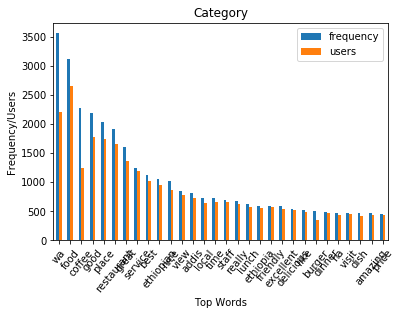

<Figure size 7200x3600 with 0 Axes>

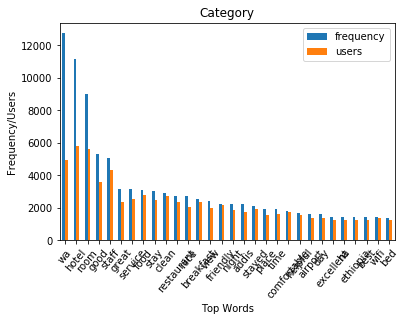

<Figure size 7200x3600 with 0 Axes>

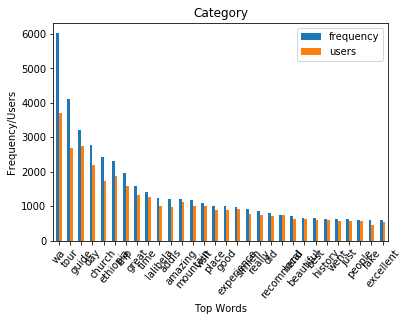

In [13]:
#get the top words
#top_words=get_top_words(data_dtm_tranpose, 50)

def plot_top_words(dtm_transpose, num, i, title="" ):
    """
    This function will take the dtm transpose and the number of top words the user wants to extract.
    It will then plot the top words with a bar graph showing both the frequency and the number of users that 
    have used the top words. 
    
    Parameters:
    dtm_transpose: the transposed document term matrix
    num: the number of top words the user wants to see.
    
    """
    top_words=get_top_words(dtm_transpose, num)
    plt.figure(figsize=(100,50))
    top_words.plot.bar()
    plt.xticks(rotation=50)
    plt.xlabel("Top Words")
    plt.ylabel("Frequency/Users")
    plt.title(title)
    plt.savefig('topword_' + str(i) + '.png', dpi=100)
    plt.show()


for i,dtm_transpose in enumerate(list_of_cat_dtm_transpose):
    plot_top_words(dtm_transpose, 30, i, "Category")

In [14]:
# Let's make some word clouds!
#!conda install -c conda-forge wordcloud
from wordcloud import WordCloud

wordcloud = WordCloud( background_color="white", colormap="Dark2",
               max_font_size=150, random_state=42)
#text=''
#for review in cleanData.Review_Whole:
 #   text= text + review
def word_cloud_generator(text,i, title=""):
    """
    This function will generate a word cloud from a given text.
    """
    wordcloud = WordCloud().generate(text)
    # Display the generated image:
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis("off")
    plt.title(title)
    plt.savefig('wordcloud_' + str(i) + '.png', dpi=100)
    plt.show()
    
def word_cloud(data,i, title=""):
    rest_text=''
    for review in data.Review_Whole:
        rest_text= rest_text + review
    word_cloud_generator(rest_text,i, title)

    
    
#word_cloud_generator(text)

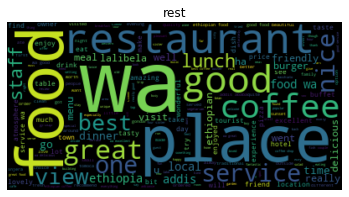

In [15]:
word_cloud(restaurantdata,0, "rest")

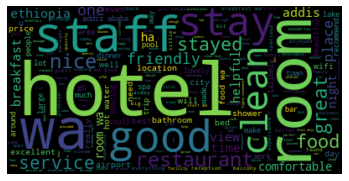

In [16]:
word_cloud(hoteldata,1)

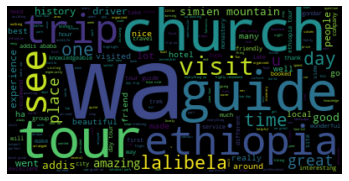

In [17]:
word_cloud(explorationdata,2)

### Reviews per hotel

In [18]:
def get_reviews_by_place(hotel_name, data):
    return data.loc[data['Name'] == hotel_name]
def get_place_names(data):
    return data.Name.unique()
#yeha_reviews=get_reviews_by_hotel("Yeha Hotel", restaurantdata)   
def word_cloud_per_place(data):
    list_of_places=get_place_names(data)
    print("Total number of places: " + str(len(list_of_places)))
    for i, place in enumerate(list_of_places):
        place_review = get_reviews_by_place(place, data)
        print("NAME: "+ place)
        word_cloud(place_review,i,place)

In [19]:
# get top words per place
def get_top_words_by_place(cv, data):
    list_of_places=get_place_names(data)
    print("Total number of places: " + str(len(list_of_places)))
    for i,place in enumerate(list_of_places):
        print("place: "+ place)
        place_review = get_reviews_by_place(place, data) 
        dtm=get_dtm(cv,place_review)
        dtm_transpose=dtm.transpose()
        top_words=get_top_words(dtm_transpose, 10)
        plot_top_words(dtm_transpose, 10, i,place)



Total number of places: 64
NAME: Ben Abeba


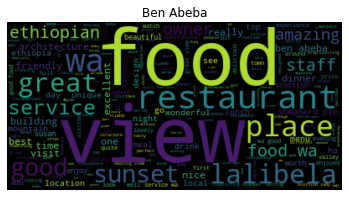

NAME: The Four Sisters Restaurant


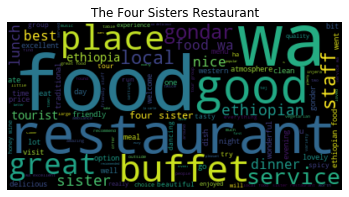

NAME: Sishu


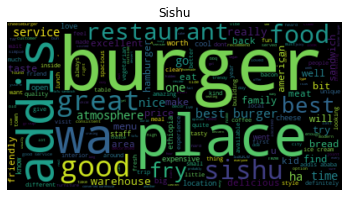

NAME: La Mandoline


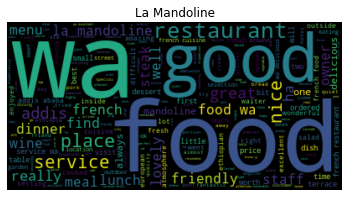

NAME: Makush Art Gallery & Italian Restaurant


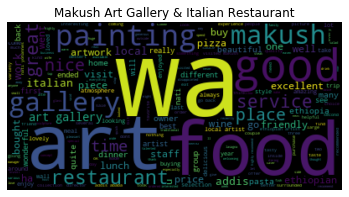

NAME: Jewel of India


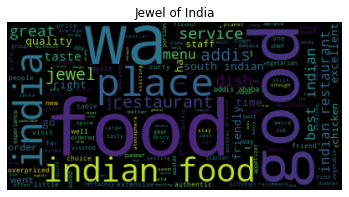

NAME: Kana Restaurant and Bar


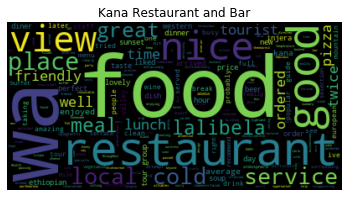

NAME: Tomoca


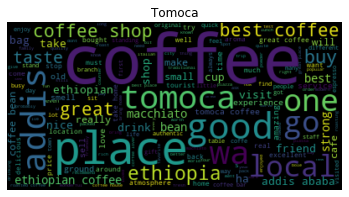

NAME: Kuda Juice & Pizzeria


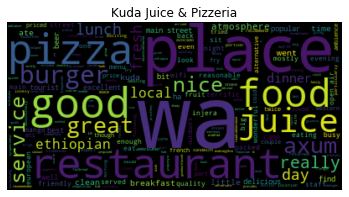

NAME: Five Loaves


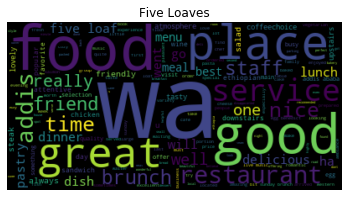

NAME: Wude Coffee


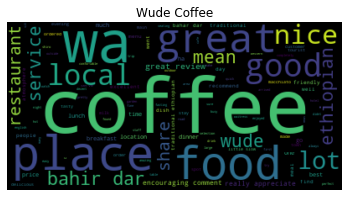

NAME: Unique Restaurant


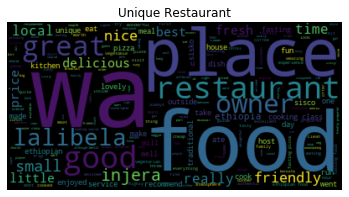

NAME: Blue Jayz Restaurant


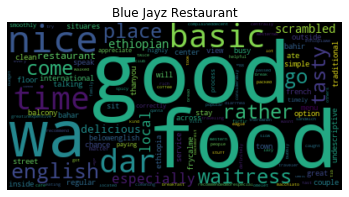

NAME: Beefmn Garden Bar and Restaurant


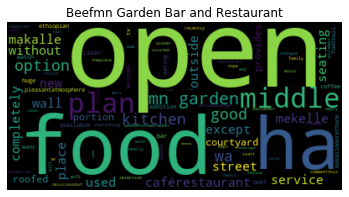

NAME: Yod Abyssinia Traditional Food


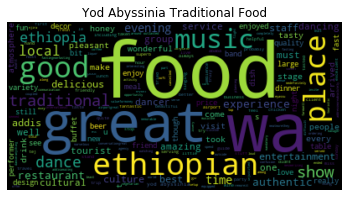

NAME: Moyos Cafe


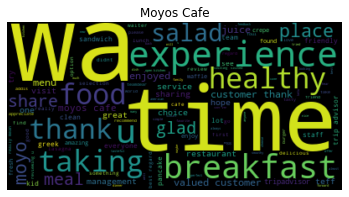

NAME: Dolce Vita


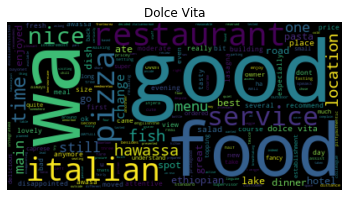

NAME: Fikir Coffee


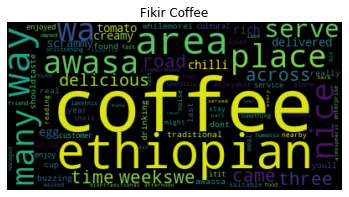

NAME: Lake Shore Restaurant


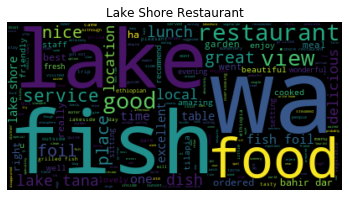

NAME: EROS ADDIS Fusion Restaurant & Lounge


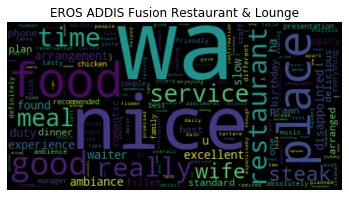

NAME: Goha Hotel


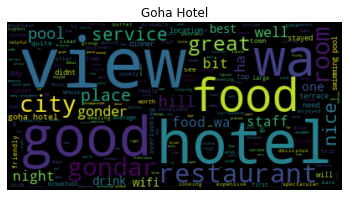

NAME: Maed Lalibela Restaurant


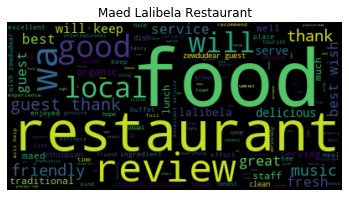

NAME: Karibu Kitchen


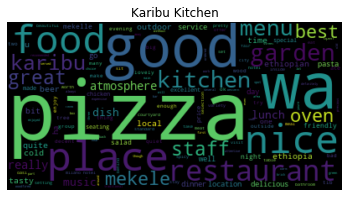

NAME: Mountain View Hotel Bar & Restaurant


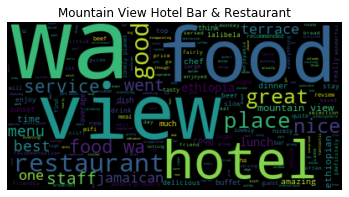

NAME: Seven Olives Hotel Restaurant


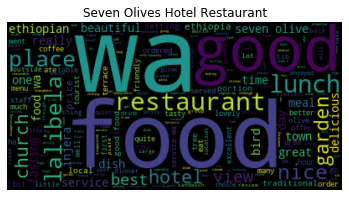

NAME: Samiel G/Slasse Gebru Restaurant


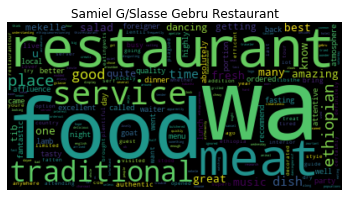

NAME: Kategna Restaurant


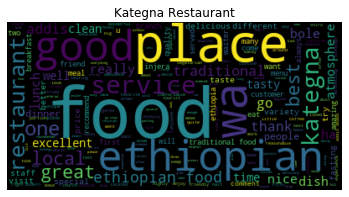

NAME: Maribela Hotel, Restaurant & Lounge


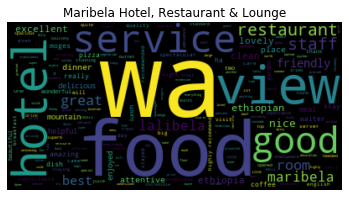

NAME: Habesha Coffee


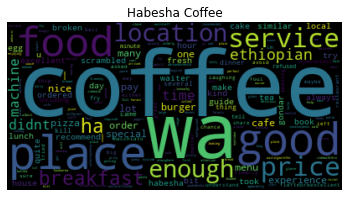

NAME: Chaka Coffee


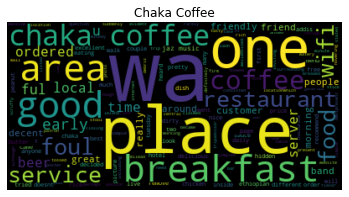

NAME: Lasta Café


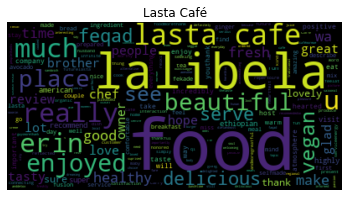

NAME: Wawi Pizzeria


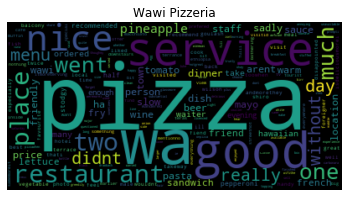

NAME: Soma Restaurant


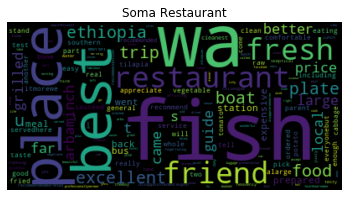

NAME: Castel Kuriftu Wine House and Restaurant Bahir Dar


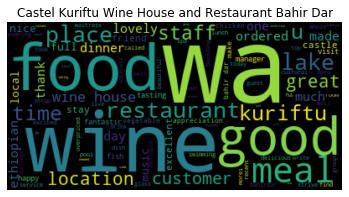

NAME: Desset Lodge


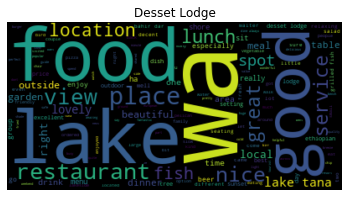

NAME: Roza Pizza


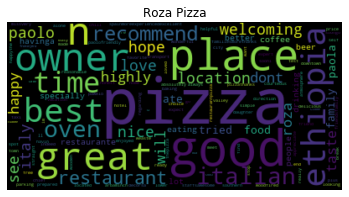

NAME: Top View Restaurant


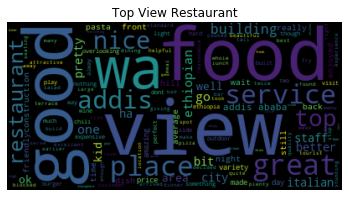

NAME: Master Chef


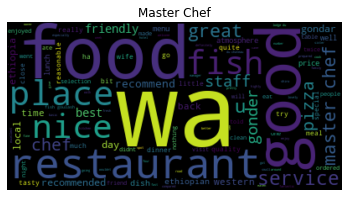

NAME: Restaurant Chez Meron


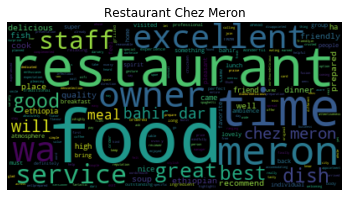

NAME: Taye Belay Hotel Restaurant


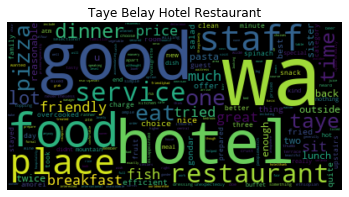

NAME: Venezia Italian Restaurant


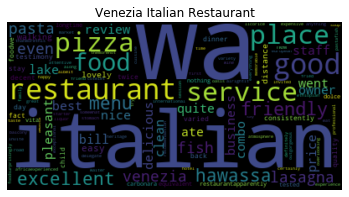

NAME: Old Abyssinia Lodge and Restaurant


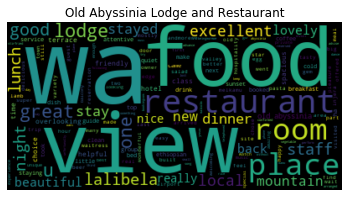

NAME: Rico's Restaurant


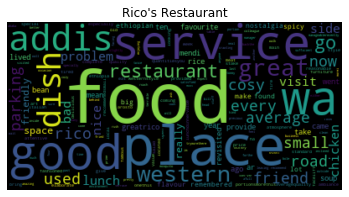

NAME: Lewi Cafe


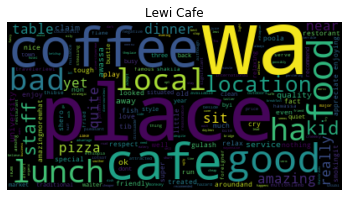

NAME: JEBM Restaurant


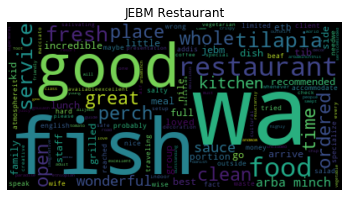

NAME: Seven Lakes Restaurant


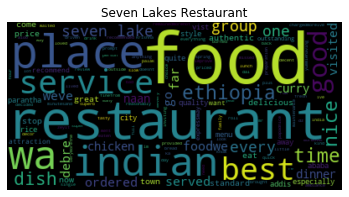

NAME: Checheo cultural restaurant


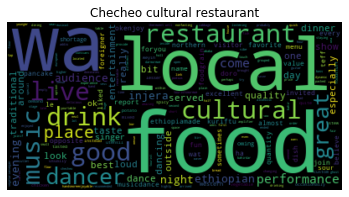

NAME: AB Cultural Restaurant


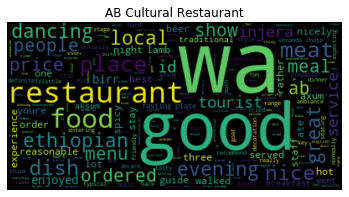

NAME: Hi Life


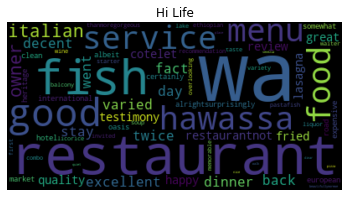

NAME: Liesak


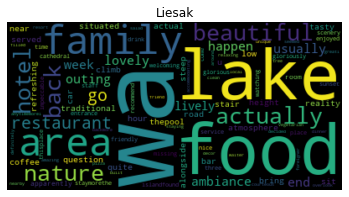

NAME: Grub on burger


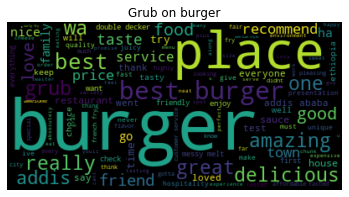

NAME: Bait Al Mandi


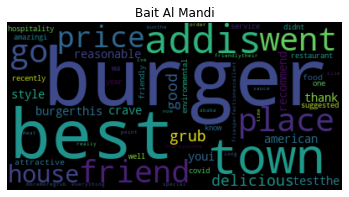

NAME: Alem Cooking Class Bar and Restaurant


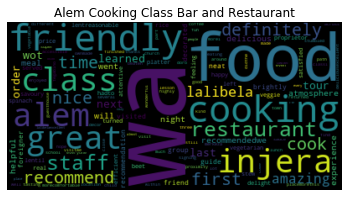

NAME: Abay Cultural Restaurant


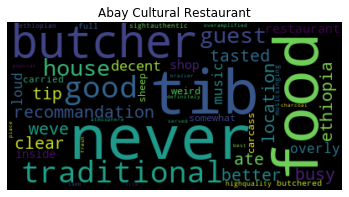

NAME: Terres des Saveurs


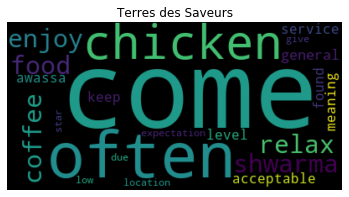

NAME: Abay Minch Lodge Restaurant


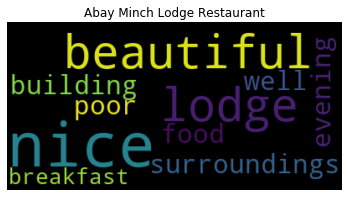

NAME: Selam Awassa Technical And Vocational Training College


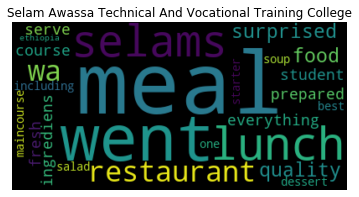

NAME: The Kitchen


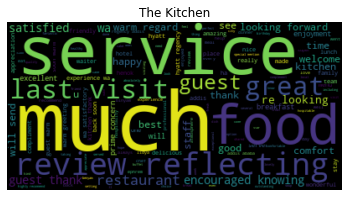

NAME: Lucy Cultural Restaurant


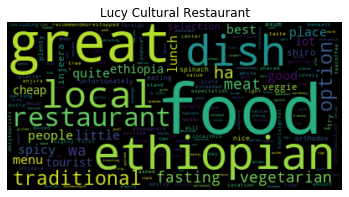

NAME: Antica Special Cultural Restaurant


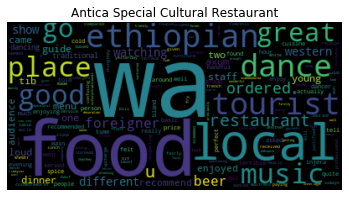

NAME: Lucy Traditional Restaurant


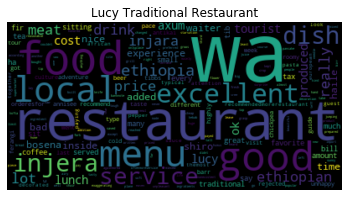

NAME: Africa Hotel


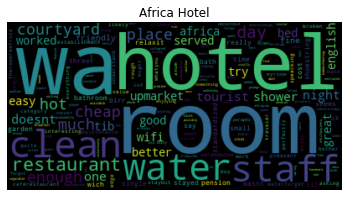

NAME: Aksum Classical Restaurant


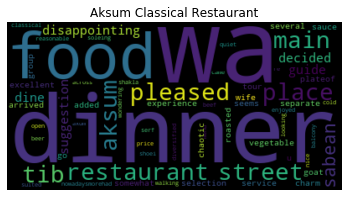

NAME: Yeha Hotel


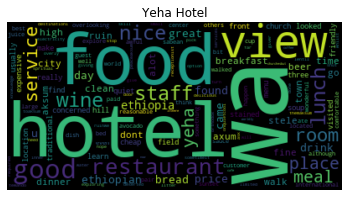

Total number of places: 64
place: Ben Abeba


<Figure size 7200x3600 with 0 Axes>

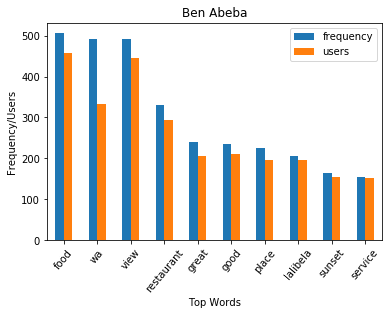

place: The Four Sisters Restaurant


<Figure size 7200x3600 with 0 Axes>

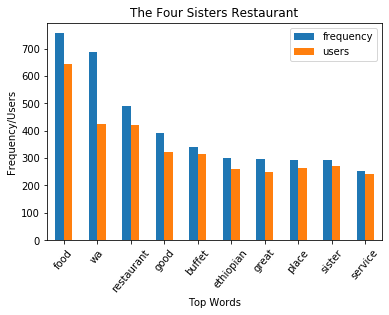

place: Sishu


<Figure size 7200x3600 with 0 Axes>

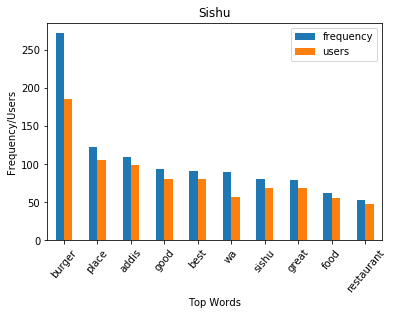

place: La Mandoline


<Figure size 7200x3600 with 0 Axes>

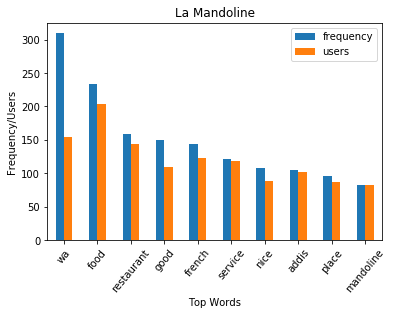

place: Makush Art Gallery & Italian Restaurant


<Figure size 7200x3600 with 0 Axes>

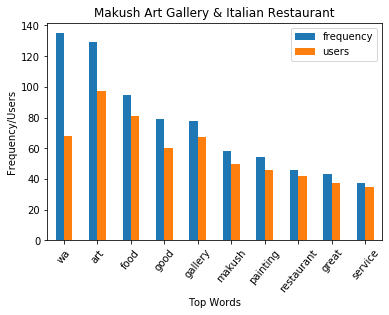

place: Jewel of India


<Figure size 7200x3600 with 0 Axes>

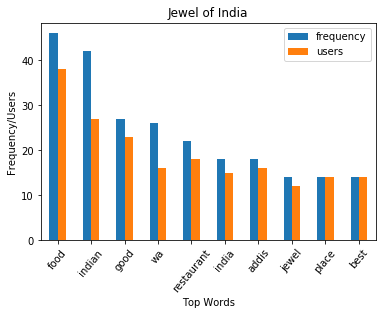

place: Kana Restaurant and Bar


<Figure size 7200x3600 with 0 Axes>

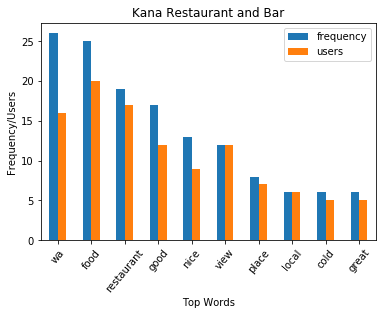

place: Tomoca


<Figure size 7200x3600 with 0 Axes>

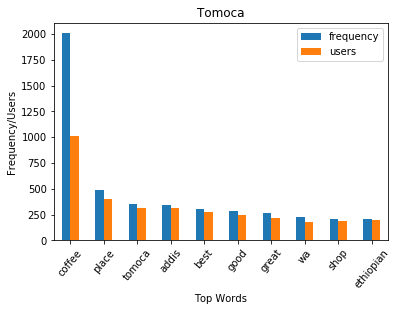

place: Kuda Juice & Pizzeria


<Figure size 7200x3600 with 0 Axes>

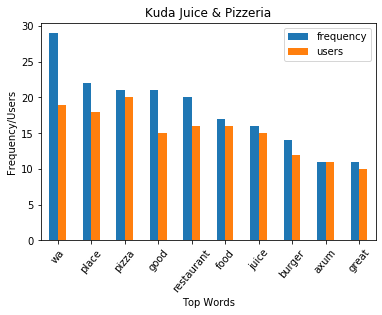

place: Five Loaves


<Figure size 7200x3600 with 0 Axes>

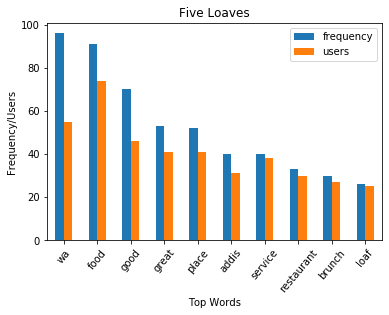

place: Wude Coffee


<Figure size 7200x3600 with 0 Axes>

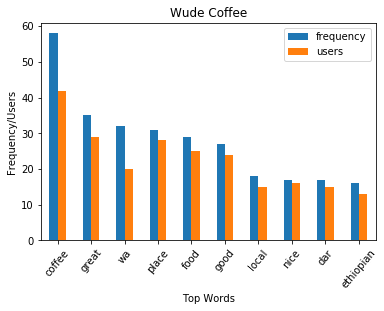

place: Unique Restaurant


<Figure size 7200x3600 with 0 Axes>

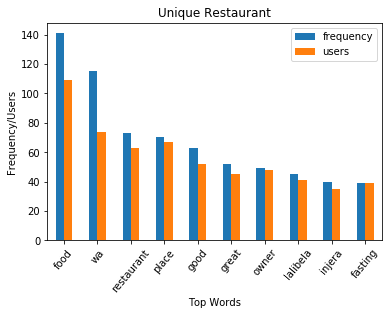

place: Blue Jayz Restaurant


<Figure size 7200x3600 with 0 Axes>

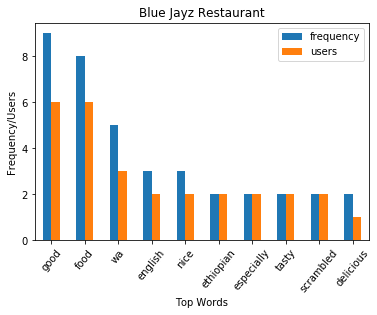

place: Beefmn Garden Bar and Restaurant


<Figure size 7200x3600 with 0 Axes>

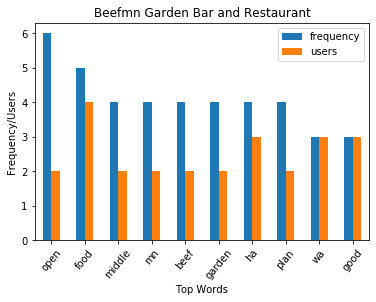

place: Yod Abyssinia Traditional Food


<Figure size 7200x3600 with 0 Axes>

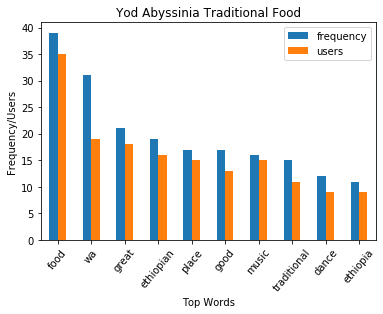

place: Moyos Cafe


<Figure size 7200x3600 with 0 Axes>

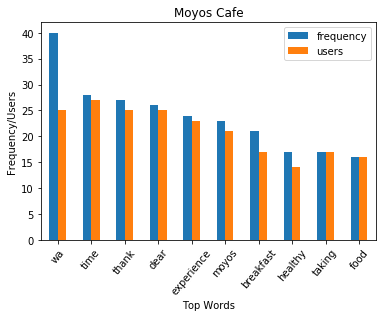

place: Dolce Vita


<Figure size 7200x3600 with 0 Axes>

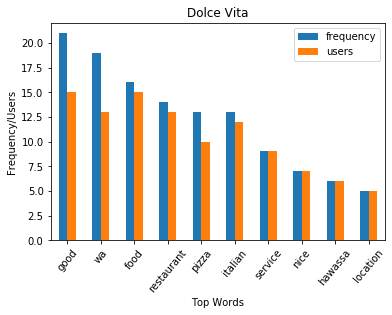

place: Fikir Coffee


<Figure size 7200x3600 with 0 Axes>

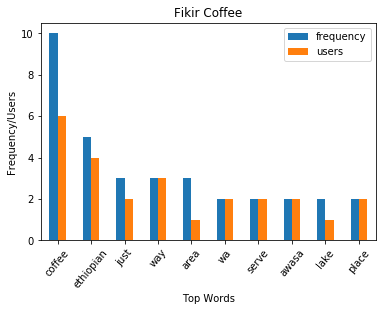

place: Lake Shore Restaurant


<Figure size 7200x3600 with 0 Axes>

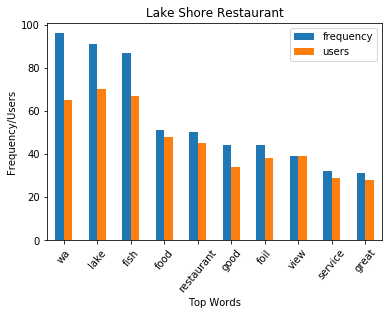

place: EROS ADDIS Fusion Restaurant & Lounge


<Figure size 7200x3600 with 0 Axes>

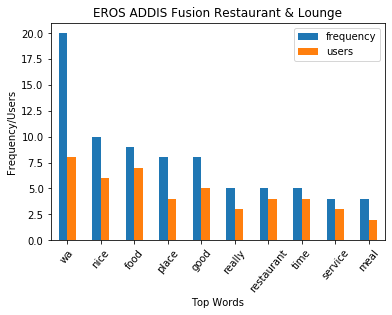

place: Goha Hotel


<Figure size 7200x3600 with 0 Axes>

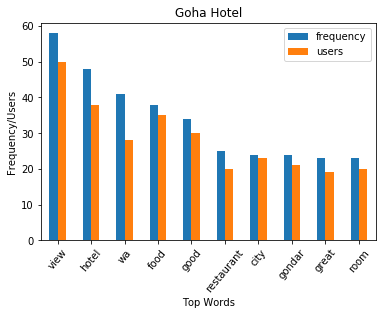

place: Maed Lalibela Restaurant


<Figure size 7200x3600 with 0 Axes>

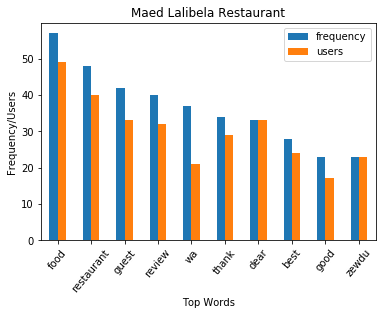

place: Karibu Kitchen


<Figure size 7200x3600 with 0 Axes>

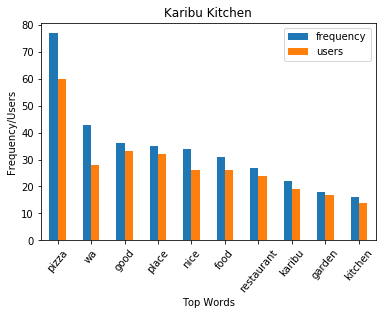

place: Mountain View Hotel Bar & Restaurant


<Figure size 7200x3600 with 0 Axes>

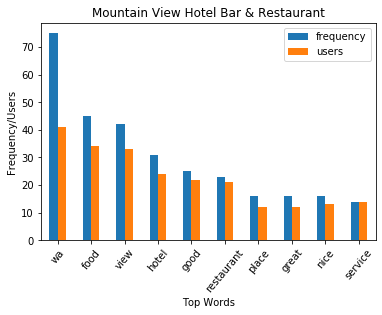

place: Seven Olives Hotel Restaurant


<Figure size 7200x3600 with 0 Axes>

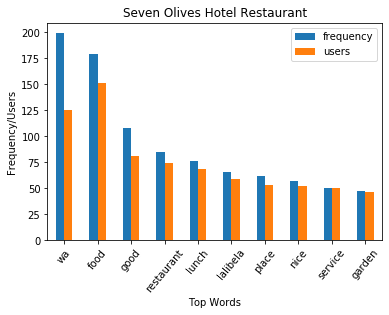

place: Samiel G/Slasse Gebru Restaurant


<Figure size 7200x3600 with 0 Axes>

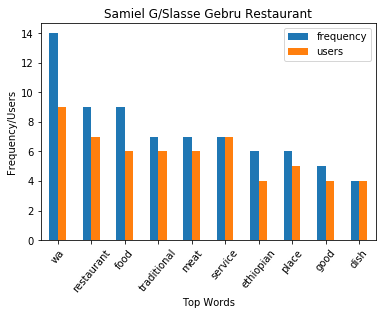

place: Kategna Restaurant


<Figure size 7200x3600 with 0 Axes>

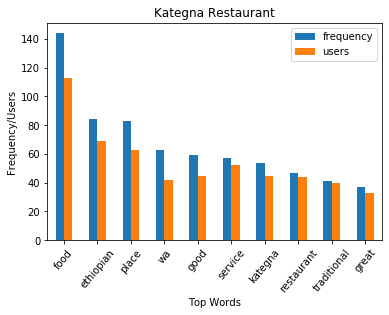

place: Maribela Hotel, Restaurant & Lounge


<Figure size 7200x3600 with 0 Axes>

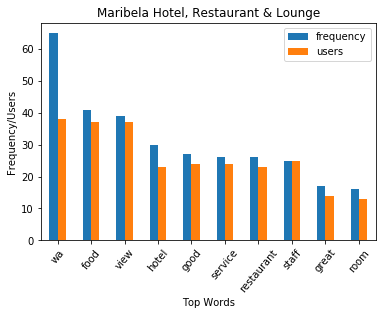

place: Habesha Coffee


<Figure size 7200x3600 with 0 Axes>

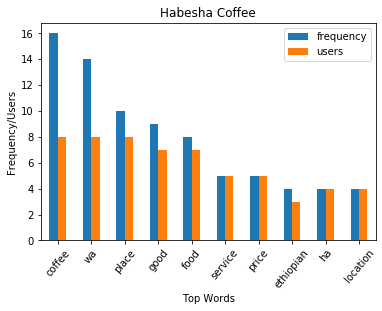

place: Chaka Coffee


<Figure size 7200x3600 with 0 Axes>

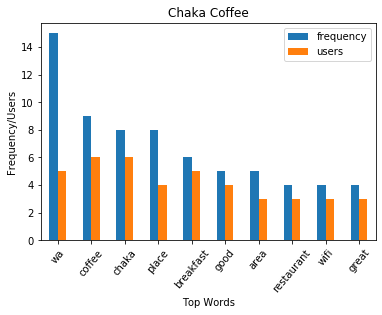

place: Lasta Café


<Figure size 7200x3600 with 0 Axes>

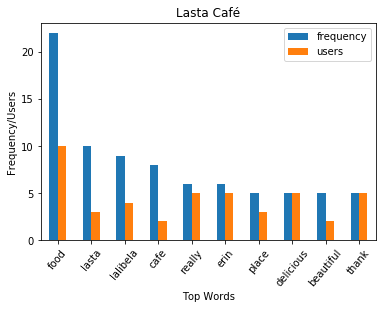

place: Wawi Pizzeria


<Figure size 7200x3600 with 0 Axes>

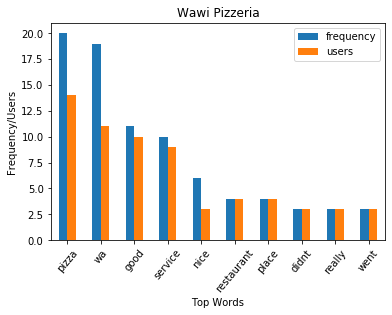

place: Soma Restaurant


<Figure size 7200x3600 with 0 Axes>

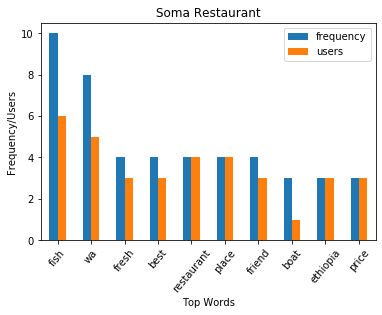

place: Castel Kuriftu Wine House and Restaurant Bahir Dar


<Figure size 7200x3600 with 0 Axes>

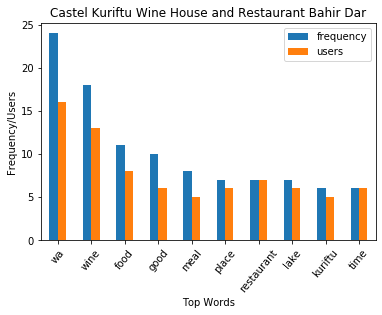

place: Desset Lodge


<Figure size 7200x3600 with 0 Axes>

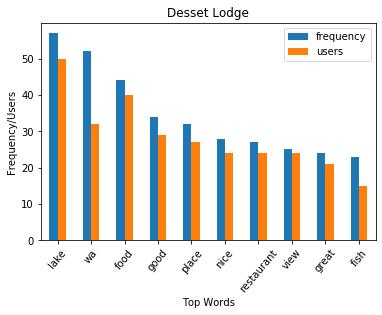

place: Roza Pizza


<Figure size 7200x3600 with 0 Axes>

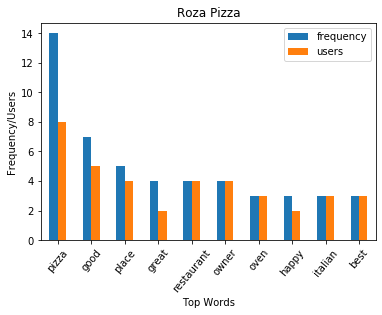

place: Top View Restaurant


<Figure size 7200x3600 with 0 Axes>

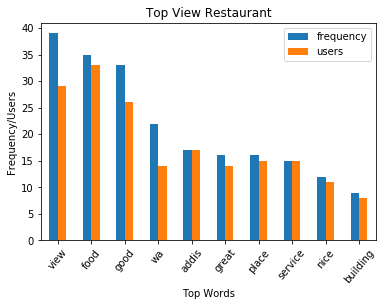

place: Master Chef


<Figure size 7200x3600 with 0 Axes>

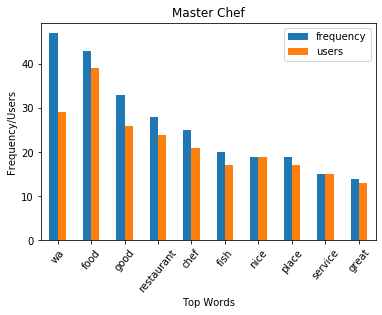

place: Restaurant Chez Meron


<Figure size 7200x3600 with 0 Axes>

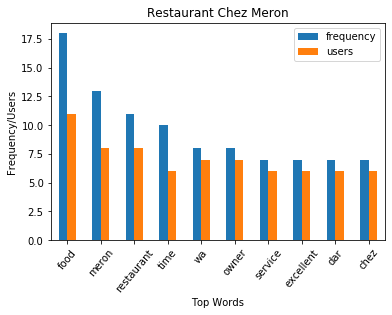

place: Taye Belay Hotel Restaurant


<Figure size 7200x3600 with 0 Axes>

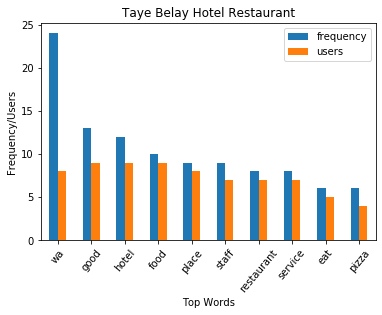

place: Venezia Italian Restaurant


<Figure size 7200x3600 with 0 Axes>

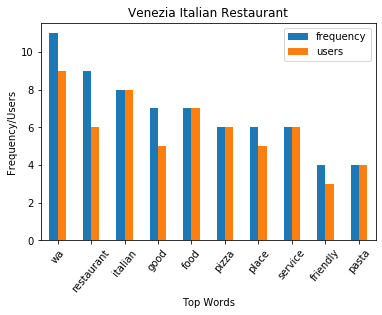

place: Old Abyssinia Lodge and Restaurant


<Figure size 7200x3600 with 0 Axes>

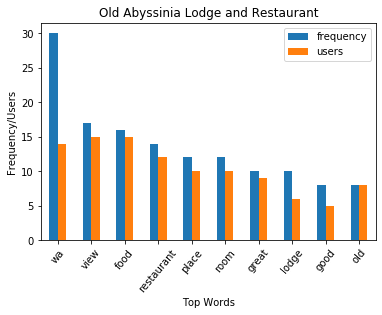

place: Rico's Restaurant


<Figure size 7200x3600 with 0 Axes>

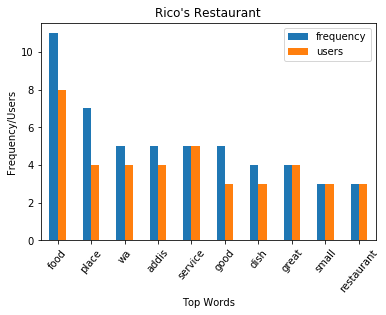

place: Lewi Cafe


<Figure size 7200x3600 with 0 Axes>

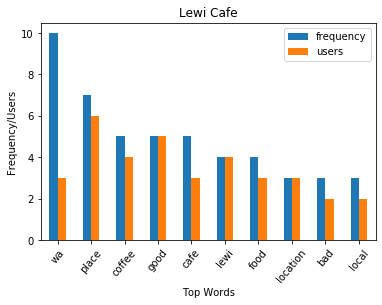

place: JEBM Restaurant


<Figure size 7200x3600 with 0 Axes>

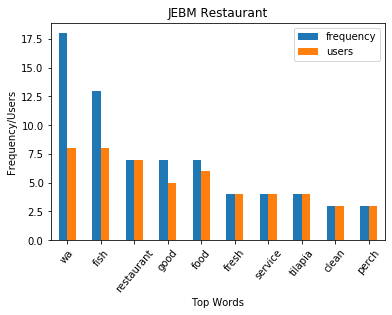

place: Seven Lakes Restaurant


<Figure size 7200x3600 with 0 Axes>

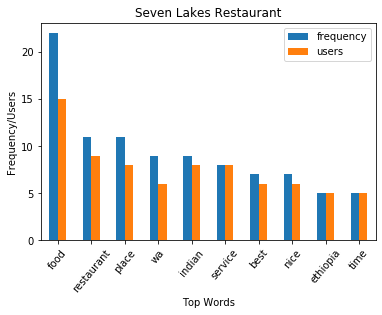

place: Checheo cultural restaurant


<Figure size 7200x3600 with 0 Axes>

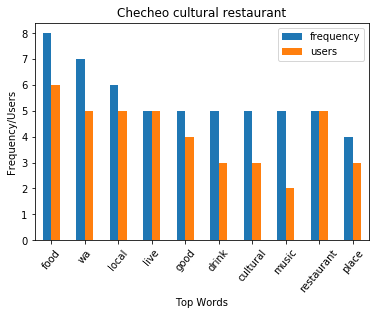

place: AB Cultural Restaurant


<Figure size 7200x3600 with 0 Axes>

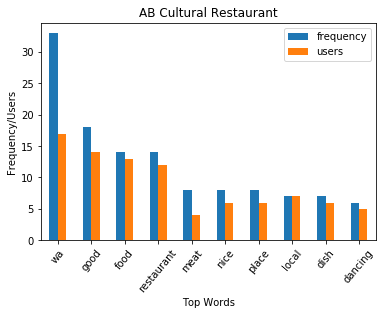

place: Hi Life


<Figure size 7200x3600 with 0 Axes>

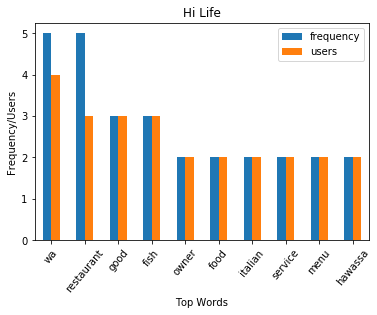

place: Liesak


<Figure size 7200x3600 with 0 Axes>

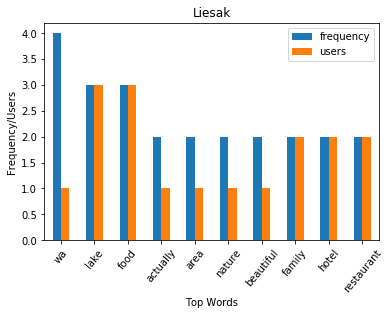

place: Grub on burger


<Figure size 7200x3600 with 0 Axes>

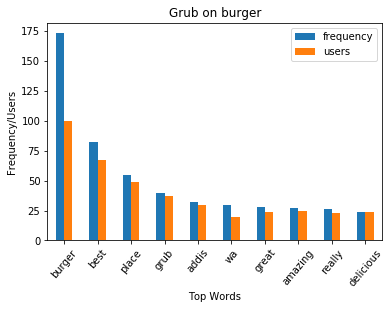

place: Bait Al Mandi


<Figure size 7200x3600 with 0 Axes>

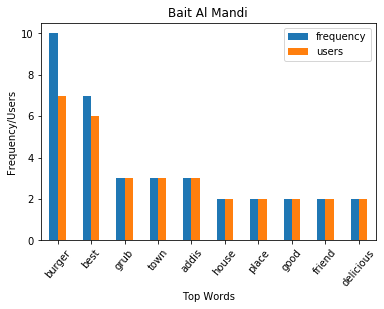

place: Alem Cooking Class Bar and Restaurant


<Figure size 7200x3600 with 0 Axes>

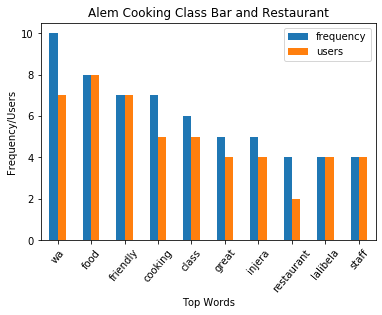

place: Abay Cultural Restaurant


<Figure size 7200x3600 with 0 Axes>

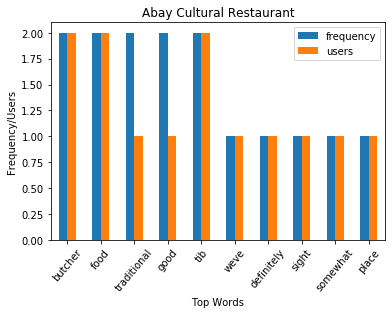

place: Terres des Saveurs


<Figure size 7200x3600 with 0 Axes>

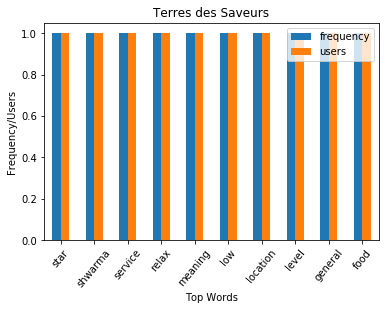

place: Abay Minch Lodge Restaurant


<Figure size 7200x3600 with 0 Axes>

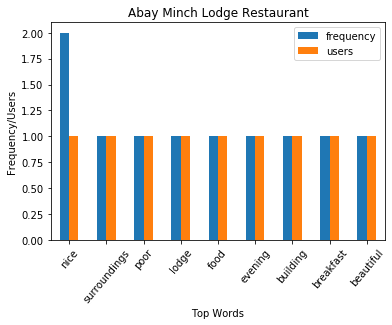

place: Selam Awassa Technical And Vocational Training College


<Figure size 7200x3600 with 0 Axes>

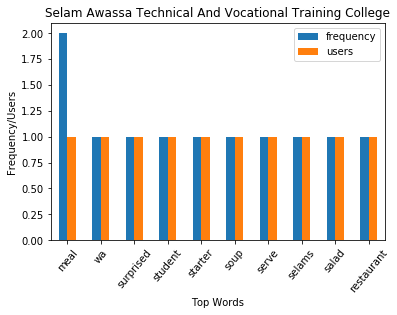

place: The Kitchen


<Figure size 7200x3600 with 0 Axes>

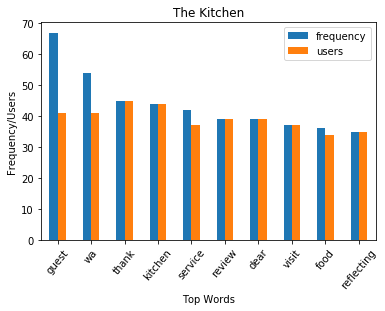

place: Lucy Cultural Restaurant


<Figure size 7200x3600 with 0 Axes>

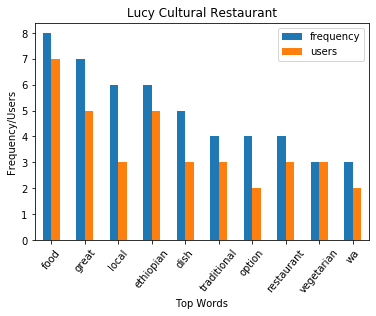

place: Antica Special Cultural Restaurant


<Figure size 7200x3600 with 0 Axes>

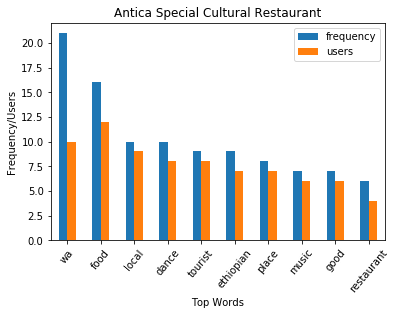

place: Lucy Traditional Restaurant


<Figure size 7200x3600 with 0 Axes>

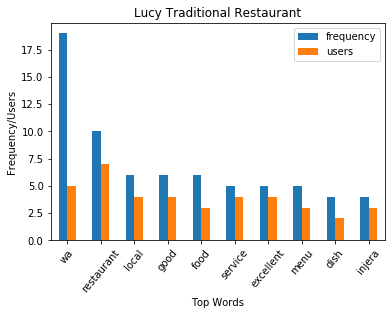

place: Africa Hotel


<Figure size 7200x3600 with 0 Axes>

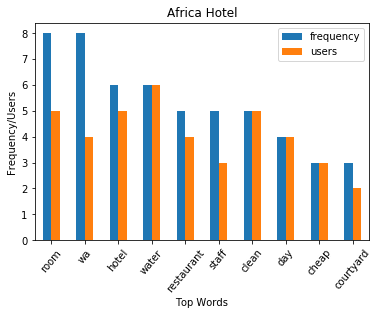

place: Aksum Classical Restaurant


<Figure size 7200x3600 with 0 Axes>

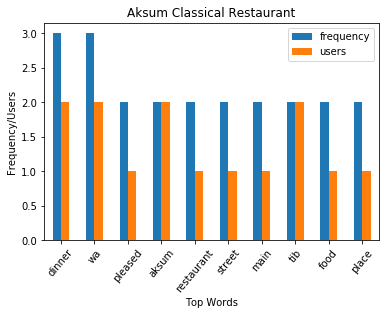

place: Yeha Hotel


<Figure size 7200x3600 with 0 Axes>

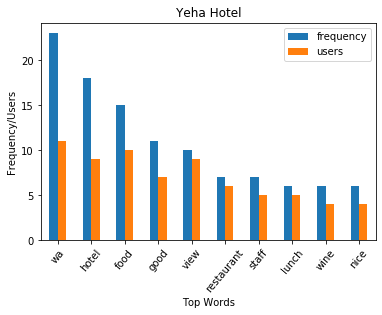

In [20]:
word_cloud_per_place(restaurantdata)
get_top_words_by_place(cv, restaurantdata)

Total number of places: 71
NAME: Sheraton Addis, a Luxury Collection Hotel, Addis Ababa


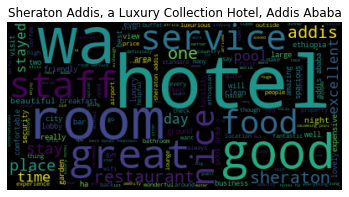

NAME: Axum Hotel


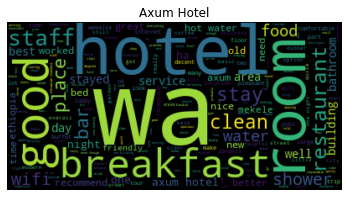

NAME: Mountain View Hotel


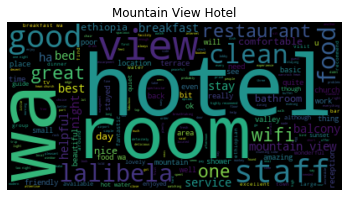

NAME: Caravan Hotel


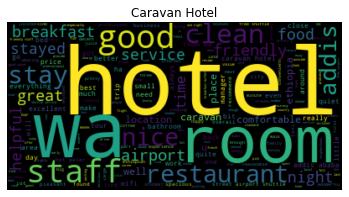

NAME: Nazra Hotel


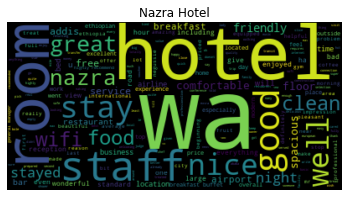

NAME: Addis Regency Hotel


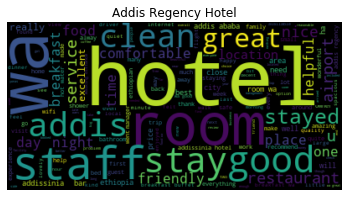

NAME: Radisson Blu Hotel, Addis Ababa


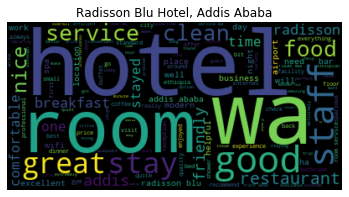

NAME: Maribela Hotel


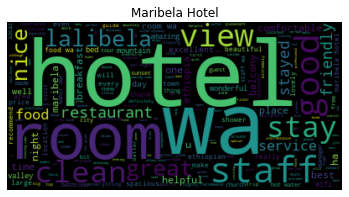

NAME: Kuriftu Resort


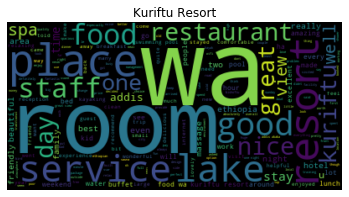

NAME: Addissinia Hotel


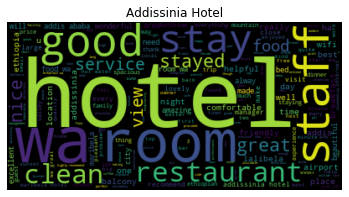

NAME: Capital Hotel and Spa


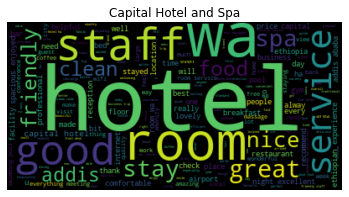

NAME: Harbe Hotel


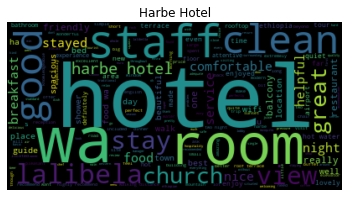

NAME: Lal Hotel & Spa Lalibela


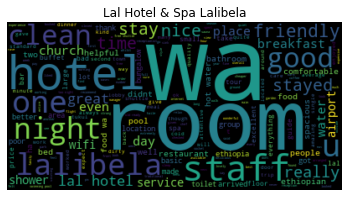

NAME: Haile Resort Hawassa


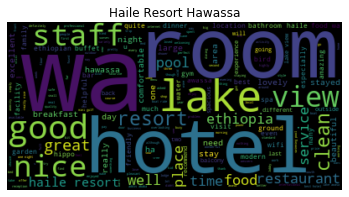

NAME: Golden Tulip Addis Ababa Hotel


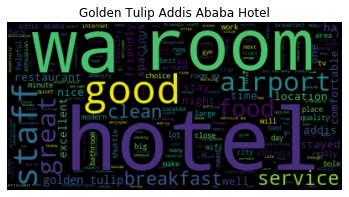

NAME: Hyatt Regency Addis Ababa


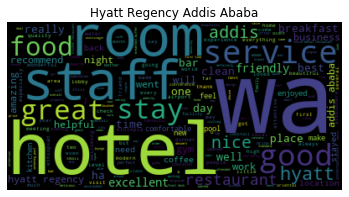

NAME: Panoramic View Hotel


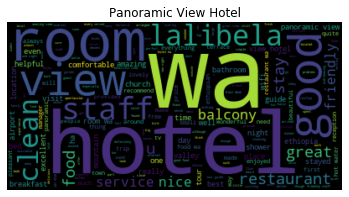

NAME: Haile Hotel, Shashemenne


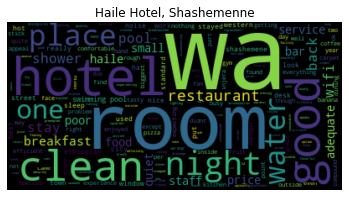

NAME: Jupiter International Hotel - Bole


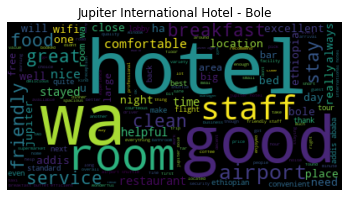

NAME: Goha Hotel


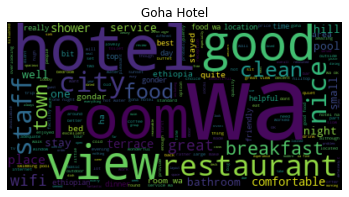

NAME: Paradise Lodge Arbaminch


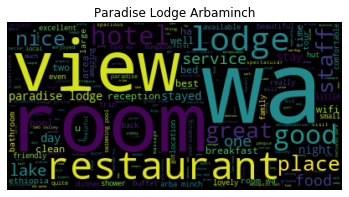

NAME: Kuriftu Resort & Spa Bahir Dar


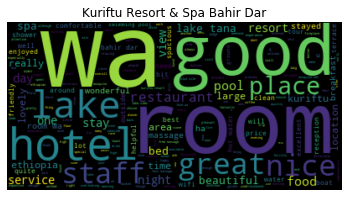

NAME: Delano Hotel & Spa


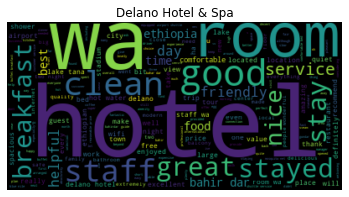

NAME: Romanat Hotel


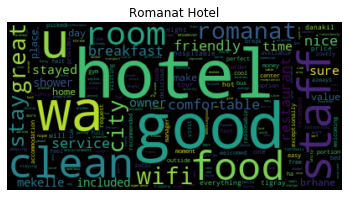

NAME: Blue Nile Resort Hotels


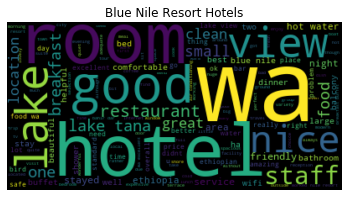

NAME: Sidra International Hotel


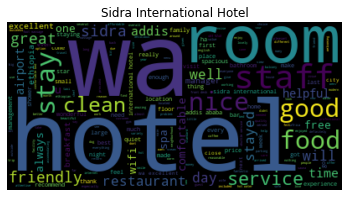

NAME: Tukul Village


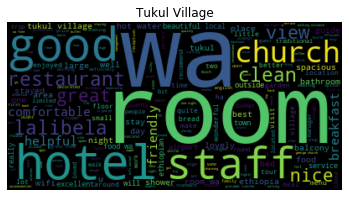

NAME: L-Shape Hotel


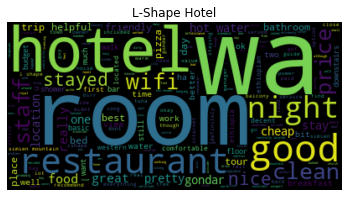

NAME: Tadesse Enjory Hotel


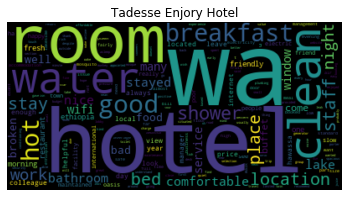

NAME: Rahnile Hotel


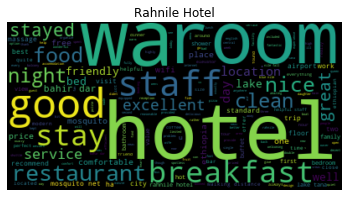

NAME: Taye Belay Hotel


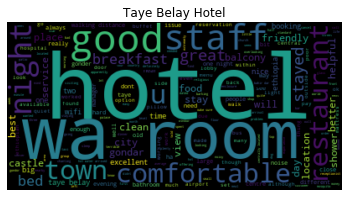

NAME: Sycamore Pension


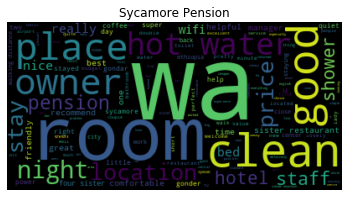

NAME: Dorze Lodge


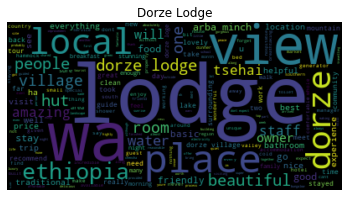

NAME: Lewi Hotels & Resorts


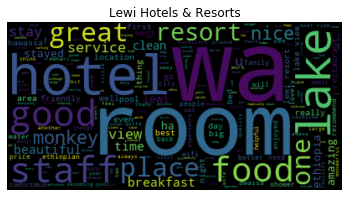

NAME: Lakemark Hotel


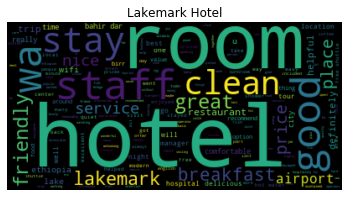

NAME: Azzeman Hotel


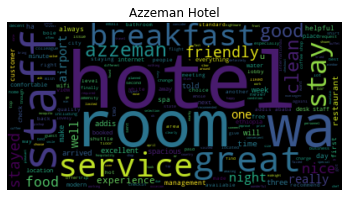

NAME: Sabean Hotel


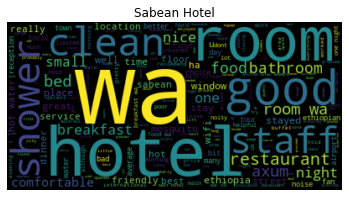

NAME: Global Hotel


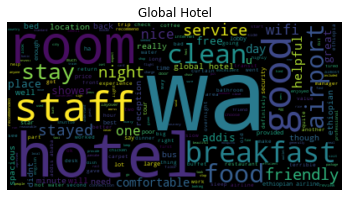

NAME: Emerald Resort


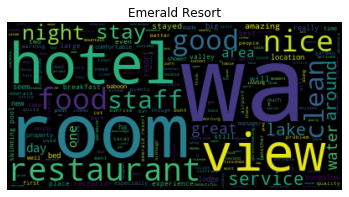

NAME: BenMas Hotel


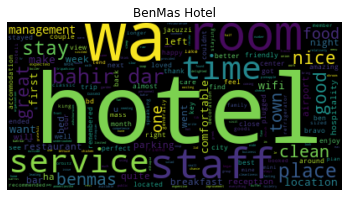

NAME: Atse Yohannes Hotel


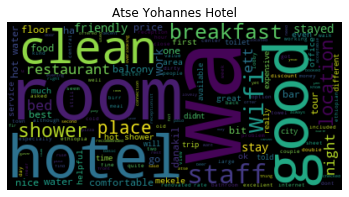

NAME: Unison Hotel and Spa


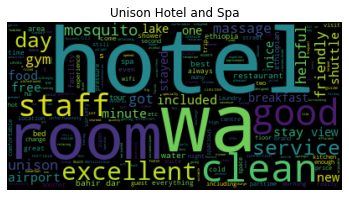

NAME: Homland Hotel


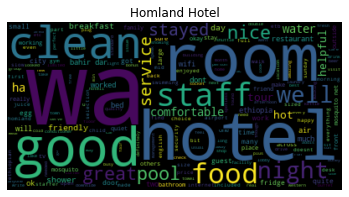

NAME: Armah Hotel


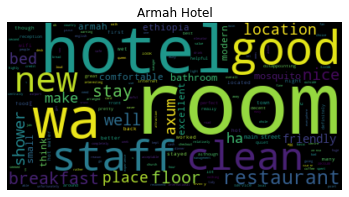

NAME: Afropolitan Hotel


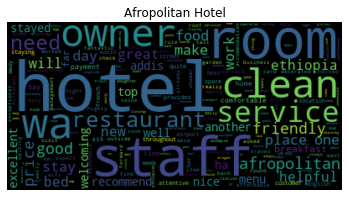

NAME: Desta International Hotel


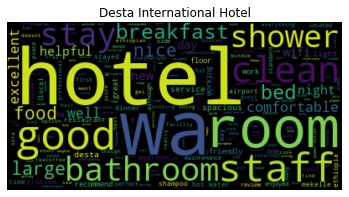

NAME: Ag Palace Hotel


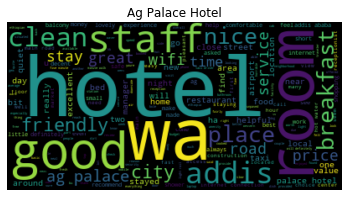

NAME: Getfam Hotel


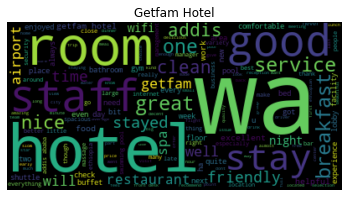

NAME: AG Hotel Gondar


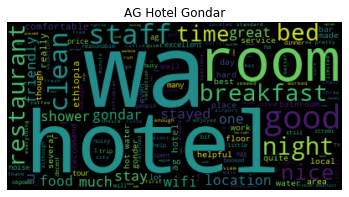

NAME: Planet Hotel


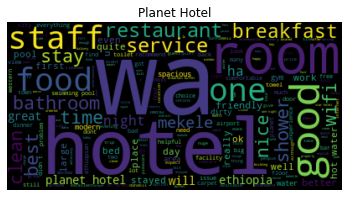

NAME: Mora Heights Hotel


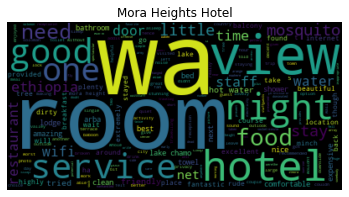

NAME: Liesak Resort Hotel


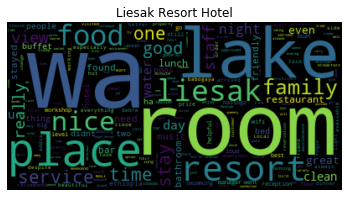

NAME: South Star International Hotel


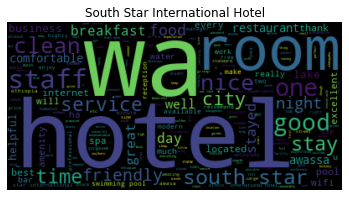

NAME: Jacaranda Hotel


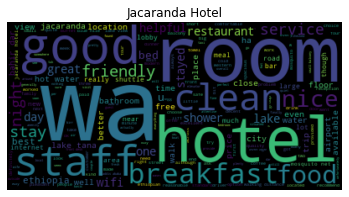

NAME: Wynn Hotel - Bahir Dar


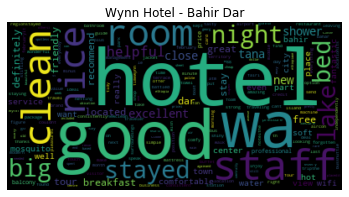

NAME: Florida International Hotel


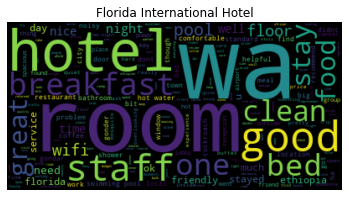

NAME: Zmama Hotel


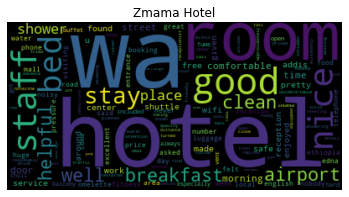

NAME: Noble Yehdga Hotel


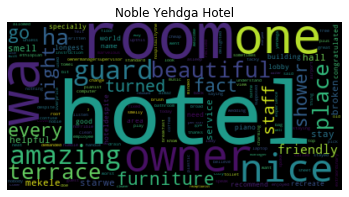

NAME: Arba Minch Tourist Hotel


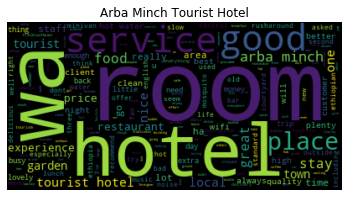

NAME: Haile Resort Gondar


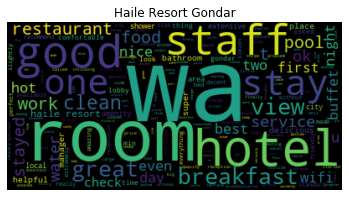

NAME: Ker Awud international Hotel


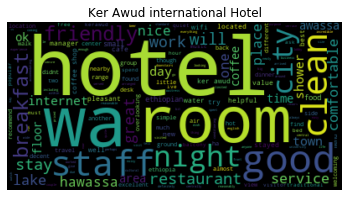

NAME: Mulu View Hotel


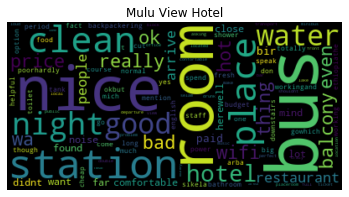

NAME: Moringa Hotel


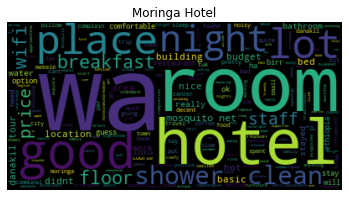

NAME: Godolias International Hotel


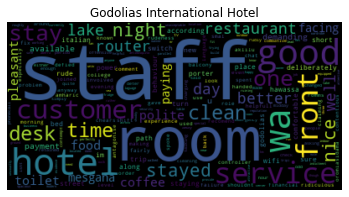

NAME: Tabor Hotel Lalibela


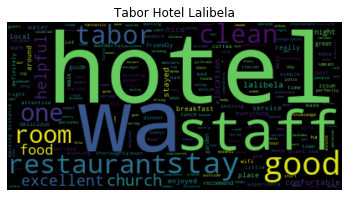

NAME: Holidays Hotel


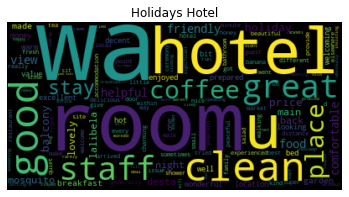

NAME: Bekele Mola Hotel


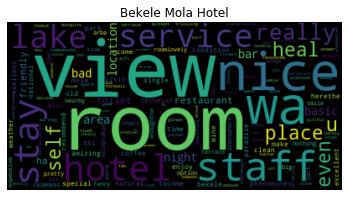

NAME: Afeworki Guest House


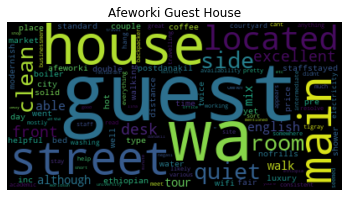

NAME: Jantekel Hotel


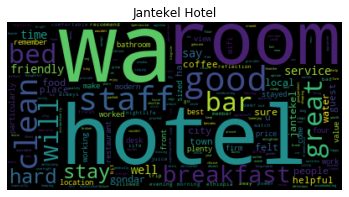

NAME: Axum Touring Hotel


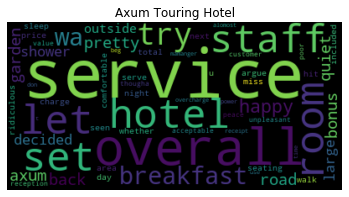

NAME: Oasis International Hotel


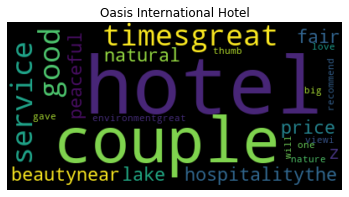

Total number of places: 71
place: Sheraton Addis, a Luxury Collection Hotel, Addis Ababa


<Figure size 7200x3600 with 0 Axes>

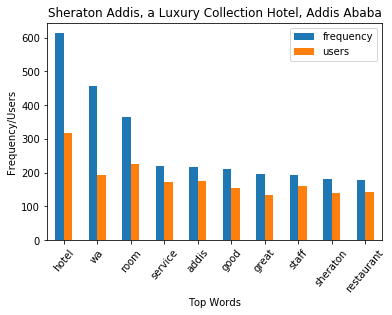

place: Axum Hotel


<Figure size 7200x3600 with 0 Axes>

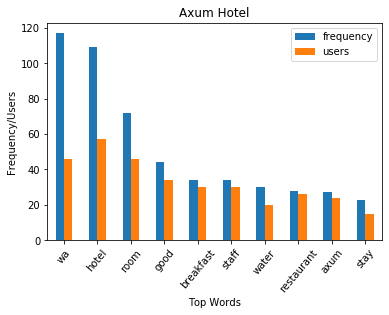

place: Mountain View Hotel


<Figure size 7200x3600 with 0 Axes>

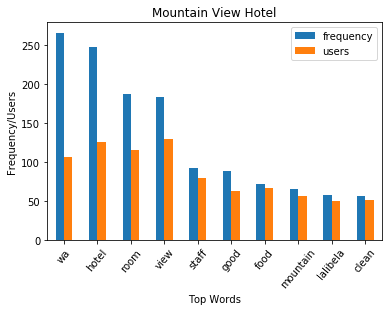

place: Caravan Hotel


<Figure size 7200x3600 with 0 Axes>

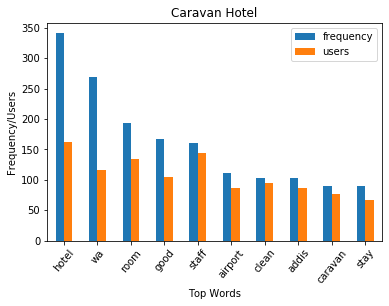

place: Nazra Hotel


<Figure size 7200x3600 with 0 Axes>

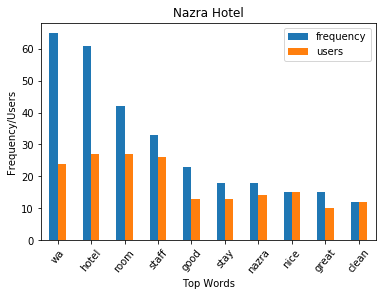

place: Addis Regency Hotel


<Figure size 7200x3600 with 0 Axes>

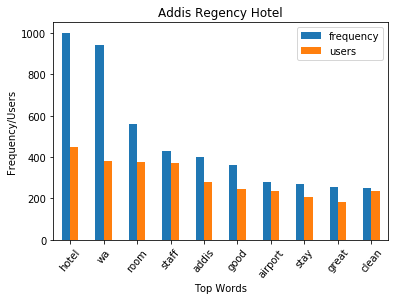

place: Radisson Blu Hotel, Addis Ababa


<Figure size 7200x3600 with 0 Axes>

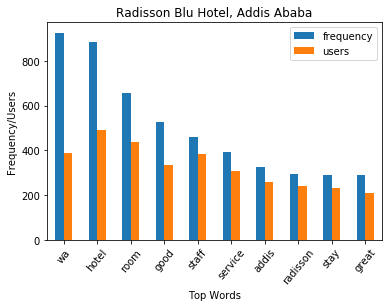

place: Maribela Hotel


<Figure size 7200x3600 with 0 Axes>

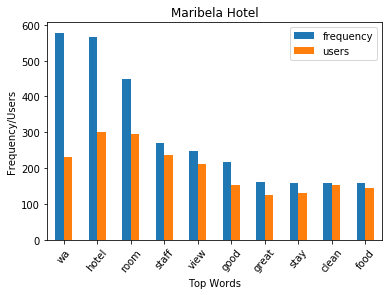

place: Kuriftu Resort


<Figure size 7200x3600 with 0 Axes>

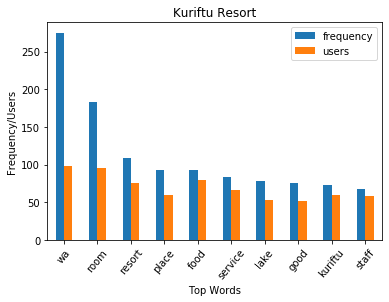

place: Addissinia Hotel


<Figure size 7200x3600 with 0 Axes>

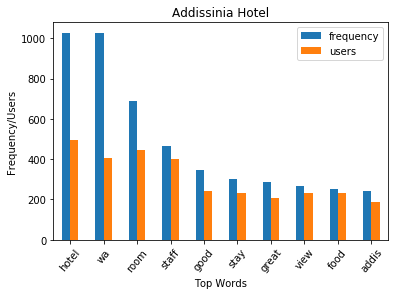

place: Capital Hotel and Spa


<Figure size 7200x3600 with 0 Axes>

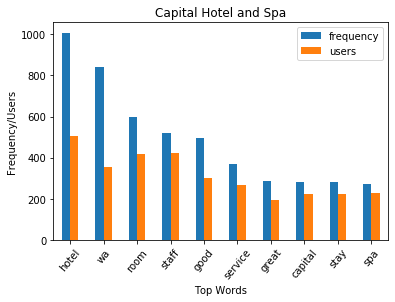

place: Harbe Hotel


<Figure size 7200x3600 with 0 Axes>

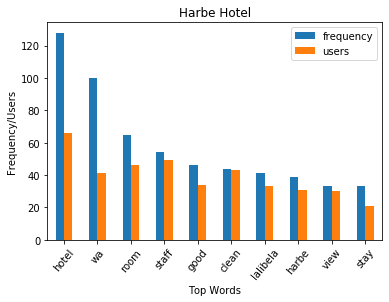

place: Lal Hotel & Spa Lalibela


<Figure size 7200x3600 with 0 Axes>

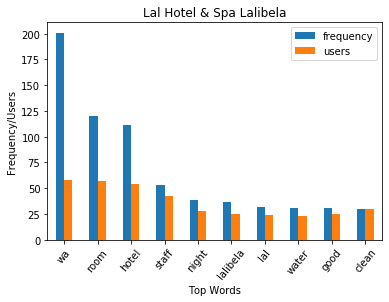

place: Haile Resort Hawassa


<Figure size 7200x3600 with 0 Axes>

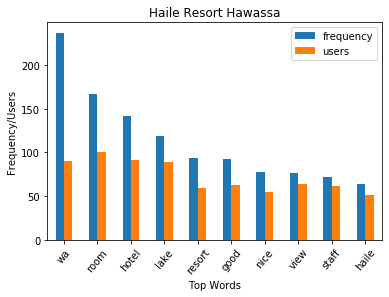

place: Golden Tulip Addis Ababa Hotel


<Figure size 7200x3600 with 0 Axes>

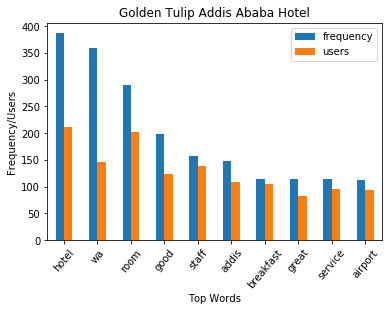

place: Hyatt Regency Addis Ababa


<Figure size 7200x3600 with 0 Axes>

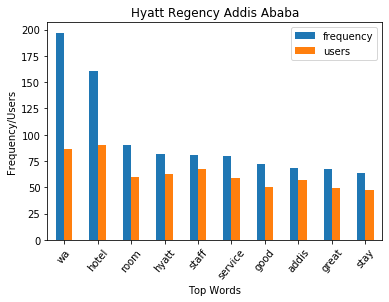

place: Panoramic View Hotel


<Figure size 7200x3600 with 0 Axes>

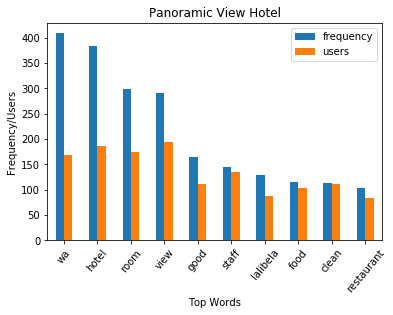

place: Haile Hotel, Shashemenne


<Figure size 7200x3600 with 0 Axes>

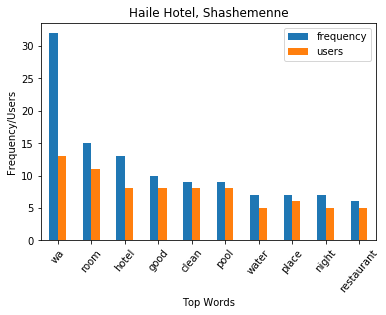

place: Jupiter International Hotel - Bole


<Figure size 7200x3600 with 0 Axes>

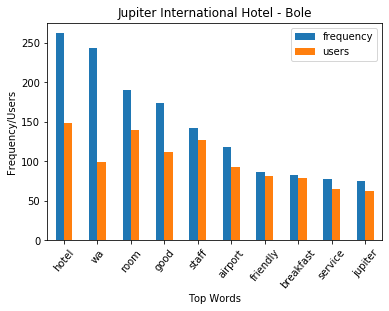

place: Goha Hotel


<Figure size 7200x3600 with 0 Axes>

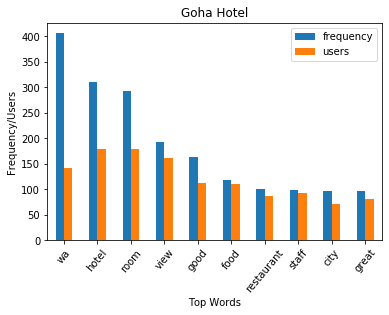

place: Paradise Lodge Arbaminch


<Figure size 7200x3600 with 0 Axes>

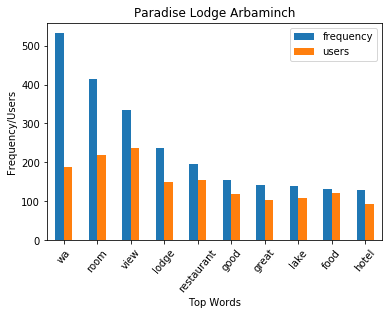

place: Kuriftu Resort & Spa Bahir Dar


<Figure size 7200x3600 with 0 Axes>

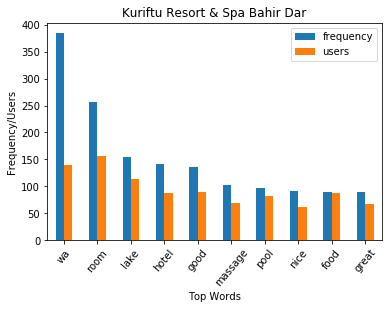

place: Delano Hotel & Spa


<Figure size 7200x3600 with 0 Axes>

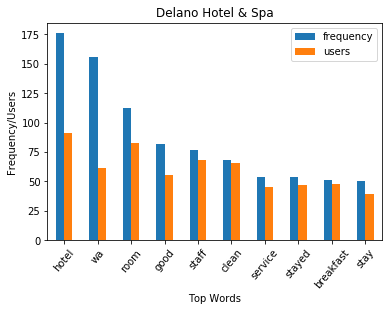

place: Romanat Hotel


<Figure size 7200x3600 with 0 Axes>

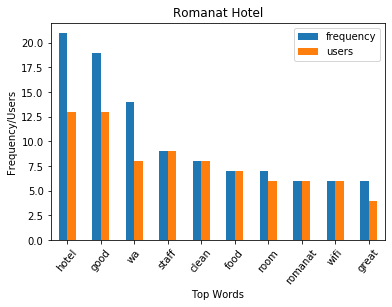

place: Blue Nile Resort Hotels


<Figure size 7200x3600 with 0 Axes>

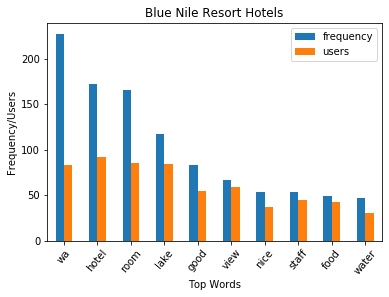

place: Sidra International Hotel


<Figure size 7200x3600 with 0 Axes>

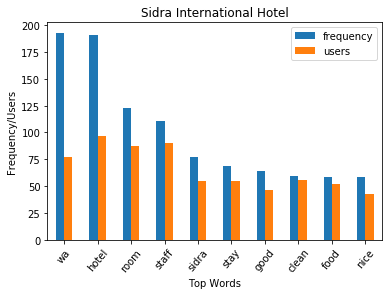

place: Tukul Village


<Figure size 7200x3600 with 0 Axes>

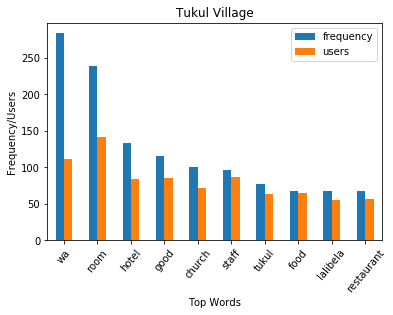

place: L-Shape Hotel


<Figure size 7200x3600 with 0 Axes>

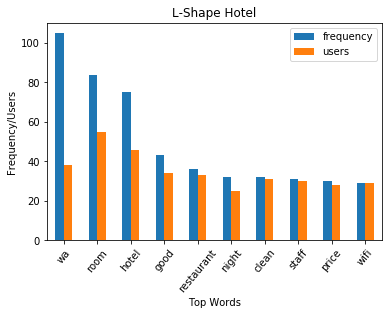

place: Tadesse Enjory Hotel


<Figure size 7200x3600 with 0 Axes>

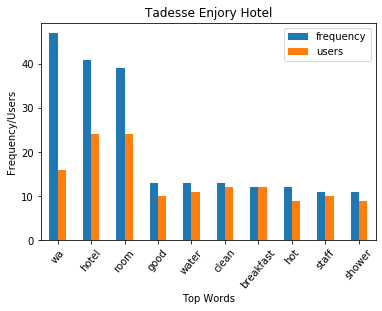

place: Rahnile Hotel


<Figure size 7200x3600 with 0 Axes>

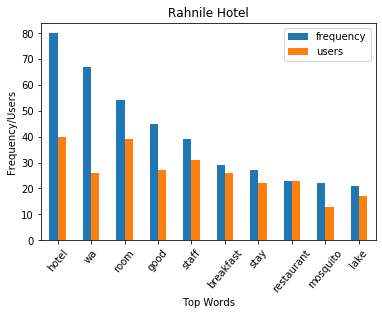

place: Taye Belay Hotel


<Figure size 7200x3600 with 0 Axes>

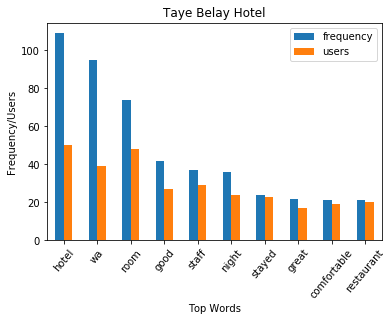

place: Sycamore Pension


<Figure size 7200x3600 with 0 Axes>

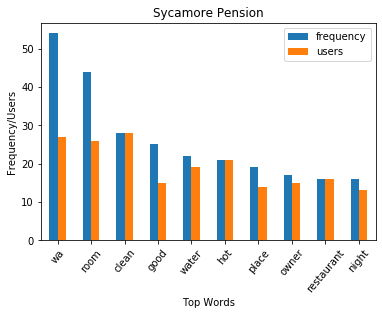

place: Dorze Lodge


<Figure size 7200x3600 with 0 Axes>

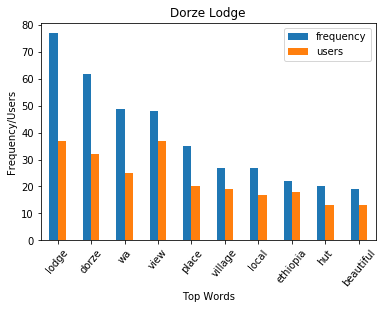

place: Lewi Hotels & Resorts


<Figure size 7200x3600 with 0 Axes>

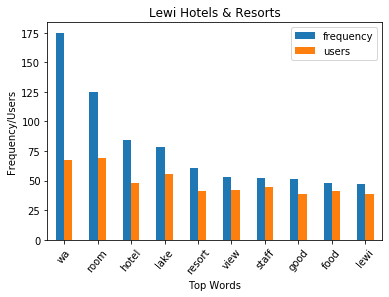

place: Lakemark Hotel


<Figure size 7200x3600 with 0 Axes>

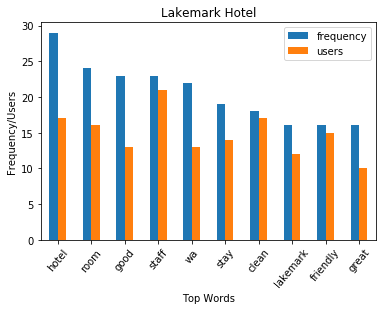

place: Azzeman Hotel


<Figure size 7200x3600 with 0 Axes>

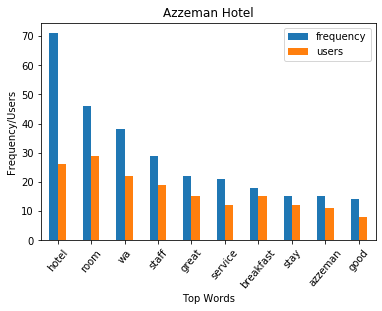

place: Sabean Hotel


<Figure size 7200x3600 with 0 Axes>

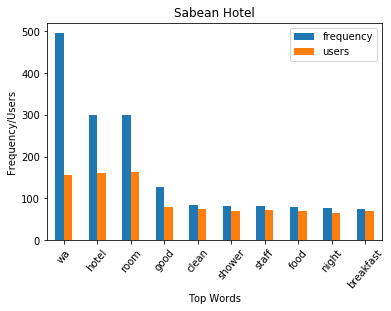

place: Global Hotel


<Figure size 7200x3600 with 0 Axes>

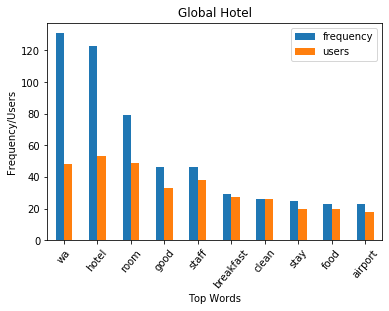

place: Emerald Resort


<Figure size 7200x3600 with 0 Axes>

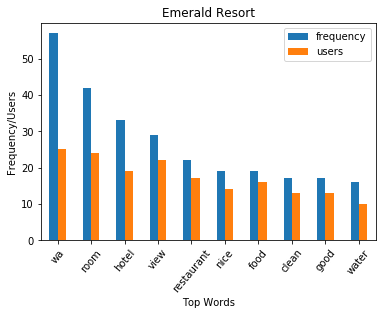

place: BenMas Hotel


<Figure size 7200x3600 with 0 Axes>

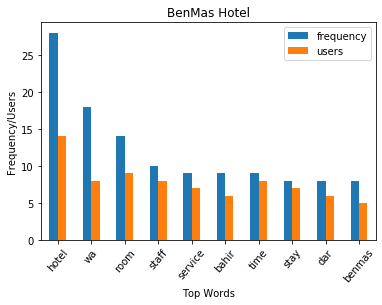

place: Atse Yohannes Hotel


<Figure size 7200x3600 with 0 Axes>

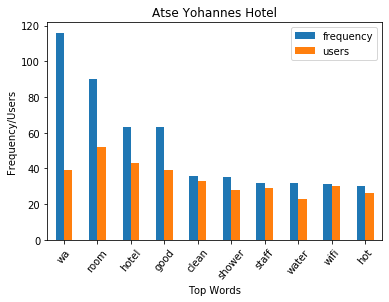

place: Unison Hotel and Spa


<Figure size 7200x3600 with 0 Axes>

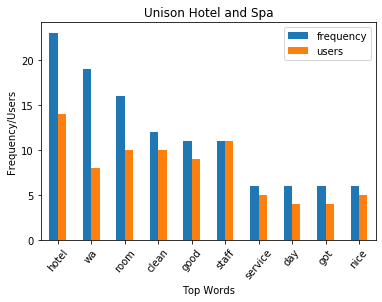

place: Homland Hotel


<Figure size 7200x3600 with 0 Axes>

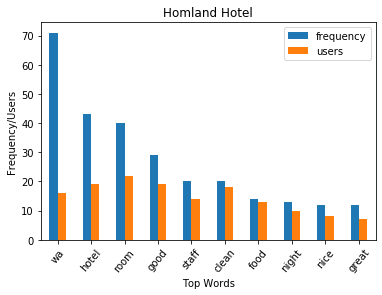

place: Armah Hotel


<Figure size 7200x3600 with 0 Axes>

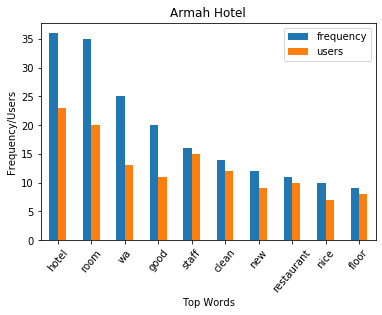

place: Afropolitan Hotel


<Figure size 7200x3600 with 0 Axes>

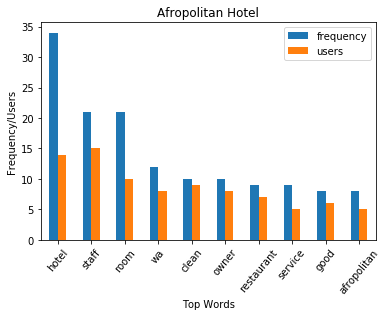

place: Desta International Hotel


<Figure size 7200x3600 with 0 Axes>

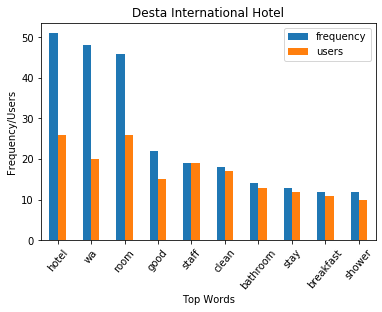

place: Ag Palace Hotel


<Figure size 7200x3600 with 0 Axes>

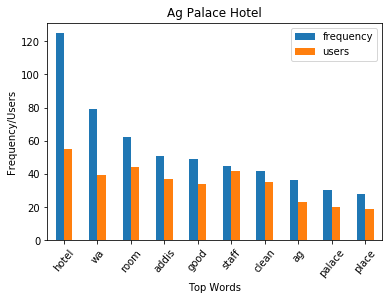

place: Getfam Hotel


<Figure size 7200x3600 with 0 Axes>

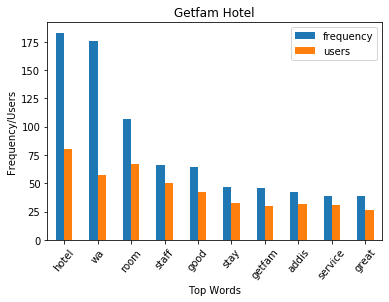

place: AG Hotel Gondar


<Figure size 7200x3600 with 0 Axes>

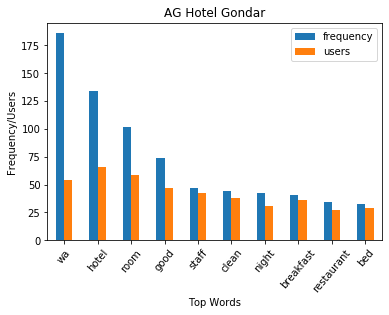

place: Planet Hotel


<Figure size 7200x3600 with 0 Axes>

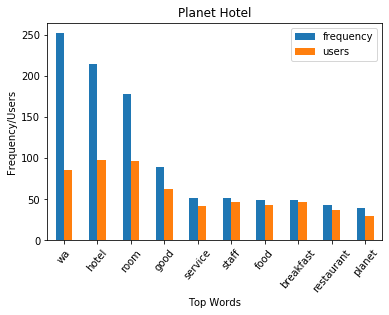

place: Mora Heights Hotel


<Figure size 7200x3600 with 0 Axes>

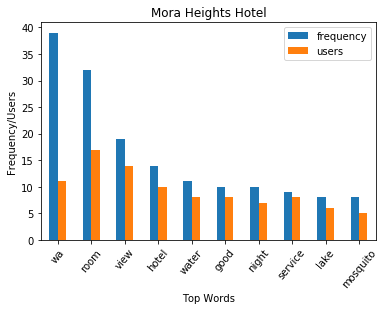

place: Liesak Resort Hotel


<Figure size 7200x3600 with 0 Axes>

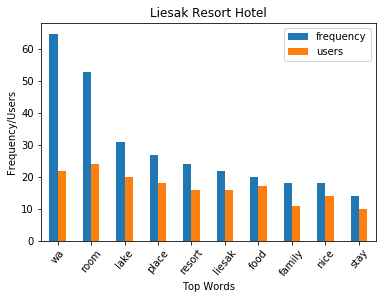

place: South Star International Hotel


<Figure size 7200x3600 with 0 Axes>

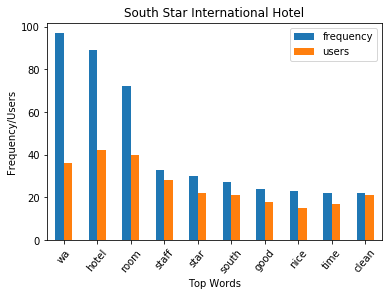

place: Jacaranda Hotel


<Figure size 7200x3600 with 0 Axes>

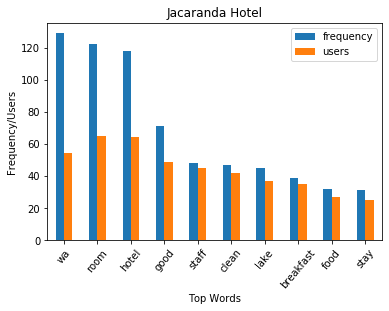

place: Wynn Hotel - Bahir Dar


<Figure size 7200x3600 with 0 Axes>

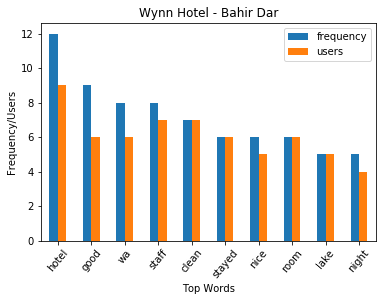

place: Florida International Hotel


<Figure size 7200x3600 with 0 Axes>

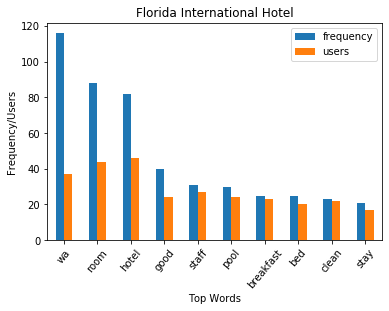

place: Zmama Hotel


<Figure size 7200x3600 with 0 Axes>

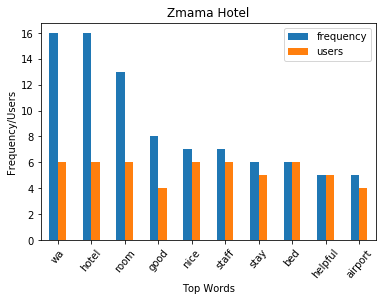

place: Noble Yehdga Hotel


<Figure size 7200x3600 with 0 Axes>

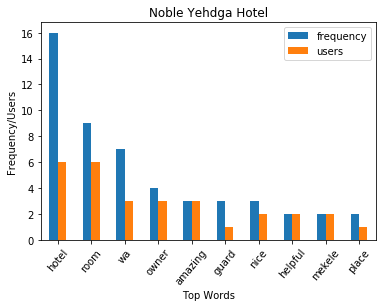

place: Arba Minch Tourist Hotel


<Figure size 7200x3600 with 0 Axes>

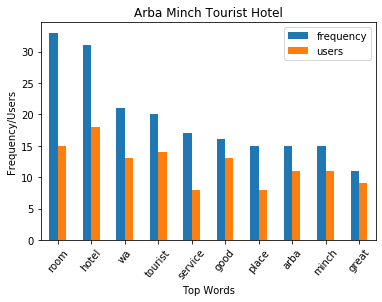

place: Haile Resort Gondar


<Figure size 7200x3600 with 0 Axes>

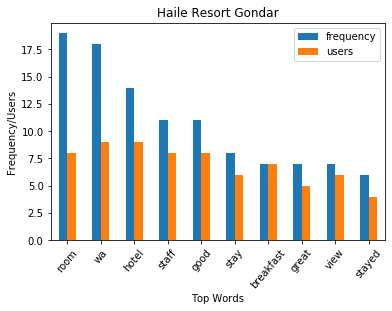

place: Ker Awud international Hotel


<Figure size 7200x3600 with 0 Axes>

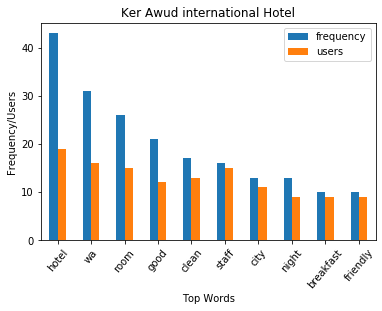

place: Mulu View Hotel


<Figure size 7200x3600 with 0 Axes>

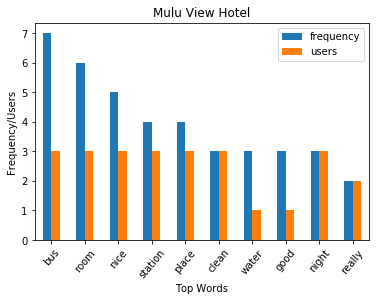

place: Moringa Hotel


<Figure size 7200x3600 with 0 Axes>

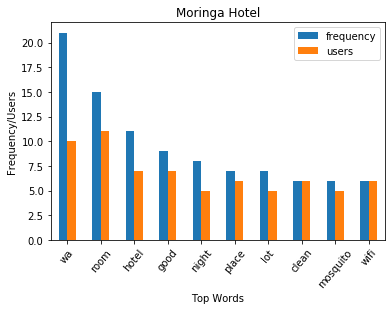

place: Godolias International Hotel


<Figure size 7200x3600 with 0 Axes>

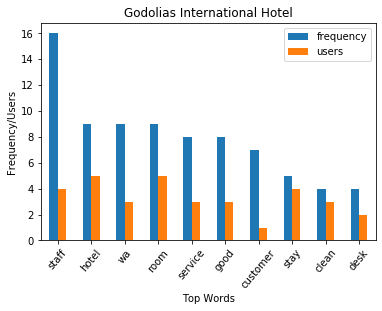

place: Tabor Hotel Lalibela


<Figure size 7200x3600 with 0 Axes>

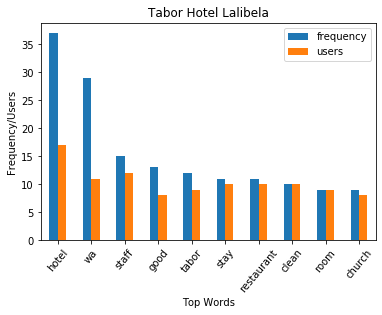

place: Holidays Hotel


<Figure size 7200x3600 with 0 Axes>

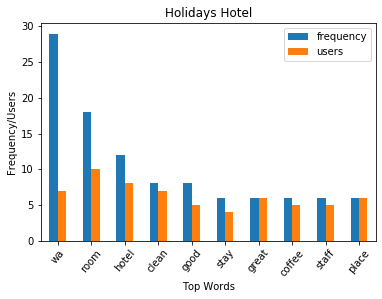

place: Bekele Mola Hotel


<Figure size 7200x3600 with 0 Axes>

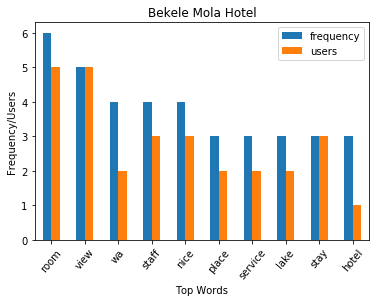

place: Afeworki Guest House


<Figure size 7200x3600 with 0 Axes>

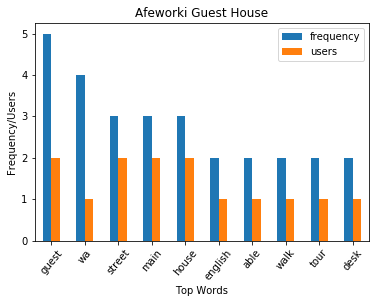

place: Jantekel Hotel


<Figure size 7200x3600 with 0 Axes>

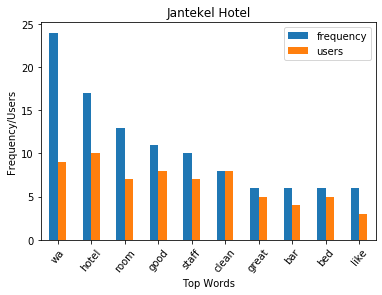

place: Axum Touring Hotel


<Figure size 7200x3600 with 0 Axes>

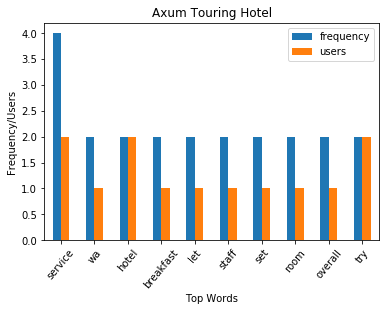

place: Oasis International Hotel


<Figure size 7200x3600 with 0 Axes>

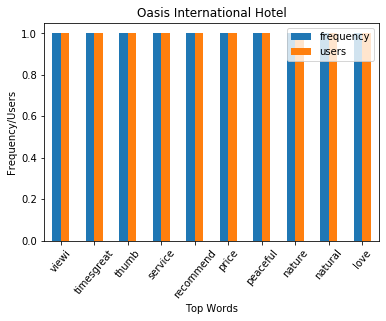

In [21]:
word_cloud_per_place(hoteldata)
get_top_words_by_place(cv, hoteldata)

Total number of places: 67
NAME: Rock-Hewn Churches of Lalibela


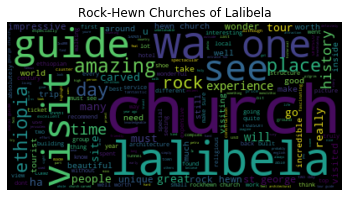

NAME: Debre Berhan Selassie Church


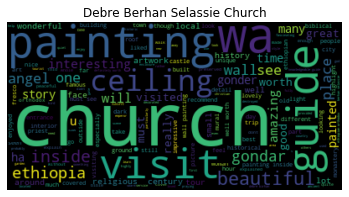

NAME: Stunning Ethiopia Tours


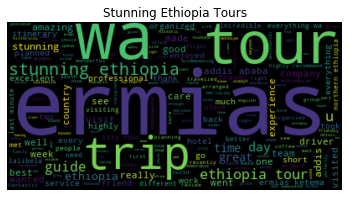

NAME: Yama Ethiopia Tours


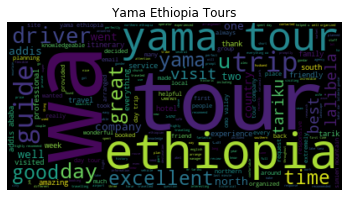

NAME: Lalibela Local Tour


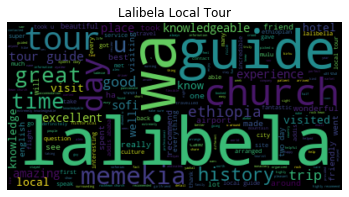

NAME: Simien Mountains National Park


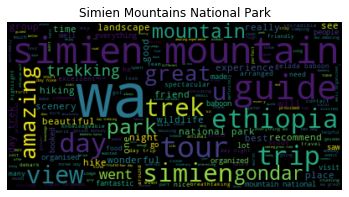

NAME: Fasiladas Bath Timket


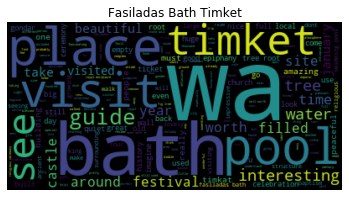

NAME: Liyu Ethiopia Tours


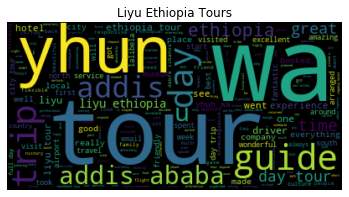

NAME: Hike Lalibela Tours


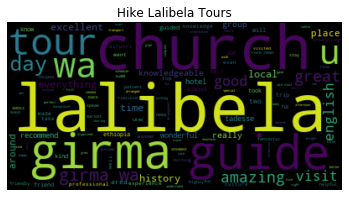

NAME: Alpha Ethiopia Tours


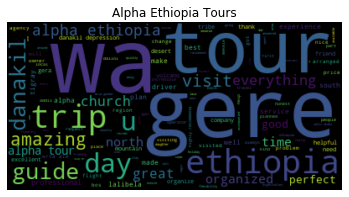

NAME: Aman Ethiopia Tours & Travel


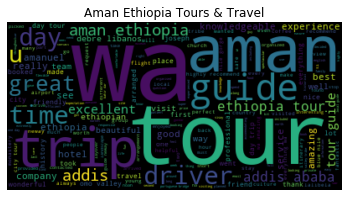

NAME: Abiy Ethiopia Tours


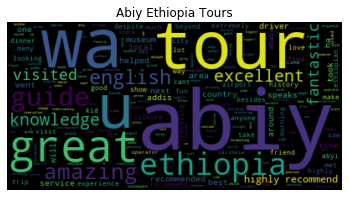

NAME: Gelila Ethiopia Tours


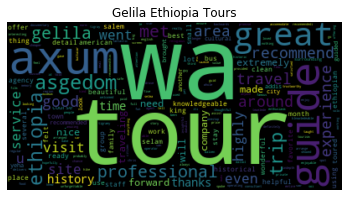

NAME: The Ruins of Aksum


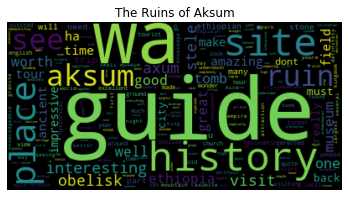

NAME: Lalibela Eco Trekking Tours


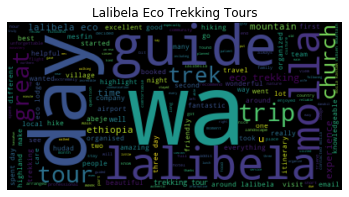

NAME: Explore Omo Valley


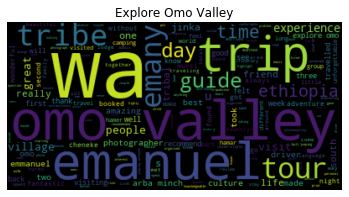

NAME: Church of Our Lady Mary of Zion


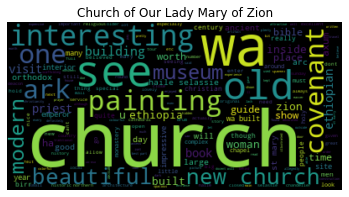

NAME: BD Backpacker Tours


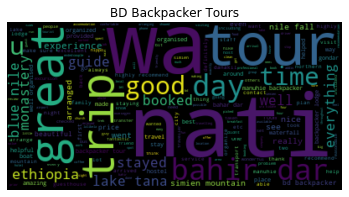

NAME: Lake Tana


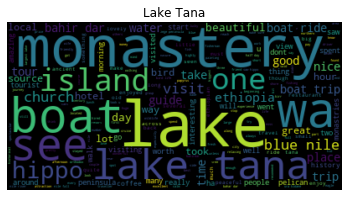

NAME: WALK IN ETHIOPIA TOUR AND TRAVEL


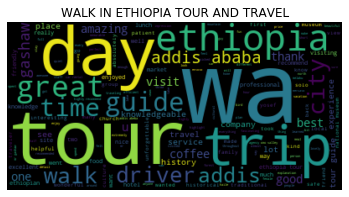

NAME: Run Africa


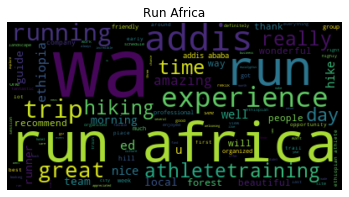

NAME: Fasil Ghebbi


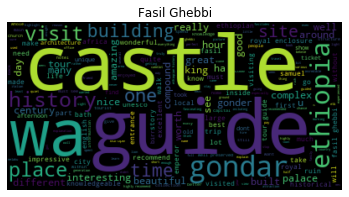

NAME: Go Addis Tours


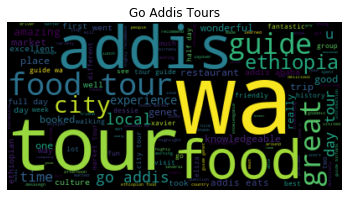

NAME: Northern Stelae Field


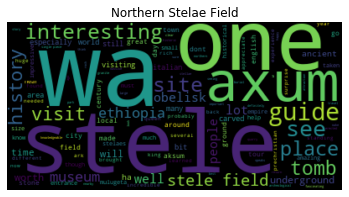

NAME: Church of St. George


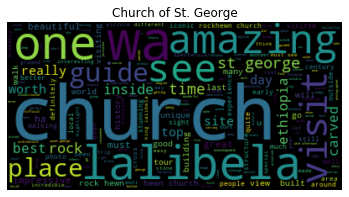

NAME: Imagine Ethiopia Tours - Day Tours


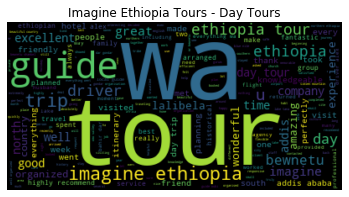

NAME: myGuzo


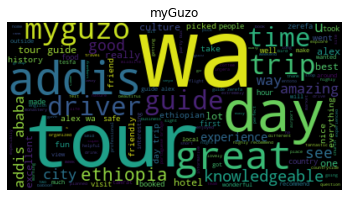

NAME: Addis Ethiopia Tours


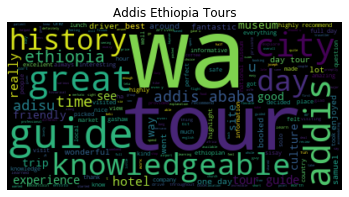

NAME: Trek Ethiopia Travel and Tours


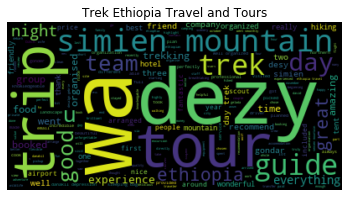

NAME: Nechisar National Park


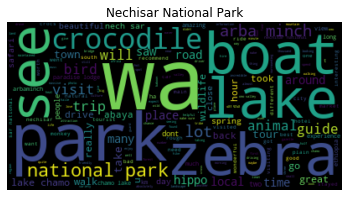

NAME: Simien View Tour & Travel


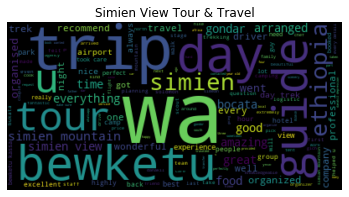

NAME: Chamo Lake


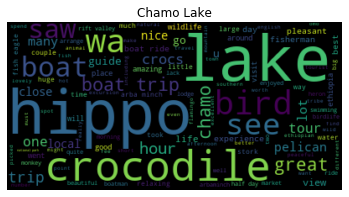

NAME: Simien Mountains Outstanding Nature Tours


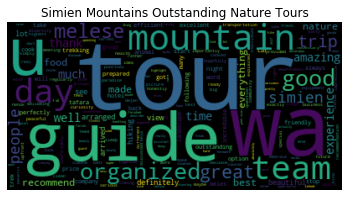

NAME: Monastery of Debre Mariam


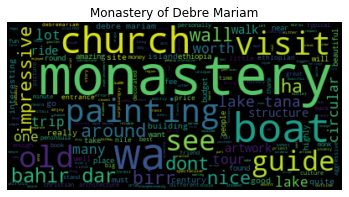

NAME: Hippo watching on Lake Awassa


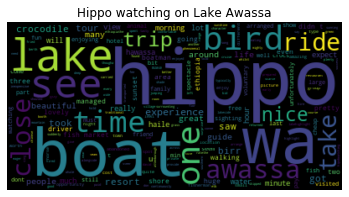

NAME: Yemrehana Krestos Church


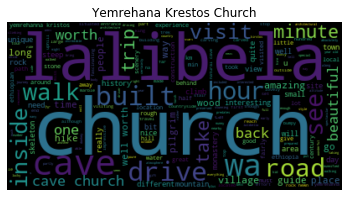

NAME: Gamo Travel Tours


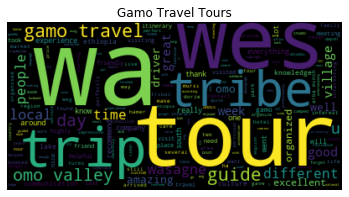

NAME: Hike in Ethiopia


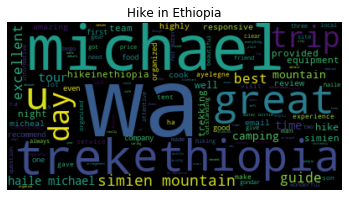

NAME: ARRE TOURS AND CAR RENT


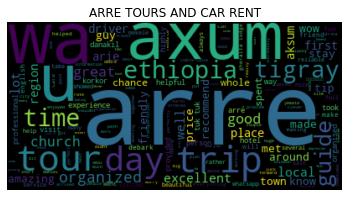

NAME: Gheralta Rock


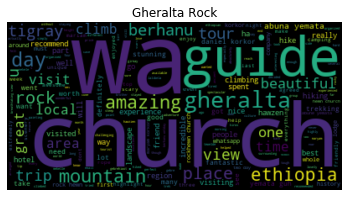

NAME: Haile Ethiopia Tours


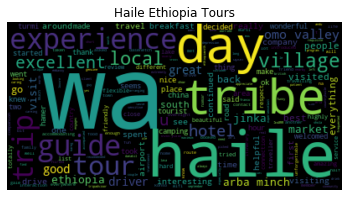

NAME: Dan Lalibela Tour Guide Services


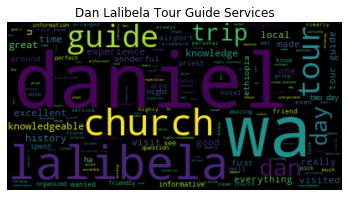

NAME: Lucy Ethiopia Tours


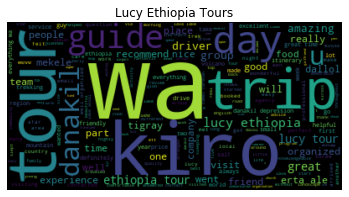

NAME: Abreham Tour and Travel


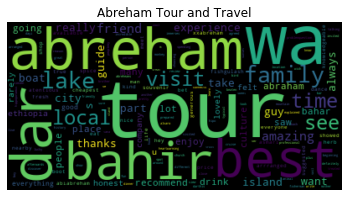

NAME: Fish Market at Awassa Lake


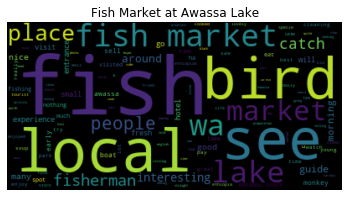

NAME: Mass Ethiopia Tours


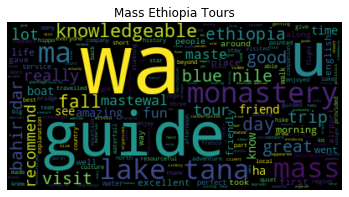

NAME: Ethiopian Photography Tours


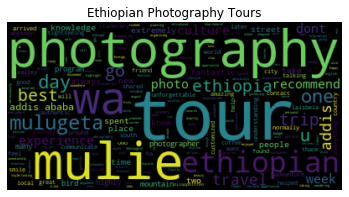

NAME: Azwa Mariam Monastery


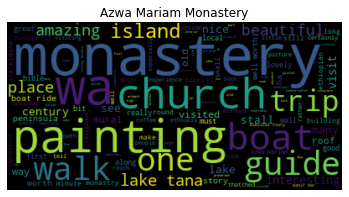

NAME: Origin of Ge'ez Tour and Travel


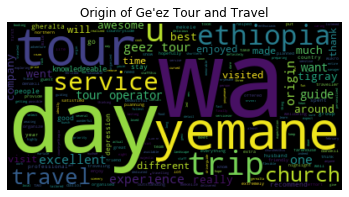

NAME: Simien Mountain Treks


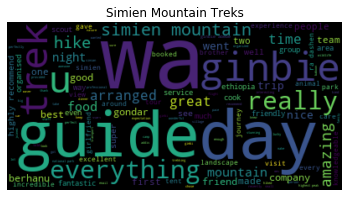

NAME: Bravo Ethiopia Tours & Car Rentals


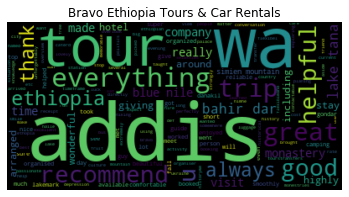

NAME: King Ezana's Inscription


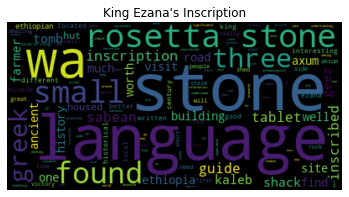

NAME: Dorze Village


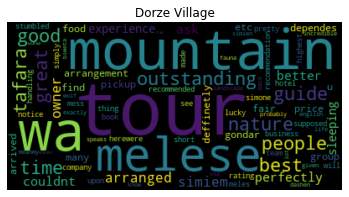

NAME: Kuriftu Water Park


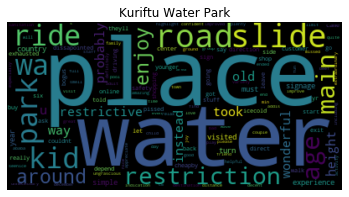

NAME: Danakil Tour and Travel


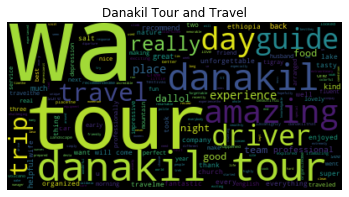

NAME: Rock Ethiopia Tours


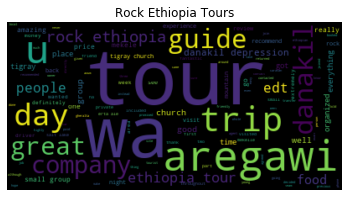

NAME: Yerer Mountain


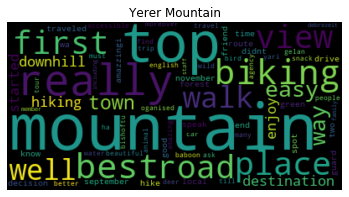

NAME: Sycamore Ethiopia Tours


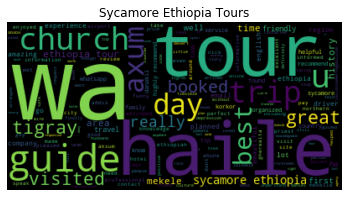

NAME: Extraordinary Ethiopia Tours


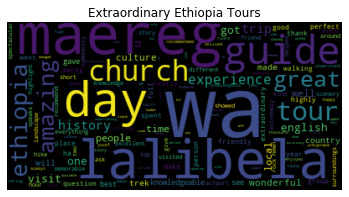

NAME: Enter Ethiopia Tour


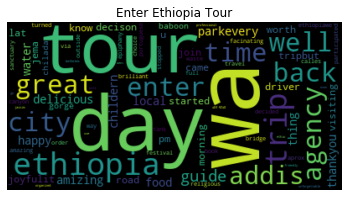

NAME: Tombs of Kings Kaleb and Gebre Meskal


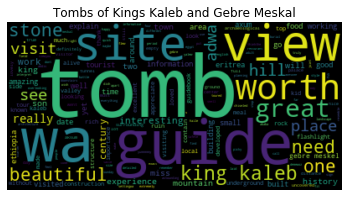

NAME: Abidjatta-Shalla National Park


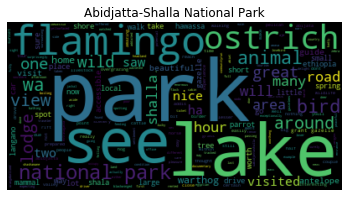

NAME: Banti Omo Valley Tours


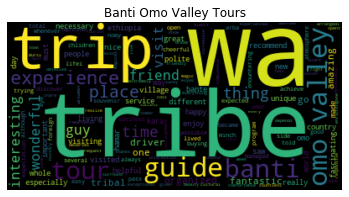

NAME: FKLM Tours


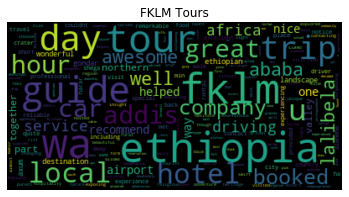

NAME: Yata Ethiopia tours and Travel


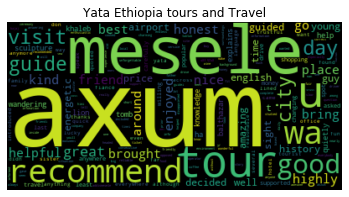

NAME: Top View Ethiopia Tour


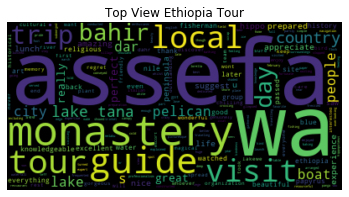

NAME: Nomadic Ethiopia Tours


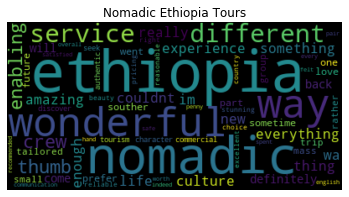

Total number of places: 67
place: Rock-Hewn Churches of Lalibela


<Figure size 7200x3600 with 0 Axes>

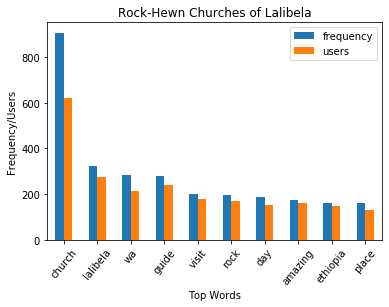

place: Debre Berhan Selassie Church


<Figure size 7200x3600 with 0 Axes>

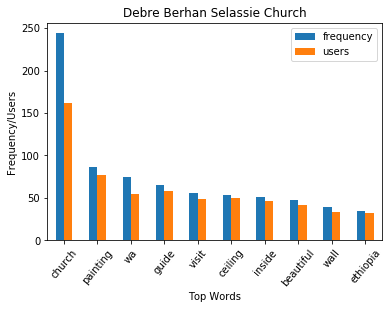

place: Stunning Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

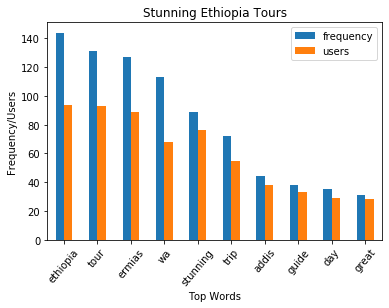

place: Yama Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

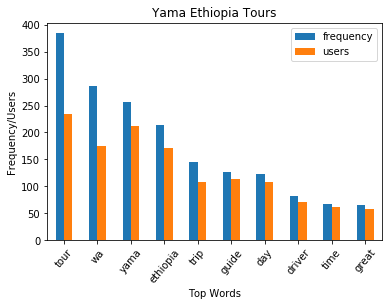

place: Lalibela Local Tour


<Figure size 7200x3600 with 0 Axes>

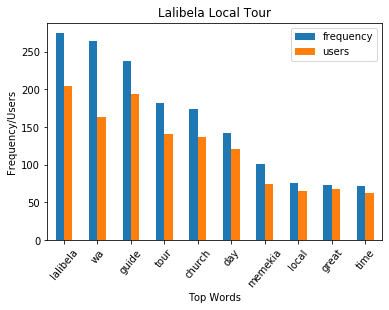

place: Simien Mountains National Park


<Figure size 7200x3600 with 0 Axes>

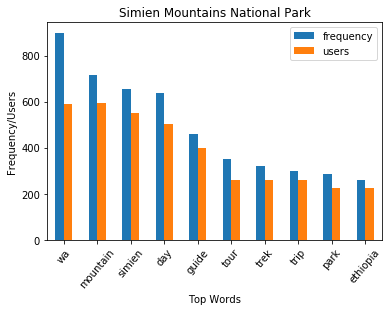

place: Fasiladas Bath Timket


<Figure size 7200x3600 with 0 Axes>

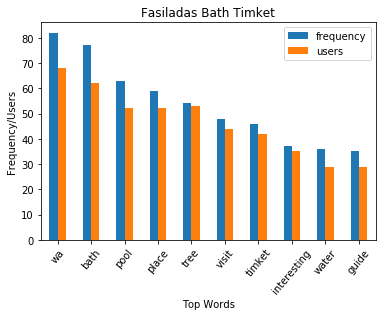

place: Liyu Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

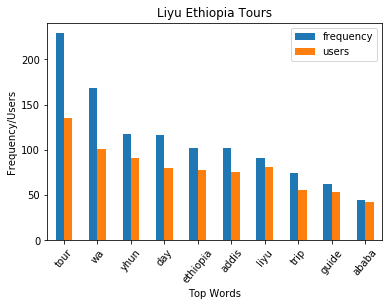

place: Hike Lalibela Tours


<Figure size 7200x3600 with 0 Axes>

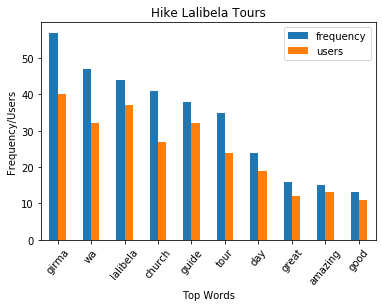

place: Alpha Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

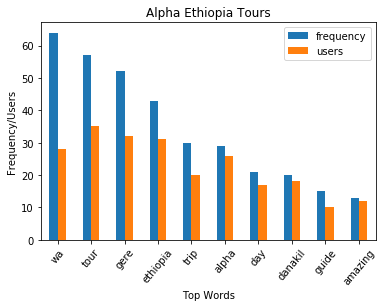

place: Aman Ethiopia Tours & Travel


<Figure size 7200x3600 with 0 Axes>

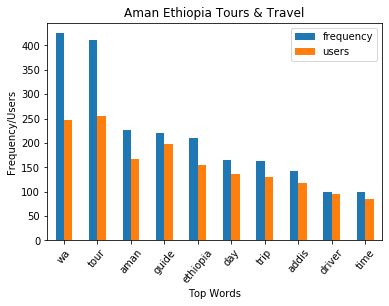

place: Abiy Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

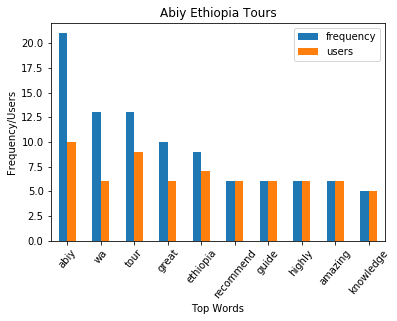

place: Gelila Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

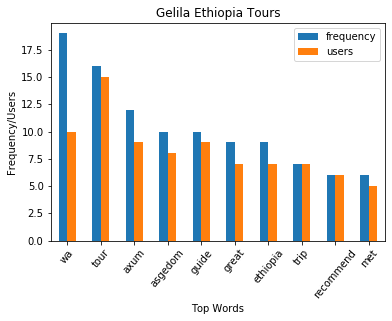

place: The Ruins of Aksum


<Figure size 7200x3600 with 0 Axes>

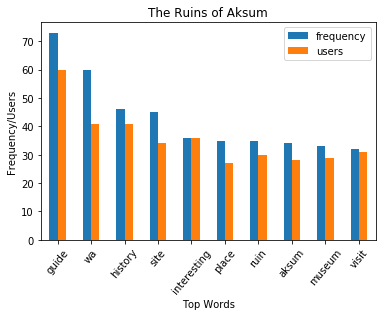

place: Lalibela Eco Trekking Tours


<Figure size 7200x3600 with 0 Axes>

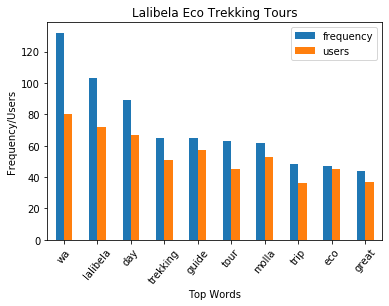

place: Explore Omo Valley


<Figure size 7200x3600 with 0 Axes>

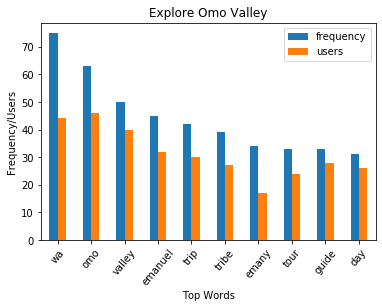

place: Church of Our Lady Mary of Zion


<Figure size 7200x3600 with 0 Axes>

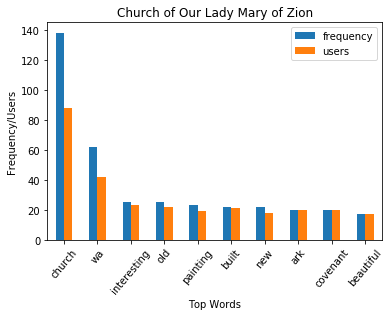

place: BD Backpacker Tours


<Figure size 7200x3600 with 0 Axes>

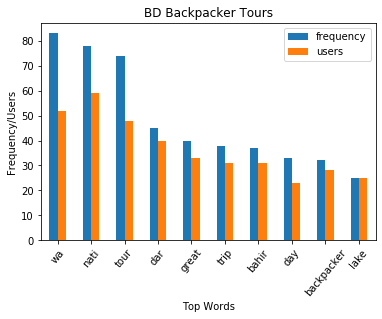

place: Lake Tana


<Figure size 7200x3600 with 0 Axes>

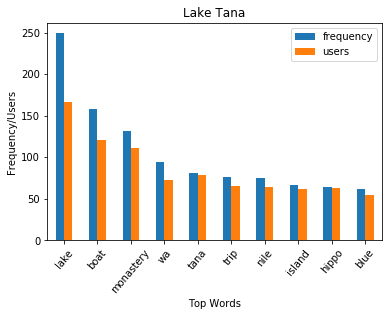

place: WALK IN ETHIOPIA TOUR AND TRAVEL


<Figure size 7200x3600 with 0 Axes>

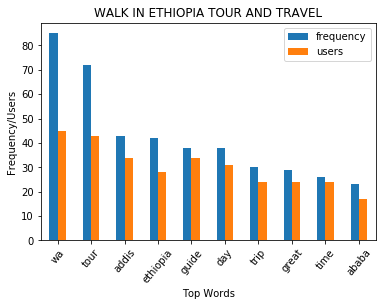

place: Run Africa


<Figure size 7200x3600 with 0 Axes>

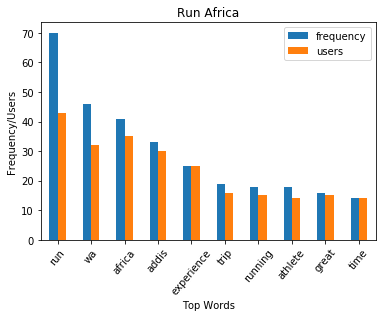

place: Fasil Ghebbi


<Figure size 7200x3600 with 0 Axes>

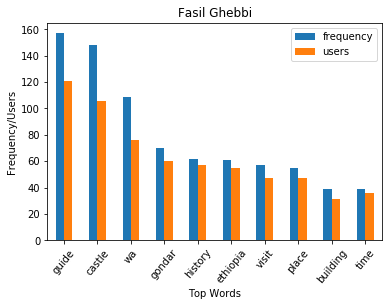

place: Go Addis Tours


<Figure size 7200x3600 with 0 Axes>

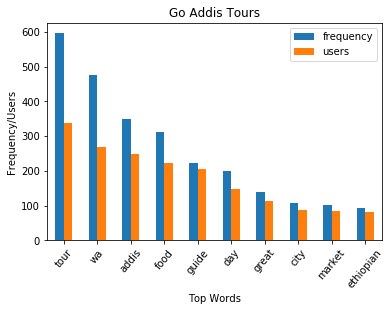

place: Northern Stelae Field


<Figure size 7200x3600 with 0 Axes>

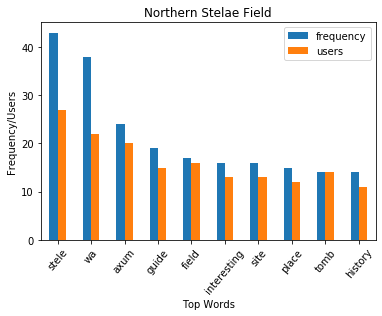

place: Church of St. George


<Figure size 7200x3600 with 0 Axes>

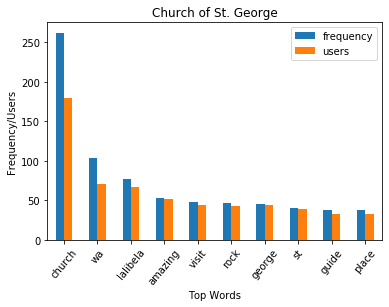

place: Imagine Ethiopia Tours - Day Tours


<Figure size 7200x3600 with 0 Axes>

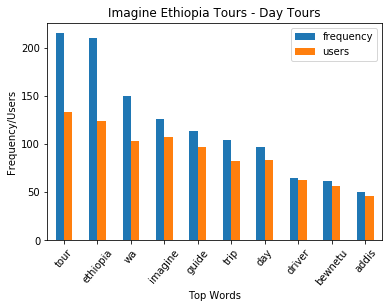

place: myGuzo


<Figure size 7200x3600 with 0 Axes>

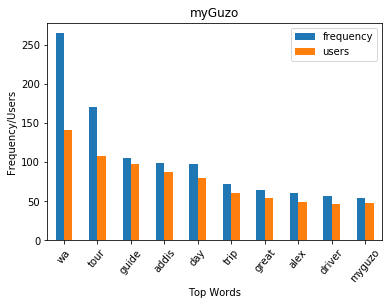

place: Addis Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

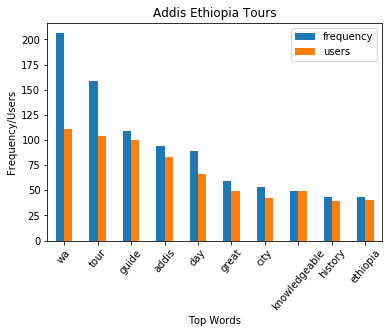

place: Trek Ethiopia Travel and Tours


<Figure size 7200x3600 with 0 Axes>

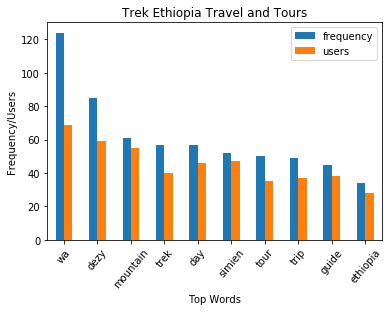

place: Nechisar National Park


<Figure size 7200x3600 with 0 Axes>

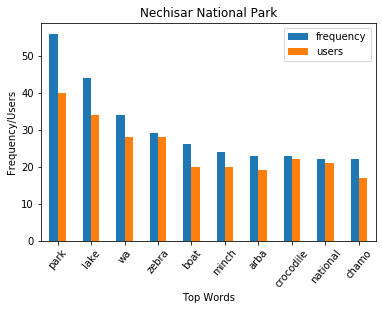

place: Simien View Tour & Travel


<Figure size 7200x3600 with 0 Axes>

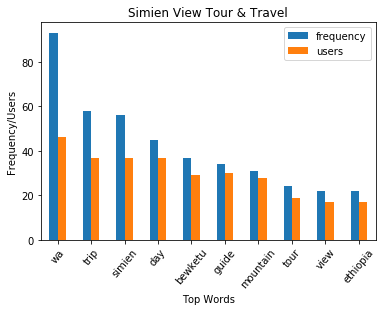

place: Chamo Lake


<Figure size 7200x3600 with 0 Axes>

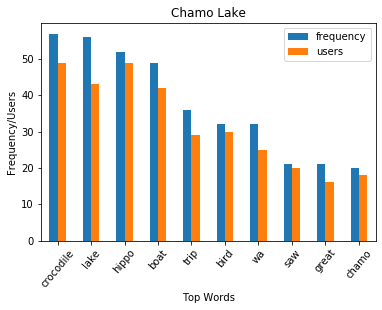

place: Simien Mountains Outstanding Nature Tours


<Figure size 7200x3600 with 0 Axes>

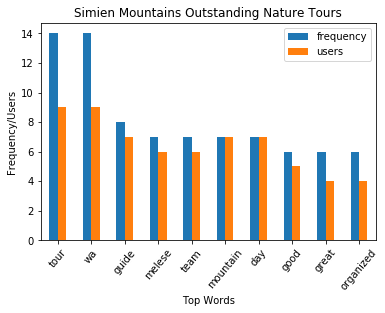

place: Monastery of Debre Mariam


<Figure size 7200x3600 with 0 Axes>

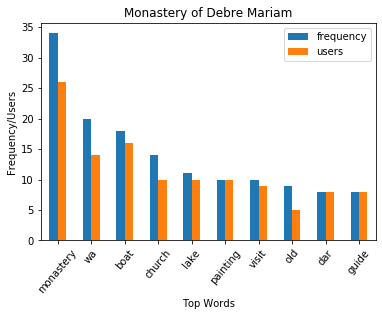

place: Hippo watching on Lake Awassa


<Figure size 7200x3600 with 0 Axes>

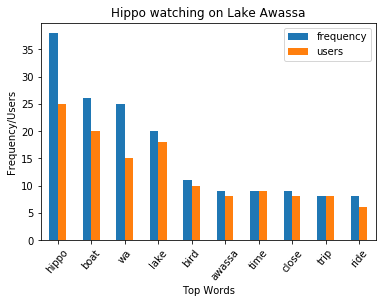

place: Yemrehana Krestos Church


<Figure size 7200x3600 with 0 Axes>

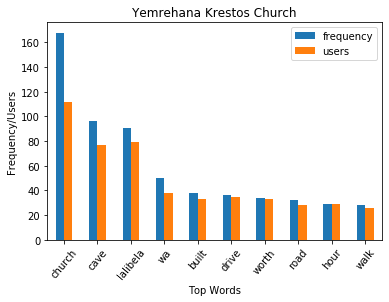

place: Gamo Travel Tours


<Figure size 7200x3600 with 0 Axes>

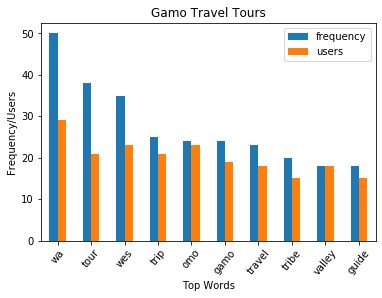

place: Hike in Ethiopia


<Figure size 7200x3600 with 0 Axes>

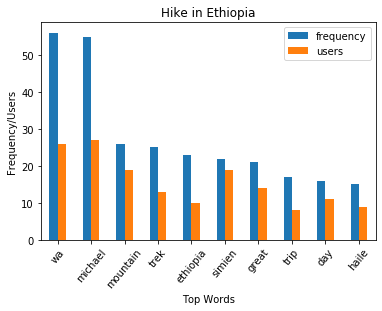

place: ARRE TOURS AND CAR RENT


<Figure size 7200x3600 with 0 Axes>

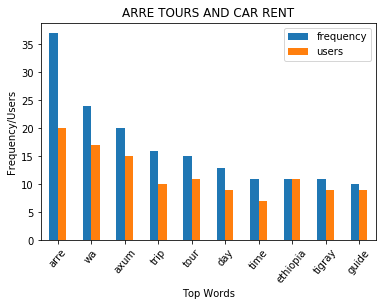

place: Gheralta Rock


<Figure size 7200x3600 with 0 Axes>

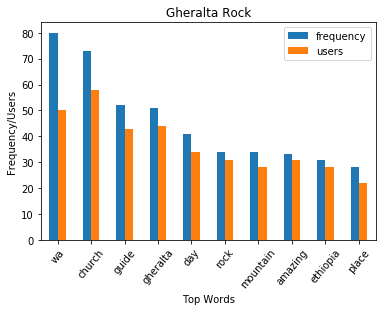

place: Haile Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

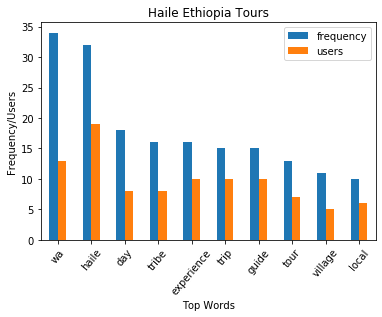

place: Dan Lalibela Tour Guide Services


<Figure size 7200x3600 with 0 Axes>

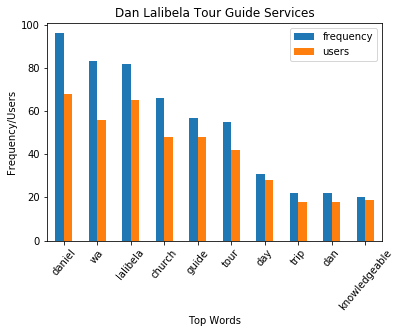

place: Lucy Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

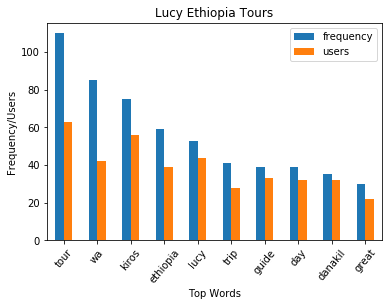

place: Abreham Tour and Travel


<Figure size 7200x3600 with 0 Axes>

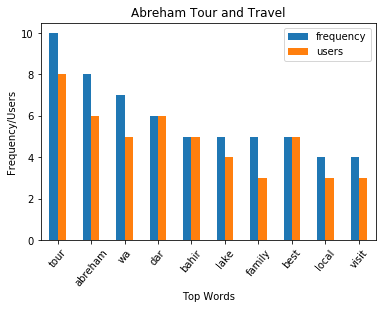

place: Fish Market at Awassa Lake


<Figure size 7200x3600 with 0 Axes>

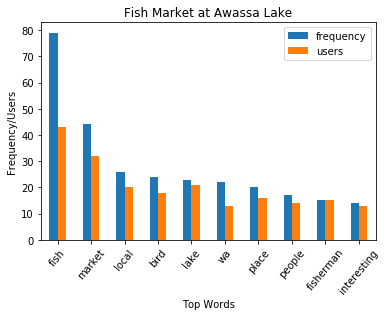

place: Mass Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

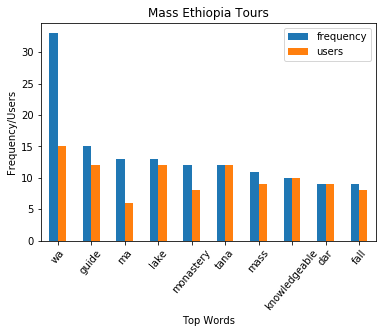

place: Ethiopian Photography Tours


<Figure size 7200x3600 with 0 Axes>

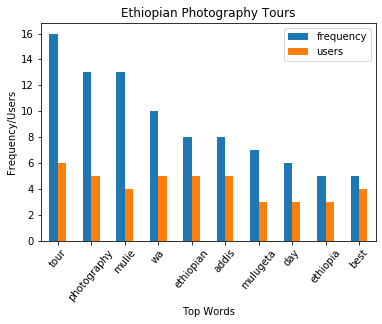

place: Azwa Mariam Monastery


<Figure size 7200x3600 with 0 Axes>

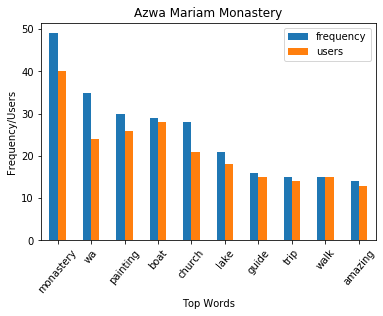

place: Origin of Ge'ez Tour and Travel


<Figure size 7200x3600 with 0 Axes>

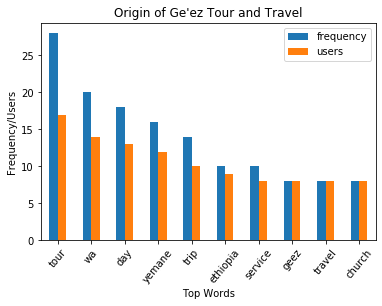

place: Simien Mountain Treks


<Figure size 7200x3600 with 0 Axes>

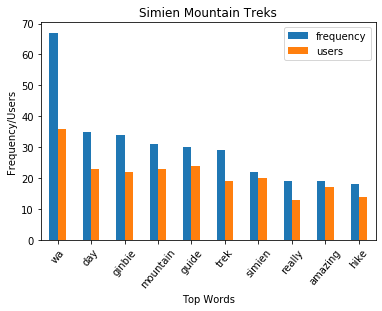

place: Bravo Ethiopia Tours & Car Rentals


<Figure size 7200x3600 with 0 Axes>

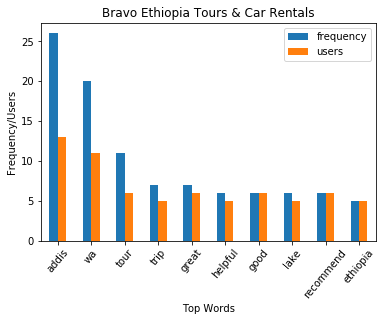

place: King Ezana's Inscription


<Figure size 7200x3600 with 0 Axes>

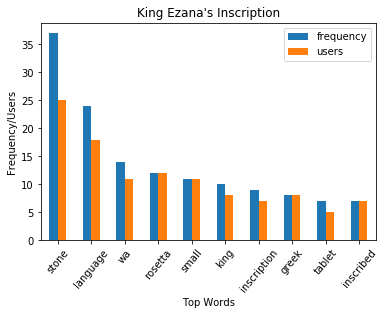

place: Dorze Village


<Figure size 7200x3600 with 0 Axes>

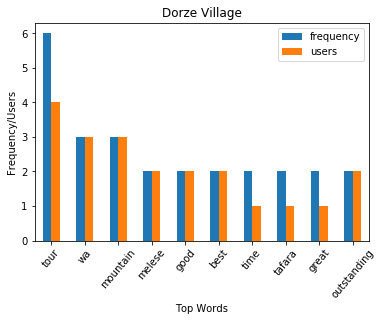

place: Kuriftu Water Park


<Figure size 7200x3600 with 0 Axes>

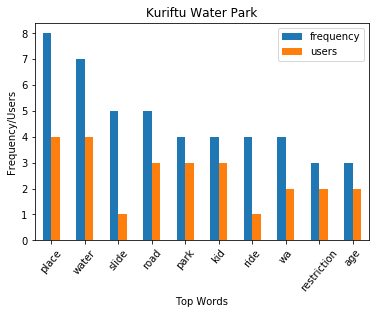

place: Danakil Tour and Travel


<Figure size 7200x3600 with 0 Axes>

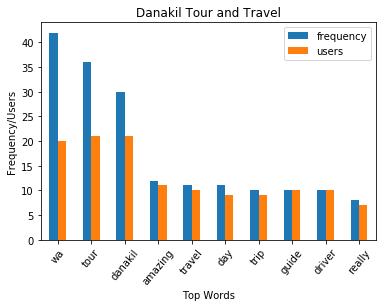

place: Rock Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

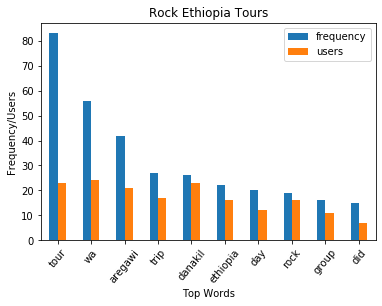

place: Yerer Mountain


<Figure size 7200x3600 with 0 Axes>

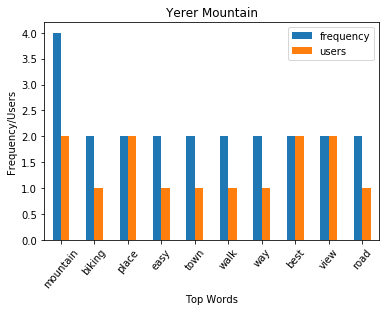

place: Sycamore Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

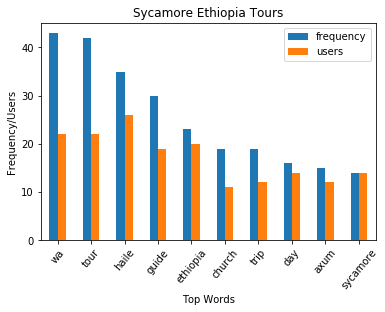

place: Extraordinary Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

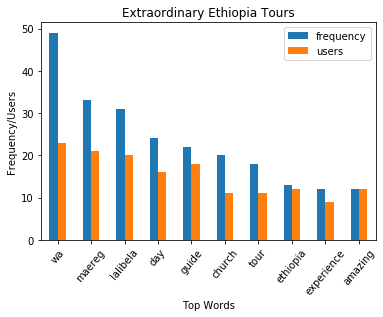

place: Enter Ethiopia Tour


<Figure size 7200x3600 with 0 Axes>

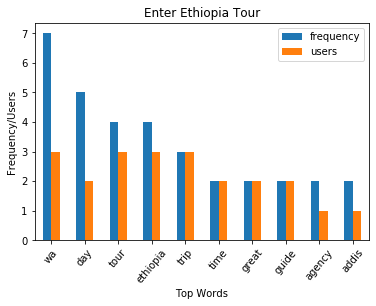

place: Tombs of Kings Kaleb and Gebre Meskal


<Figure size 7200x3600 with 0 Axes>

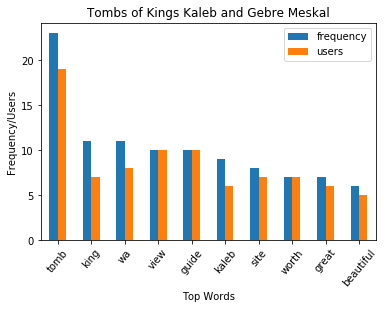

place: Abidjatta-Shalla National Park


<Figure size 7200x3600 with 0 Axes>

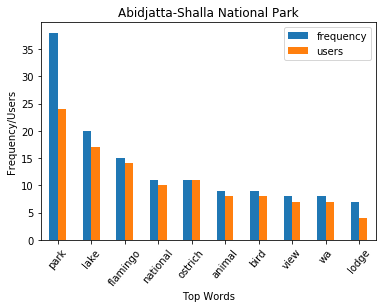

place: Banti Omo Valley Tours


<Figure size 7200x3600 with 0 Axes>

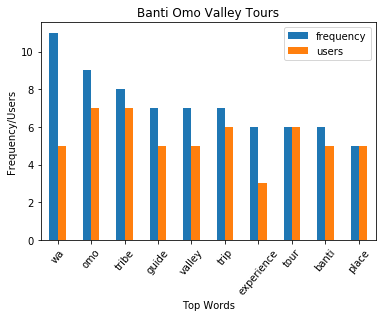

place: FKLM Tours


<Figure size 7200x3600 with 0 Axes>

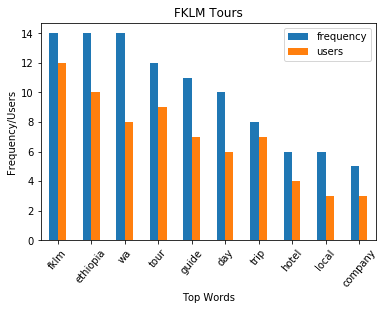

place: Yata Ethiopia tours and Travel


<Figure size 7200x3600 with 0 Axes>

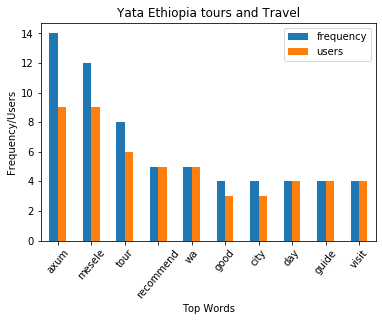

place: Top View Ethiopia Tour


<Figure size 7200x3600 with 0 Axes>

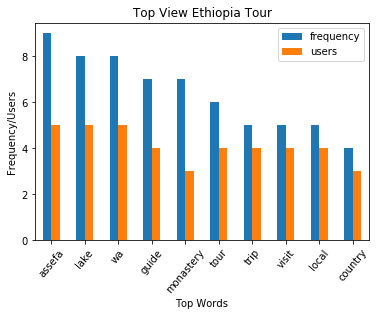

place: Nomadic Ethiopia Tours


<Figure size 7200x3600 with 0 Axes>

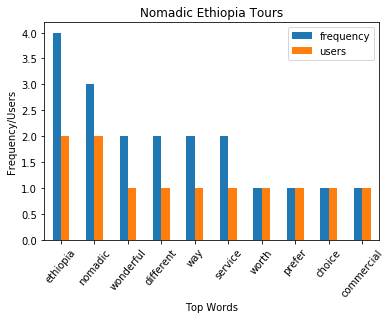

In [22]:
word_cloud_per_place(explorationdata)
get_top_words_by_place(cv, explorationdata)

### Reviews per location

In [23]:
def get_reviews_by_location(location, data):
    return data.loc[data['Location'] == location]
def get_location_names(data):
    return data.Location.unique()
#yeha_reviews=get_reviews_by_hotel("Yeha Hotel", restaurantdata)   
def word_cloud_per_location(data):
    list_of_locations=get_location_names(data)
    print("Total number of locations: " + str(len(list_of_locations)))
    for i, location in enumerate(list_of_locations):
        location_review = get_reviews_by_location(location, data)
        print("Location: "+ location)
        word_cloud(location_review, i, location)

In [24]:
# get top words per location
def get_top_words_by_location(cv, data):
    list_of_locations=get_location_names(data)
    print("Total number of locations: " + str(len(list_of_locations)))
    for i,location in enumerate(list_of_locations):
        print("Location: "+ location)
        location_review = get_reviews_by_location(location, data) 
        dtm=get_dtm(cv,location_review)
        dtm_transpose=dtm.transpose()
        top_words=get_top_words(dtm_transpose, 10)
        plot_top_words(dtm_transpose, 10, i, location)

Total number of locations: 9
Location: Lalibela


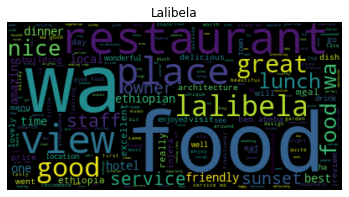

Location: Gonder


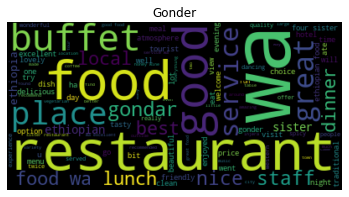

Location: Addis Ababa


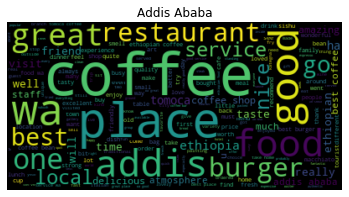

Location: Bishoftu


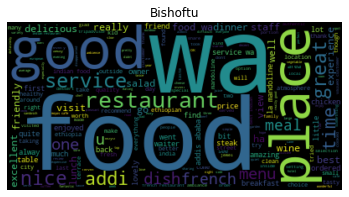

Location: Axum


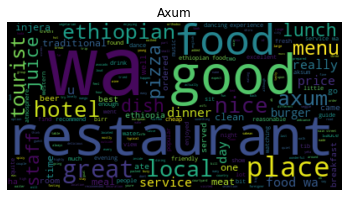

Location: Bahir Dar


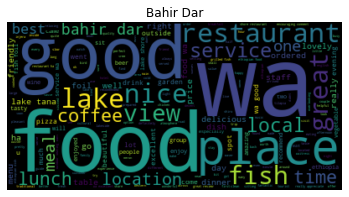

Location: Mekele


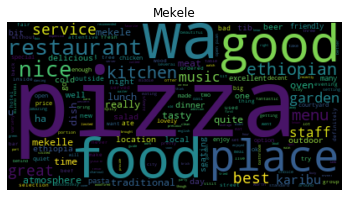

Location: Awasa


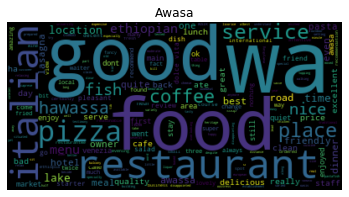

Location: Arba Minch


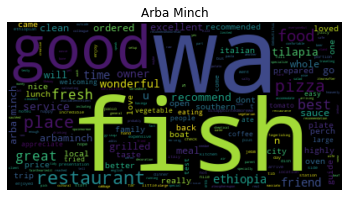

Total number of locations: 9
Location: Lalibela


<Figure size 7200x3600 with 0 Axes>

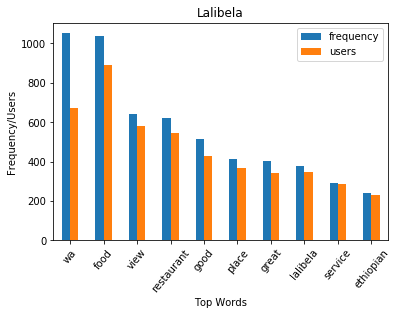

Location: Gonder


<Figure size 7200x3600 with 0 Axes>

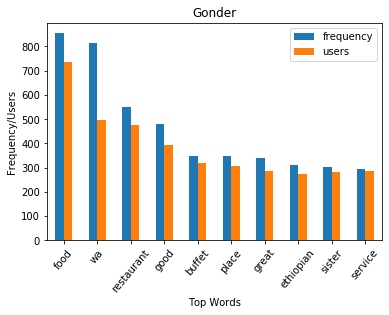

Location: Addis Ababa


<Figure size 7200x3600 with 0 Axes>

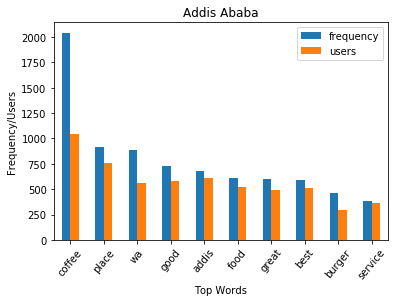

Location: Bishoftu


<Figure size 7200x3600 with 0 Axes>

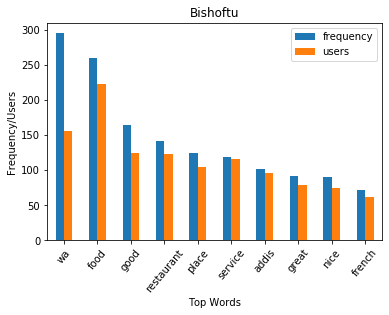

Location: Axum


<Figure size 7200x3600 with 0 Axes>

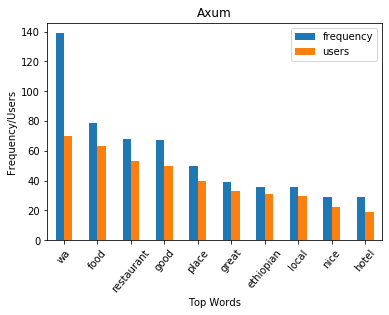

Location: Bahir Dar


<Figure size 7200x3600 with 0 Axes>

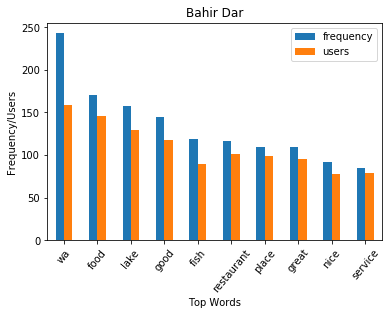

Location: Mekele


<Figure size 7200x3600 with 0 Axes>

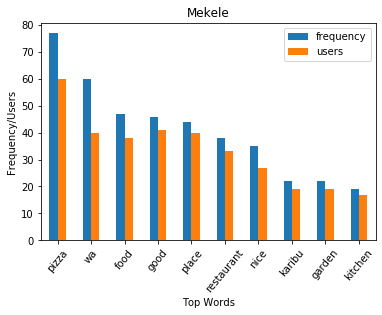

Location: Awasa


<Figure size 7200x3600 with 0 Axes>

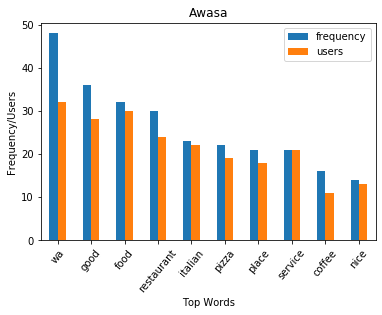

Location: Arba Minch


<Figure size 7200x3600 with 0 Axes>

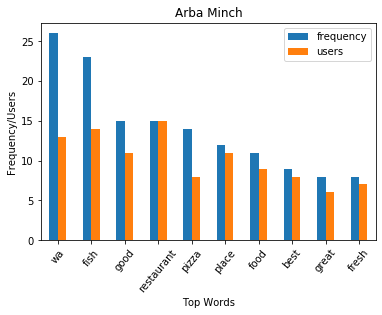

In [25]:
word_cloud_per_location(restaurantdata)
get_top_words_by_location(cv, restaurantdata)

Total number of locations: 9
Location: Addis Ababa


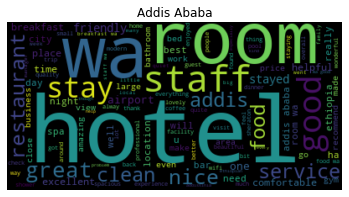

Location: Mekele Ethiopia


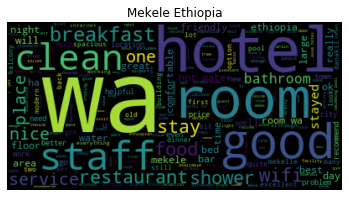

Location: Lalibela


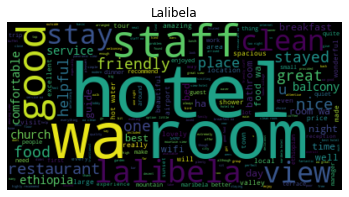

Location: Bishoftu


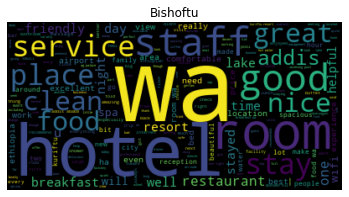

Location: Awasa


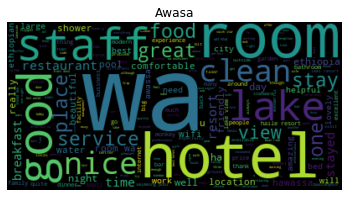

Location: Gonder


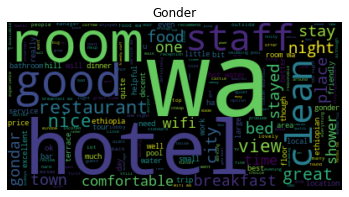

Location: Arba Minch


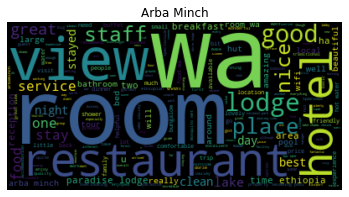

Location: Bahir Dar


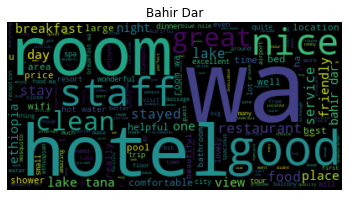

Location: Axum


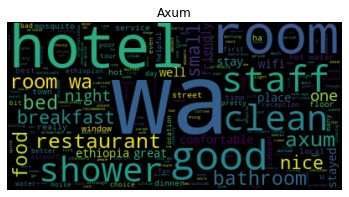

Total number of locations: 9
Location: Addis Ababa


<Figure size 7200x3600 with 0 Axes>

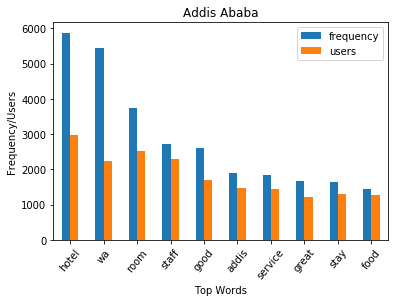

Location: Mekele Ethiopia


<Figure size 7200x3600 with 0 Axes>

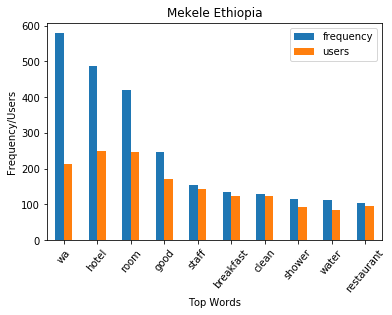

Location: Lalibela


<Figure size 7200x3600 with 0 Axes>

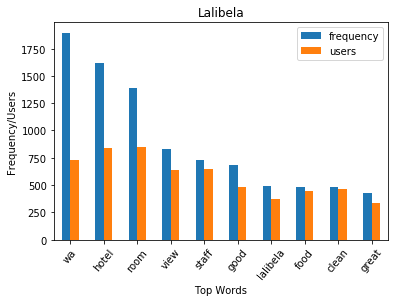

Location: Bishoftu


<Figure size 7200x3600 with 0 Axes>

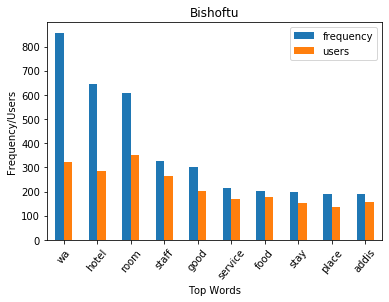

Location: Awasa


<Figure size 7200x3600 with 0 Axes>

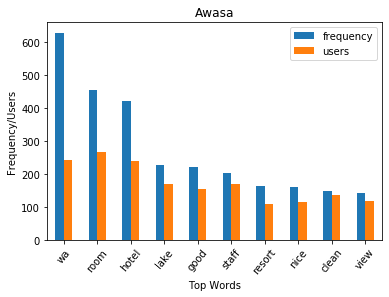

Location: Gonder


<Figure size 7200x3600 with 0 Axes>

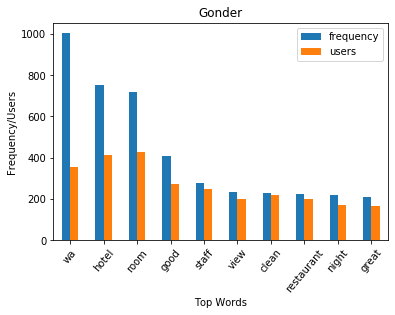

Location: Arba Minch


<Figure size 7200x3600 with 0 Axes>

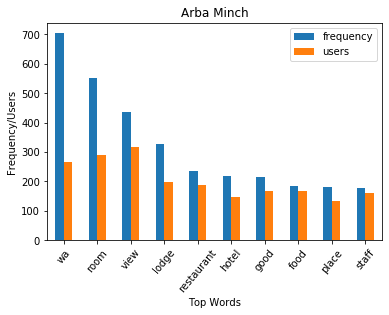

Location: Bahir Dar


<Figure size 7200x3600 with 0 Axes>

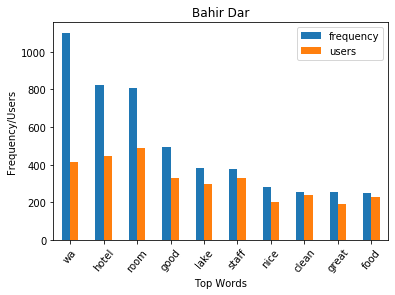

Location: Axum


<Figure size 7200x3600 with 0 Axes>

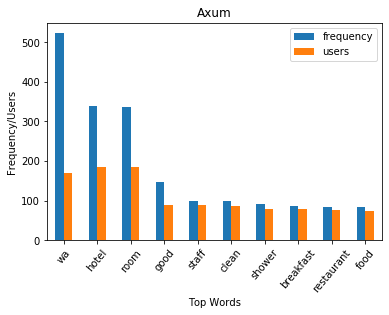

In [26]:
word_cloud_per_location(hoteldata)
get_top_words_by_location(cv, hoteldata)

Total number of locations: 10
Location: Lalibela


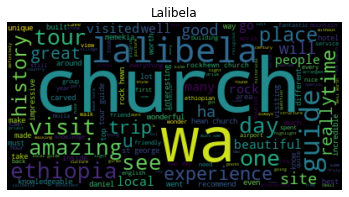

Location: Gonder


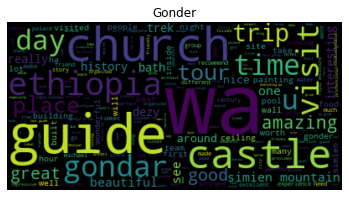

Location: Addis Ababa


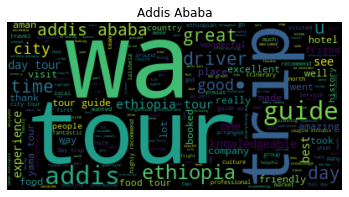

Location: Amhara Region


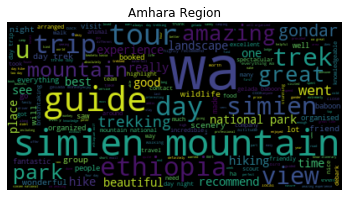

Location: Mekele


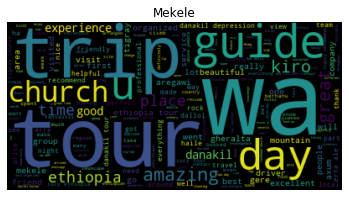

Location: Bishoftu


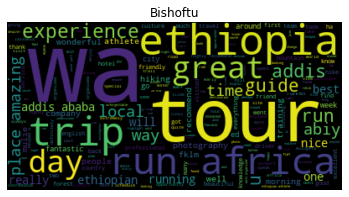

Location: Axum


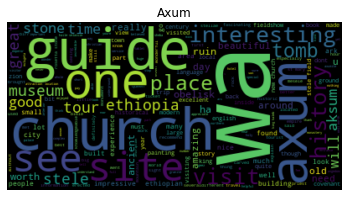

Location: Arba Minch


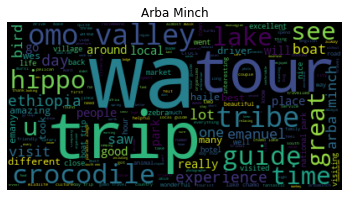

Location: Bahir Dar


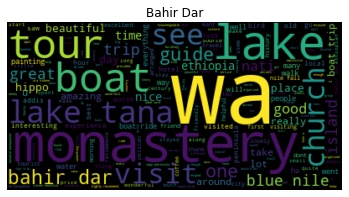

Location: Awasa


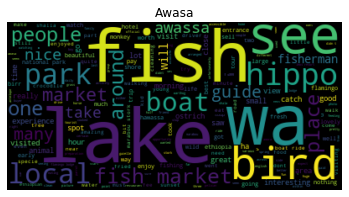

Total number of locations: 10
Location: Lalibela


<Figure size 7200x3600 with 0 Axes>

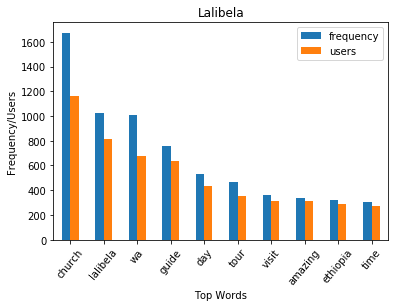

Location: Gonder


<Figure size 7200x3600 with 0 Axes>

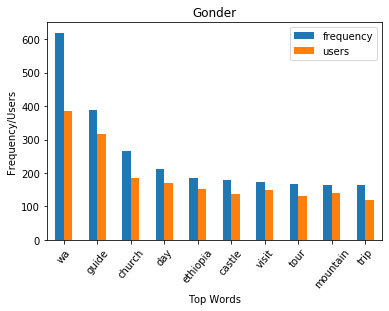

Location: Addis Ababa


<Figure size 7200x3600 with 0 Axes>

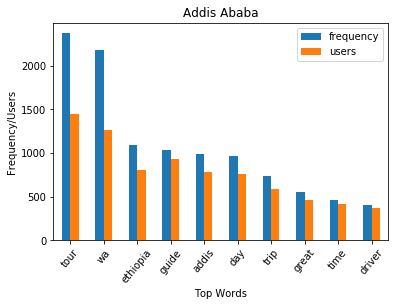

Location: Amhara Region


<Figure size 7200x3600 with 0 Axes>

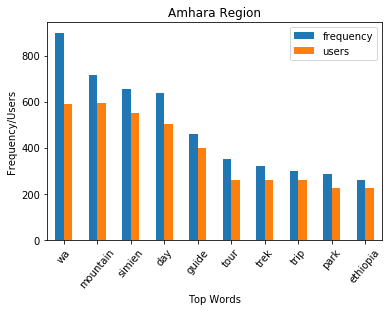

Location: Mekele


<Figure size 7200x3600 with 0 Axes>

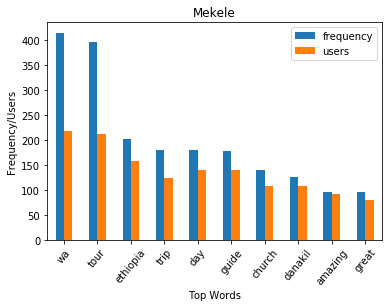

Location: Bishoftu


<Figure size 7200x3600 with 0 Axes>

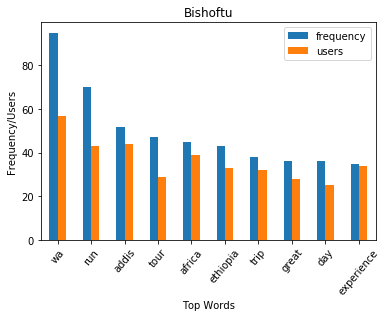

Location: Axum


<Figure size 7200x3600 with 0 Axes>

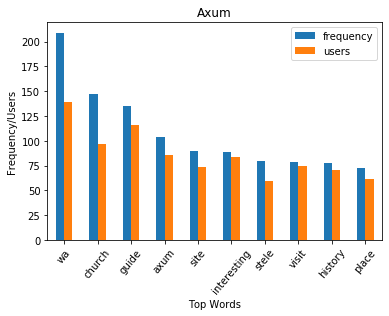

Location: Arba Minch


<Figure size 7200x3600 with 0 Axes>

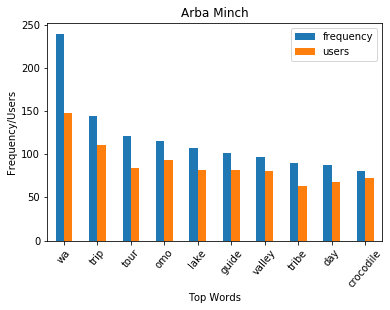

Location: Bahir Dar


<Figure size 7200x3600 with 0 Axes>

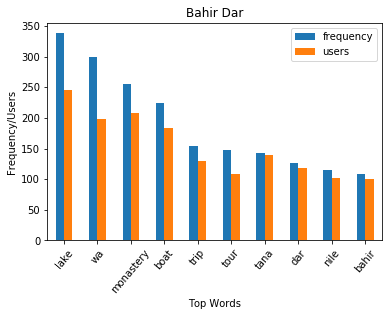

Location: Awasa


<Figure size 7200x3600 with 0 Axes>

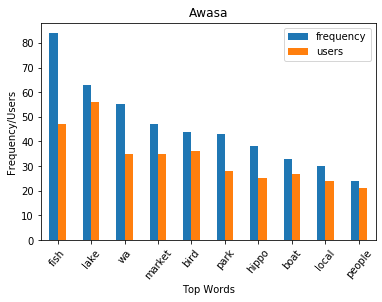

In [27]:
word_cloud_per_location(explorationdata)
get_top_words_by_location(cv, explorationdata)

In [28]:
from datetime import datetime
def range_of_reviews(data):
    sorted_reviews = data.sort_values(by=['Date'], inplace=True, ascending=True)
    first_review_date = data.loc[data.first_valid_index()].Date
    last_review_date = data.loc[data.last_valid_index()].Date
    
    return first_review_date.strftime("%x")+ " - " +last_review_date.strftime("%x")
print("The range of time for the whole reviews is: "+ range_of_reviews(alldata))
print("The range of time for the restaurant reviews is: "+ range_of_reviews(restaurantdata))
print("The range of time for the exploration reviews is: "+ range_of_reviews(explorationdata))
print("The range of time for the hotel reviews is: "+ range_of_reviews(hoteldata))
#print(hoteldata.head(1).Date)

The range of time for the whole reviews is: 01/01/15 - 09/13/20
The range of time for the restaurant reviews is: 01/01/15 - 08/16/20
The range of time for the exploration reviews is: 01/01/15 - 09/08/20
The range of time for the hotel reviews is: 01/01/15 - 09/13/20


In [29]:
def number_of_reviews(data):
    return len(data)

print("Total number of Reviews: "+ str(number_of_reviews(alldata)))
print("Total number of Restaurant Reviews: "+ str(number_of_reviews(restaurantdata)))
print("Total number of Exploration Reviews: "+ str(number_of_reviews(explorationdata)))
print("Total number of Hotel Reviews: "+ str(number_of_reviews(hoteldata)))

Total number of Reviews: 21835
Total number of Restaurant Reviews: 6170
Total number of Exploration Reviews: 7541
Total number of Hotel Reviews: 8124


In [30]:

def seasonality_per_month(data):
    count_df=pd.DataFrame()
    year=[]
    month=[]
    count=[]
    data["Month"]=pd.to_datetime(data.Date).dt.month
    data["Year"]=pd.to_datetime(data.Date).dt.year
   # print(data.loc[data["Year"]==2016])
    first_year=data.loc[data.first_valid_index()].Year
    last_year=data.loc[data.last_valid_index()].Year
    for i in range(first_year,last_year+1):
        #print("In year: " + str(i) + " " + str(len(data.loc[data["Year"]==i])))
        for k in range(1,13):
            #print("   In Month: " + str(k) + " " + str(len(data[(data["Month"]==k) & (data["Year"]==i)])))
            month.append(k)
            year.append(i)
            count.append(len(data[(data["Month"]==k) & (data["Year"]==i)]))
    count_df["Year"]= year
    count_df["Month"]= month
    count_df["Count"]= count
    
    for i in range(first_year,last_year+1):
        count_df[count_df["Year"]==i].plot( x="Month", y="Count", title=i)
    return count_df
            
    
        

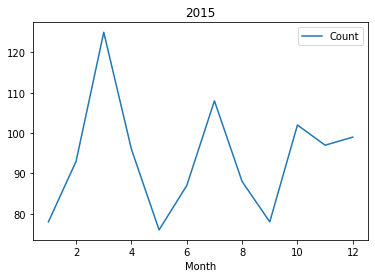

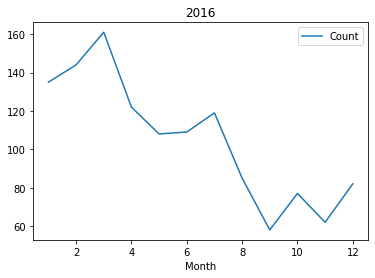

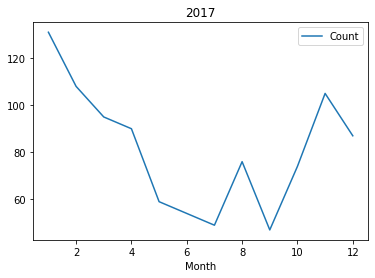

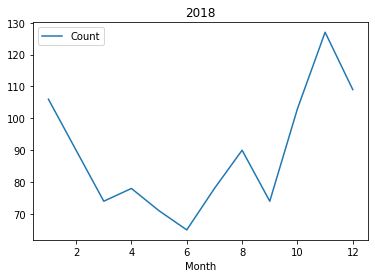

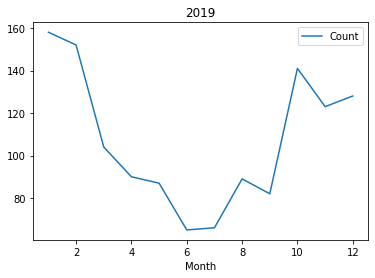

...

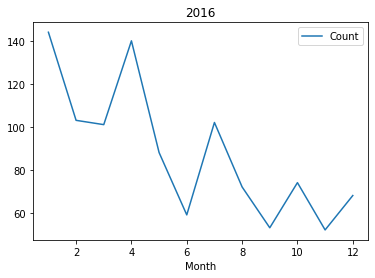

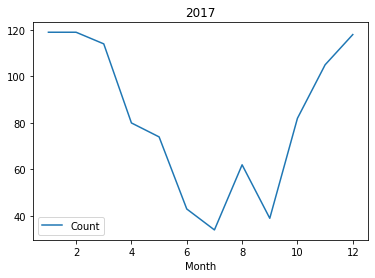

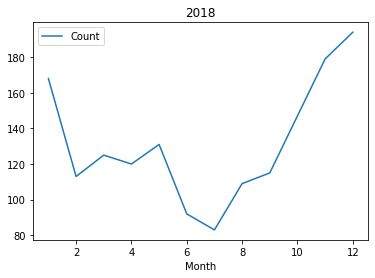

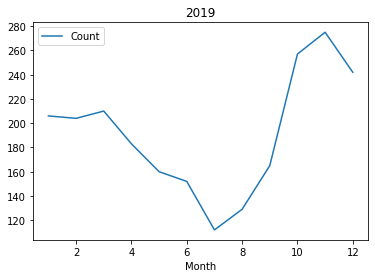

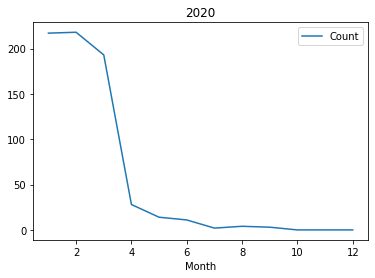

In [31]:
rest_count=seasonality_per_month(restaurantdata)
hotel_count=seasonality_per_month(hoteldata)
explore_count=seasonality_per_month(explorationdata)



### Trigram Analysis

In [32]:
from sklearn.feature_extraction.text import CountVectorizer
def extract_ngram(data, n):
    cv_gram = CountVectorizer(stop_words='english', ngram_range=(n,n))
    ngrams = cv_gram.fit_transform(data)
    count_values = ngrams.toarray().sum(axis=0)
    # list of ngrams
    vocab = cv_gram.vocabulary_
    df_ngram = pd.DataFrame(sorted([(count_values[i],k) for k,i in vocab.items()], reverse=True)
            ).rename(columns={0: 'frequency', 1:'ngram'})
    return df_ngram


#extract_ngram(restaurantdata['Review_Whole'],3)

In [33]:
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
from sklearn.preprocessing import normalize

def tf_idf_vec(data, n):
    tf_idf_vectorizor = TfidfVectorizer(stop_words = 'english',#tokenizer = tokenize_and_stem,
                             max_features = 5000, ngram_range=(n,n))
    tf_idf = tf_idf_vectorizor.fit_transform(data)
    tf_idf_norm = normalize(tf_idf)
    tf_idf_array = tf_idf_norm.toarray()
    pd.DataFrame(tf_idf_array, columns=tf_idf_vectorizor.get_feature_names()).head()
    return tf_idf_array,tf_idf_vectorizor


In [34]:
class Kmeans:
    """ K Means Clustering
    
    Parameters
    -----------
        k: int , number of clusters
        
        seed: int, will be randomly set if None
        
        max_iter: int, number of iterations to run algorithm, default: 200
        
    Attributes
    -----------
       centroids: array, k, number_features
       
       cluster_labels: label for each data point
       
    """
    
    def __init__(self, k, seed = None, max_iter = 200):
        self.k = k
        self.seed = seed
        if self.seed is not None:
            np.random.seed(self.seed)
        self.max_iter = max_iter
        
            
    
    def initialise_centroids(self, data):
        """Randomly Initialise Centroids
        
        Parameters
        ----------
        data: array or matrix, number_rows, number_features
        
        Returns
        --------
        centroids: array of k centroids chosen as random data points 
        """
        
        initial_centroids = np.random.permutation(data.shape[0])[:self.k]
        self.centroids = data[initial_centroids]

        return self.centroids
    
    
    def assign_clusters(self, data):
        """Compute distance of data from clusters and assign data point
           to closest cluster.
        
        Parameters
        ----------
        data: array or matrix, number_rows, number_features
        
        Returns
        --------
        cluster_labels: index which minmises the distance of data to each
        cluster
            
        """
        
        if data.ndim == 1:
            data = data.reshape(-1, 1)
        
        dist_to_centroid =  pairwise_distances(data, self.centroids, metric = 'euclidean')
        self.cluster_labels = np.argmin(dist_to_centroid, axis = 1)
        
        return  self.cluster_labels
    
    
    def update_centroids(self, data):
        """Computes average of all data points in cluster and
           assigns new centroids as average of data points
        
        Parameters
        -----------
        data: array or matrix, number_rows, number_features
        
        Returns
        -----------
        centroids: array, k, number_features
        """
        
        self.centroids = np.array([data[self.cluster_labels == i].mean(axis = 0) for i in range(self.k)])
        
        return self.centroids
    
    
    
    def predict(self, data):
        """Predict which cluster data point belongs to
        
        Parameters
        ----------
        data: array or matrix, number_rows, number_features
        
        Returns
        --------
        cluster_labels: index which minmises the distance of data to each
        cluster
        """
        
        return self.assign_clusters(data)
    
    def fit_kmeans(self, data):
        """
        This function contains the main loop to fit the algorithm
        Implements initialise centroids and update_centroids
        according to max_iter
        -----------------------
        
        Returns
        -------
        instance of kmeans class
            
        """
        self.centroids = self.initialise_centroids(data)
        
        # Main kmeans loop
        for iter in range(self.max_iter):

            self.cluster_labels = self.assign_clusters(data)
            self.centroids = self.update_centroids(data)          
            if iter % 100 == 0:
                print("Running Model Iteration %d " %iter)
        print("Model finished running")
        return self   

In [35]:
from sklearn.decomposition import PCA
from sklearn.metrics import pairwise_distances
def plt_cluster(n, tf_idf_array):
    sklearn_pca = PCA(n_components = 2)
    Y_sklearn = sklearn_pca.fit_transform(tf_idf_array)
    test_e = Kmeans(3, 1, 600)
    fitted = test_e.fit_kmeans(Y_sklearn)
    predicted_values = test_e.predict(Y_sklearn)

    fig, ax = plt.subplots()
   
    scatter=ax.scatter(Y_sklearn[:, 0], Y_sklearn[:, 1], c=predicted_values, s=50, cmap='viridis')
    legend1 = ax.legend(*scatter.legend_elements(),
                    loc="upper right", title="Labels")
    ax.add_artist(legend1)
    centers = fitted.centroids
    plt.scatter(centers[:, 0], centers[:, 1],c='black', s=30, alpha=0.6);
    plt.show()
    return Y_sklearn, predicted_values
# produce a legend with the unique colors from the scatter


In [36]:
def elbow_method( Y_sklearn, r_min=1, r_max=7):
    number_clusters = range(1, 7)

    kmeans = [KMeans(n_clusters=i, max_iter = 600) for i in number_clusters]
    kmeans

    score = [kmeans[i].fit(Y_sklearn).score(Y_sklearn) for i in range(len(kmeans))]
    score = [i*-1 for i in score]

    plt.plot(number_clusters, score)
    plt.xlabel('Number of Clusters')
    plt.ylabel('Score')
    plt.title('Elbow Method')
    plt.show()



In [37]:
def get_top_features_cluster(tf_idf_array, prediction, tf_idf_vectorizor, n_feats):
    labels = np.unique(prediction)
    dfs = []
    for label in labels:
        id_temp = np.where(prediction==label) # indices for each cluster
        x_means = np.mean(tf_idf_array[id_temp], axis = 0) # returns average score across cluster
        sorted_means = np.argsort(x_means)[::-1][:n_feats] # indices with top 20 scores
        features = tf_idf_vectorizor.get_feature_names()
        best_features = [(features[i], x_means[i]) for i in sorted_means]
        df = pd.DataFrame(best_features, columns = ['features', 'score'])
        dfs.append(df)
    return dfs


In [38]:
import seaborn as sns
def plot_top_ngram(data,n):
    for i in range(n):
        plt.figure(figsize=(8,6))
        sns.barplot(x = 'score' , y = 'features', orient = 'h' , data = data[i][:10])
    


In [39]:
def plot_features(dfs):
    fig = plt.figure(figsize=(14,12))
    x = np.arange(len(dfs[0]))
    for i, df in enumerate(dfs):
        ax = fig.add_subplot(1, len(dfs), i+1)
        ax.set_title("Cluster: "+ str(i), fontsize = 14)
        ax.spines["top"].set_visible(False)
        ax.spines["right"].set_visible(False)
        ax.set_frame_on(False)
        ax.get_xaxis().tick_bottom()
        ax.get_yaxis().tick_left()
        ax.ticklabel_format(axis='x', style='sci', scilimits=(-2,2))
        ax.barh(x, df.score, align='center', color='#40826d')
        yticks = ax.set_yticklabels(df.features)
    plt.show();


### Trigram Analysis

#### Restaurant Data

Running Model Iteration 0 
Running Model Iteration 100 
Running Model Iteration 200 
Running Model Iteration 300 
Running Model Iteration 400 
Running Model Iteration 500 
Model finished running


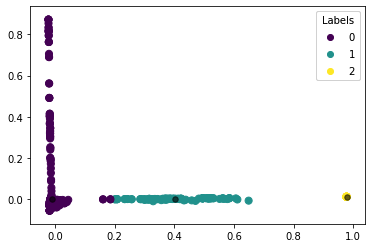

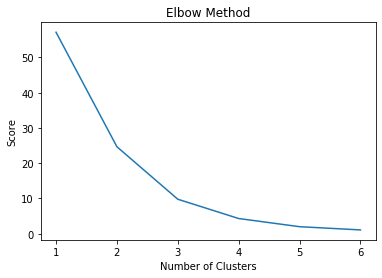

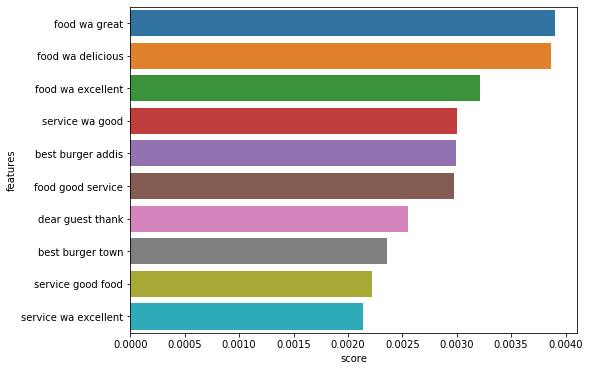

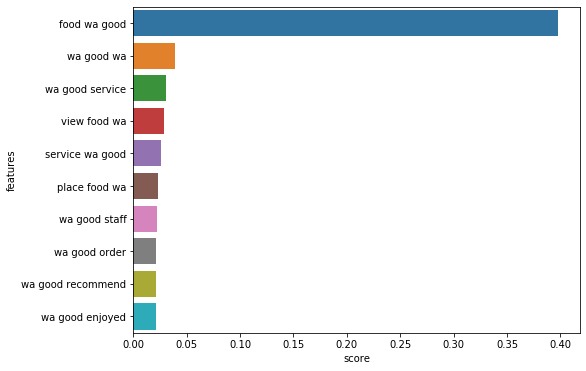

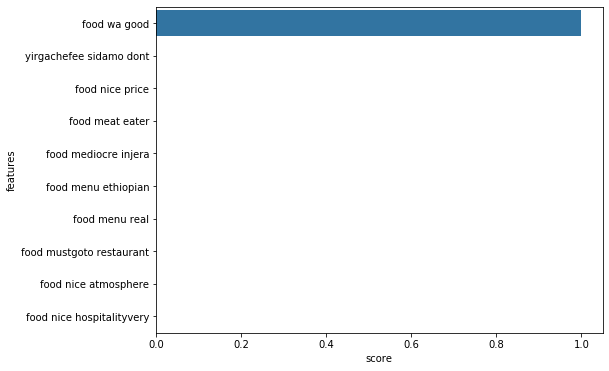

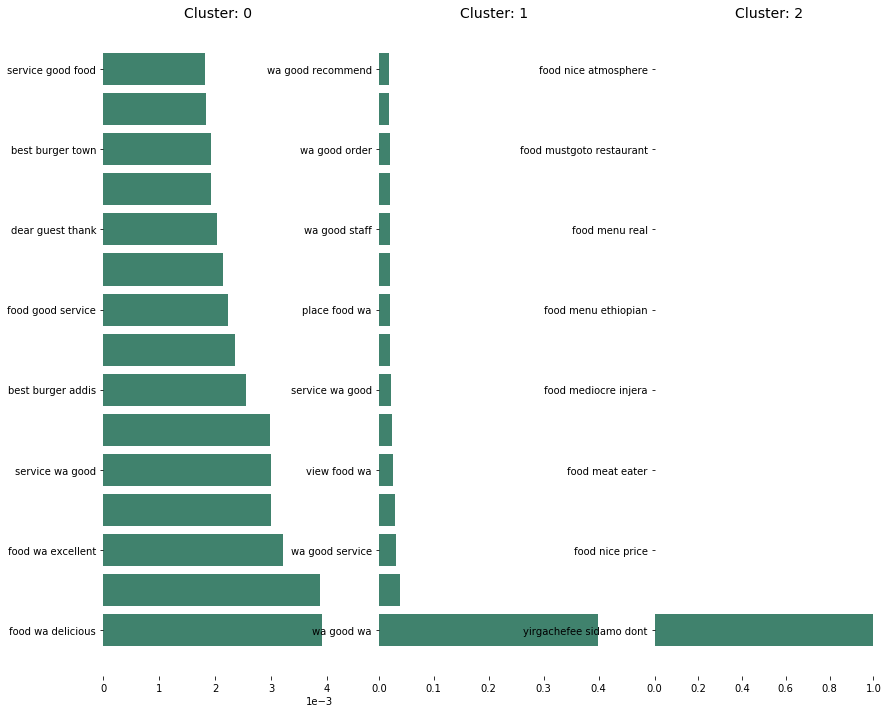

In [40]:
tf_idf_array, tf_idf_vectorizor=tf_idf_vec(restaurantdata["Review_Whole"],3)
Y_sklearn, predicted_values= plt_cluster(3, tf_idf_array)
elbow_method(Y_sklearn)
dfs = get_top_features_cluster(tf_idf_array, predicted_values,tf_idf_vectorizor, 15)
plot_top_ngram(dfs, 3)
plot_features(dfs)

#### Exploration Data

In [41]:
tf_idf_array, tf_idf_vectorizor=tf_idf_vec(explorationdata["Review_Whole"],3)
Y_sklearn, predicted_values= plt_cluster(3, tf_idf_array)
elbow_method(Y_sklearn)
dfs = get_top_features_cluster(tf_idf_array, predicted_values,tf_idf_vectorizor, 15)
plot_top_ngram(dfs, 3)
plot_features(dfs)

/home/beza/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:84: RuntimeWarning: Mean of empty slice.
/home/beza/anaconda3/lib/python3.7/site-packages/numpy/core/_methods.py:154: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)


Running Model Iteration 0 


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

#### Hotel Data

Running Model Iteration 0 
Running Model Iteration 100 
Running Model Iteration 200 
Running Model Iteration 300 
Running Model Iteration 400 
Running Model Iteration 500 
Model finished running


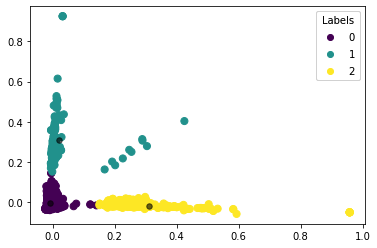

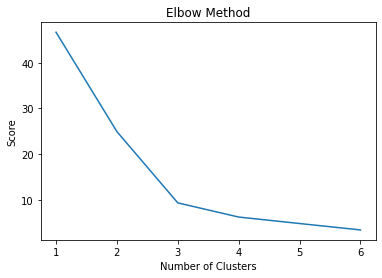

/home/luna/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  


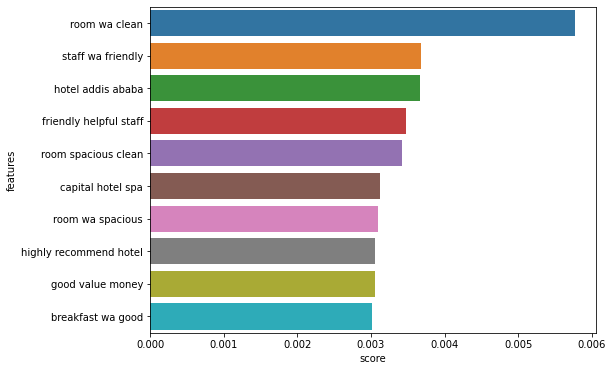

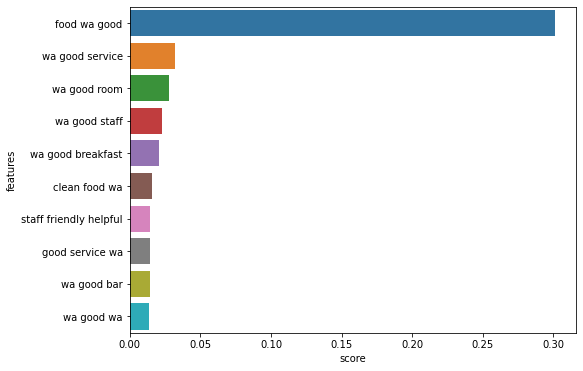

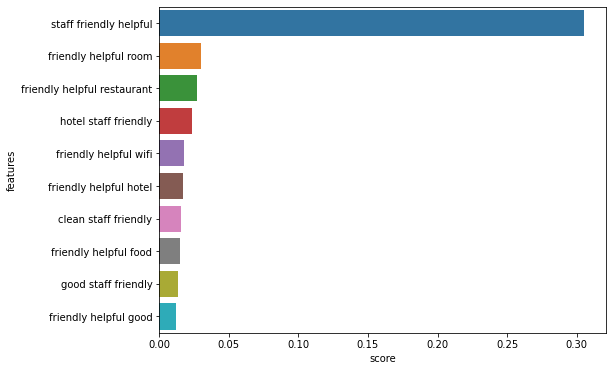

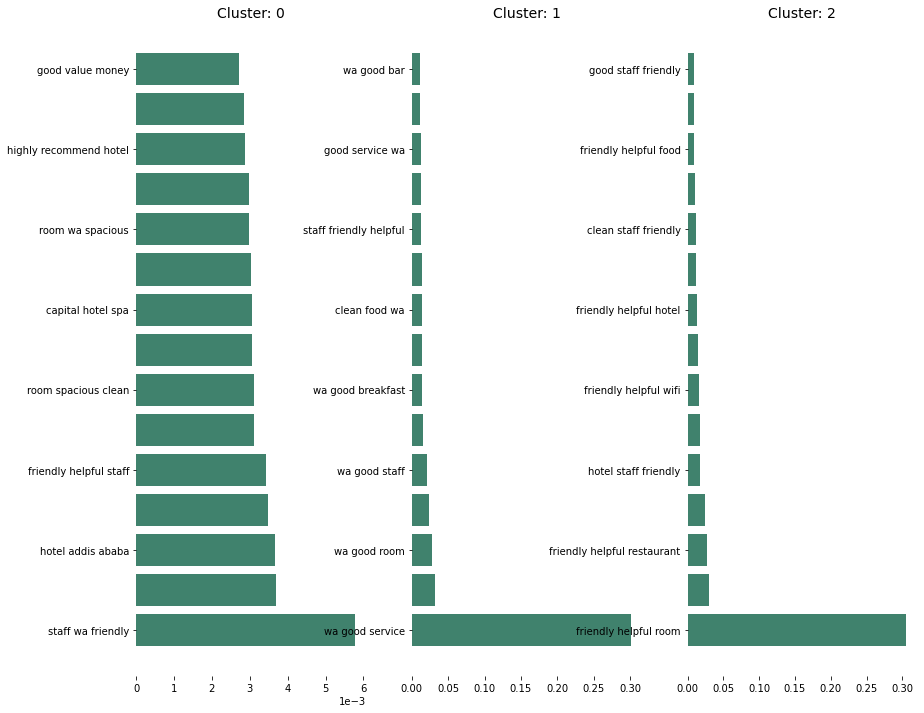

In [41]:
tf_idf_array, tf_idf_vectorizor=tf_idf_vec(hoteldata["Review_Whole"],3)
Y_sklearn, predicted_values= plt_cluster(3, tf_idf_array)
elbow_method(Y_sklearn)
dfs = get_top_features_cluster(tf_idf_array, predicted_values,tf_idf_vectorizor, 15)
plot_top_ngram(dfs, 3)
plot_features(dfs)

### Bigram analyis

#### Restaurant Data

Running Model Iteration 0 
Running Model Iteration 100 
Running Model Iteration 200 
Running Model Iteration 300 
Running Model Iteration 400 
Running Model Iteration 500 
Model finished running


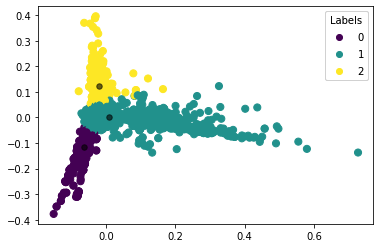

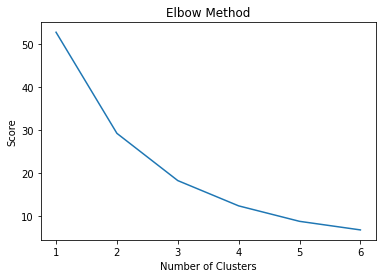

/home/luna/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  


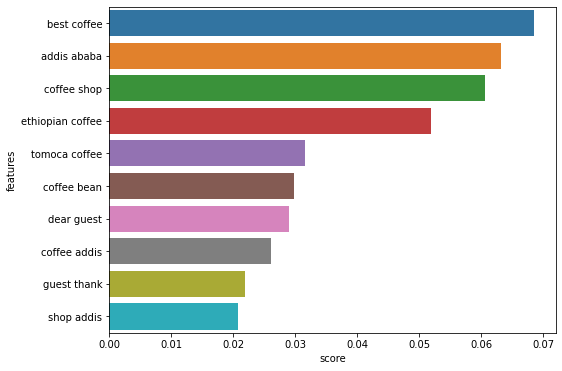

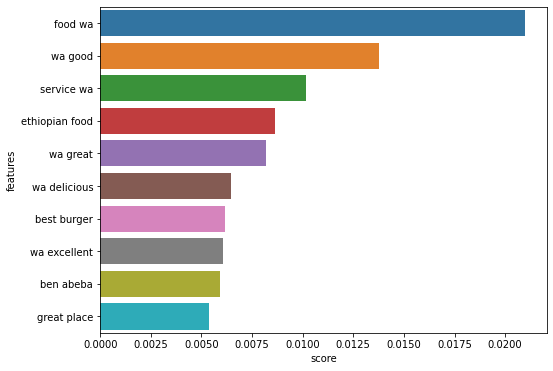

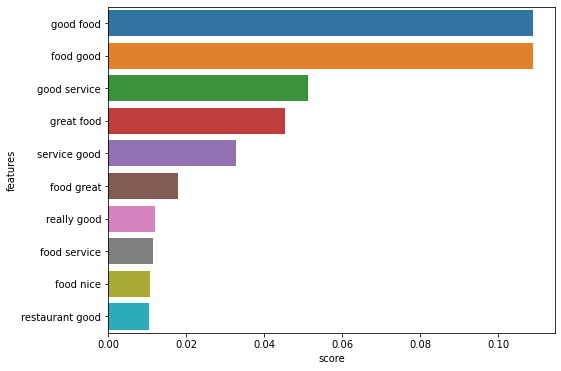

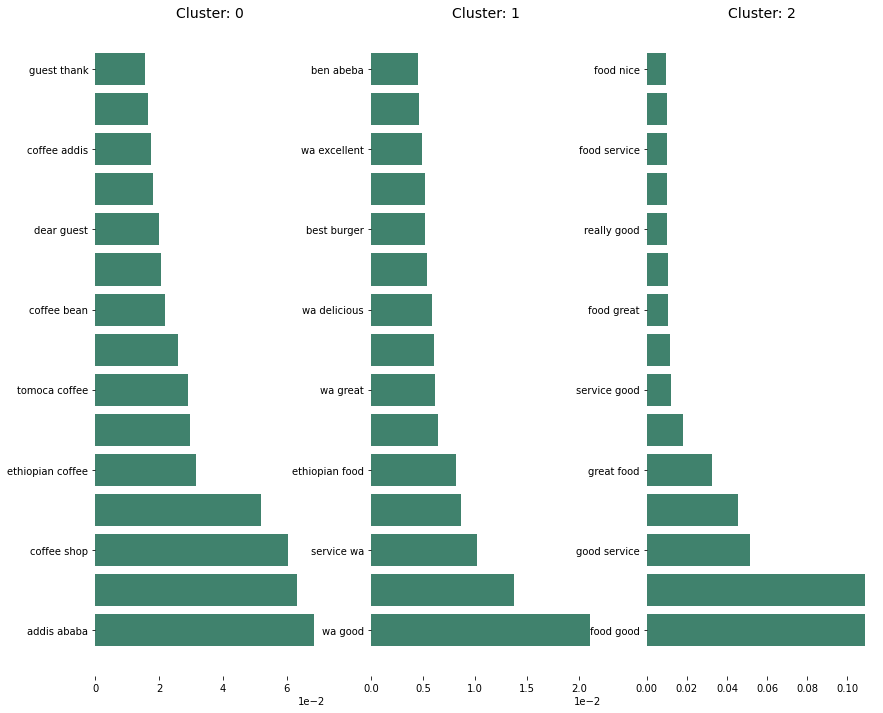

In [42]:
tf_idf_array_bi, tf_idf_vectorizor_bi=tf_idf_vec(restaurantdata['Review_Whole'], 2)
Y_sklearn_bi, predicted_values_bi=plt_cluster(2, tf_idf_array_bi)
elbow_method(Y_sklearn_bi)
dfs_bi = get_top_features_cluster(tf_idf_array_bi, predicted_values_bi, tf_idf_vectorizor_bi, 15)
plot_top_ngram(dfs_bi, 3)
plot_features(dfs_bi)

#### Exploratin Data

Running Model Iteration 0 
Running Model Iteration 100 
Running Model Iteration 200 
Running Model Iteration 300 
Running Model Iteration 400 
Running Model Iteration 500 
Model finished running


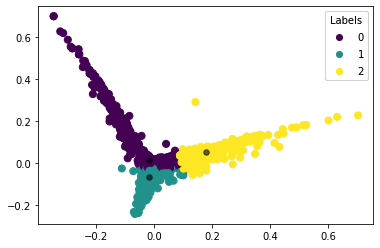

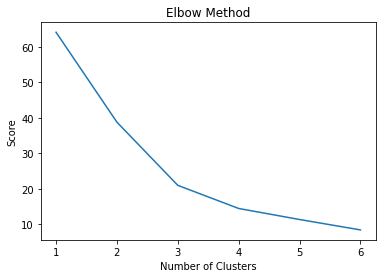

/home/luna/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  


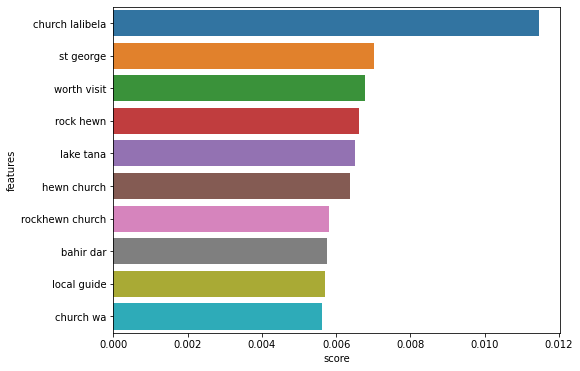

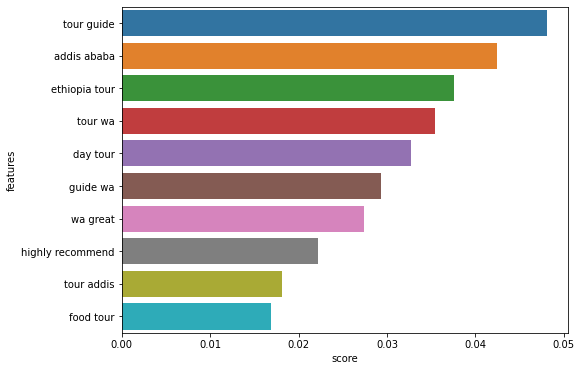

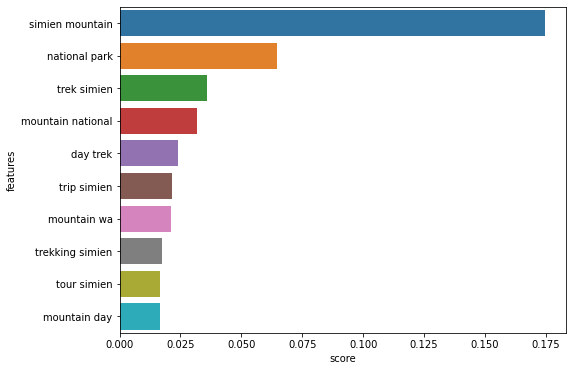

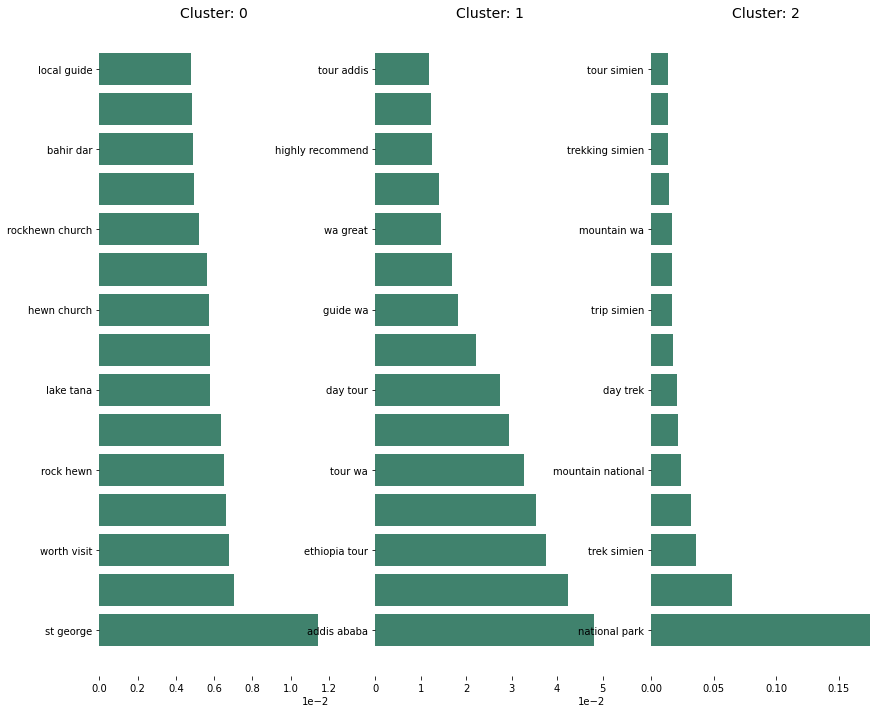

In [43]:
tf_idf_array_bi, tf_idf_vectorizor_bi=tf_idf_vec(explorationdata['Review_Whole'], 2)
Y_sklearn_bi, predicted_values_bi=plt_cluster(3, tf_idf_array_bi)
elbow_method(Y_sklearn_bi)
dfs_bi = get_top_features_cluster(tf_idf_array_bi, predicted_values_bi, tf_idf_vectorizor_bi, 15)
plot_top_ngram(dfs_bi, 3)
plot_features(dfs_bi)

#### Hotel Data

Running Model Iteration 0 
Running Model Iteration 100 
Running Model Iteration 200 
Running Model Iteration 300 
Running Model Iteration 400 
Running Model Iteration 500 
Model finished running


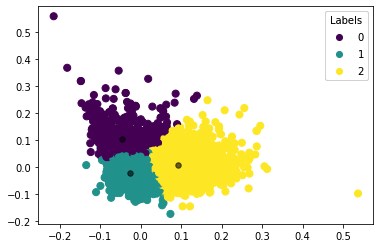

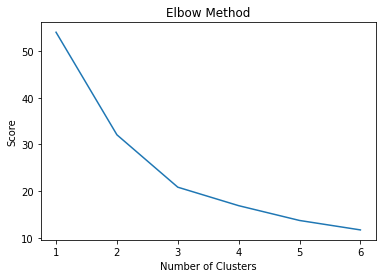

/home/luna/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:14: UserWarning: FixedFormatter should only be used together with FixedLocator
  


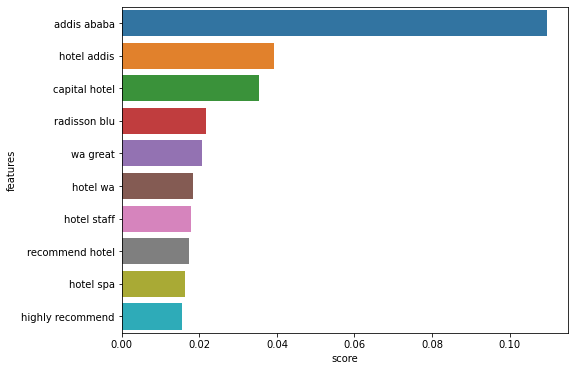

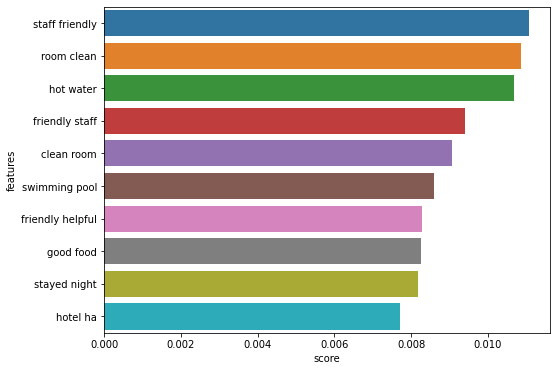

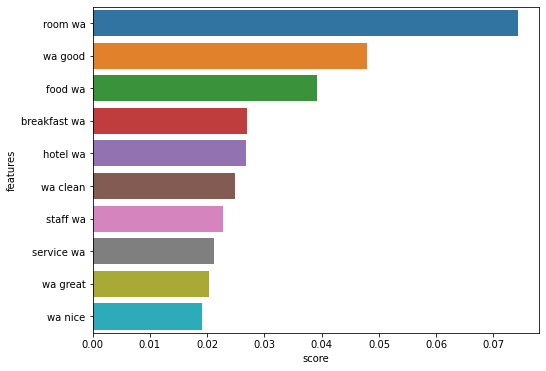

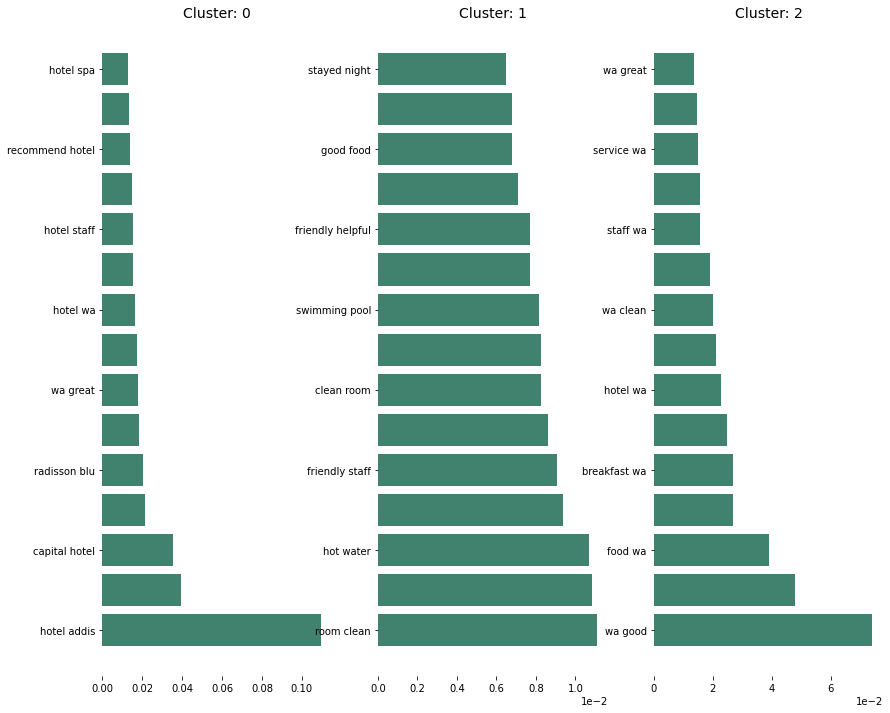

In [44]:
tf_idf_array_bi, tf_idf_vectorizor_bi=tf_idf_vec(hoteldata['Review_Whole'], 2)
Y_sklearn_bi, predicted_values_bi=plt_cluster(3, tf_idf_array_bi)
elbow_method(Y_sklearn_bi)
dfs_bi = get_top_features_cluster(tf_idf_array_bi, predicted_values_bi, tf_idf_vectorizor_bi, 15)
plot_top_ngram(dfs_bi, 3)
plot_features(dfs_bi)

# Step Four: NLP

## Sentiment Analysis

####  Sentiment Analysis by Place
Restaurant Data

In [94]:
def reviews_by_place(data):
    hotel_data=pd.DataFrame()
    list_of_places=get_place_names(data)
    hotel_data["Hotel"]=list_of_places
    hotel_data["Hotel_review"]=""
    for i, place in enumerate(list_of_places):
        place_review = get_reviews_by_place(place, data)
        for review in place_review.Review_Whole:
            hotel_data.loc[hotel_data["Hotel"]==place, "Hotel_review"]=hotel_data.loc[hotel_data["Hotel"]==place, "Hotel_review"]+review
    return hotel_data
    

In [46]:
rest_by_place=reviews_by_place(restaurantdata)

In [47]:
# Create quick lambda functions to find the polarity and subjectivity of each routine
# Terminal / Anaconda Navigator: conda install -c conda-forge textblob
def sentiment(data):
    from textblob import TextBlob
    pol = lambda x: TextBlob(x).sentiment.polarity
    sub = lambda x: TextBlob(x).sentiment.subjectivity
    data['polarity'] = data['Hotel_review'].apply(pol)
    data['subjectivity'] = data['Hotel_review'].apply(sub)
    return data

In [84]:
# Let's plot the results
def plot_sentiment(data, xmin=-0.1, xmax=0.7):
    import matplotlib.pyplot as plt

    plt.rcParams['figure.figsize'] = [100, 50]

    for index, Hotel in enumerate(data.index):
        x = data.polarity.loc[Hotel]
        y = data.subjectivity.loc[Hotel]
        plt.scatter(x, y, color='blue')
        plt.text(x+.001, y+.001, data['Hotel'][index], fontsize=50)
        plt.xlim(xmin, xmax) 
    
    plt.title('Sentiment Analysis', fontsize=40)
    plt.xlabel('<-- Negative -------- Positive -->', fontsize=35)
    plt.ylabel('<-- Facts -------- Opinions -->', fontsize=35)
    plt.savefig('sentiment.png', dpi=200)
    plt.show()

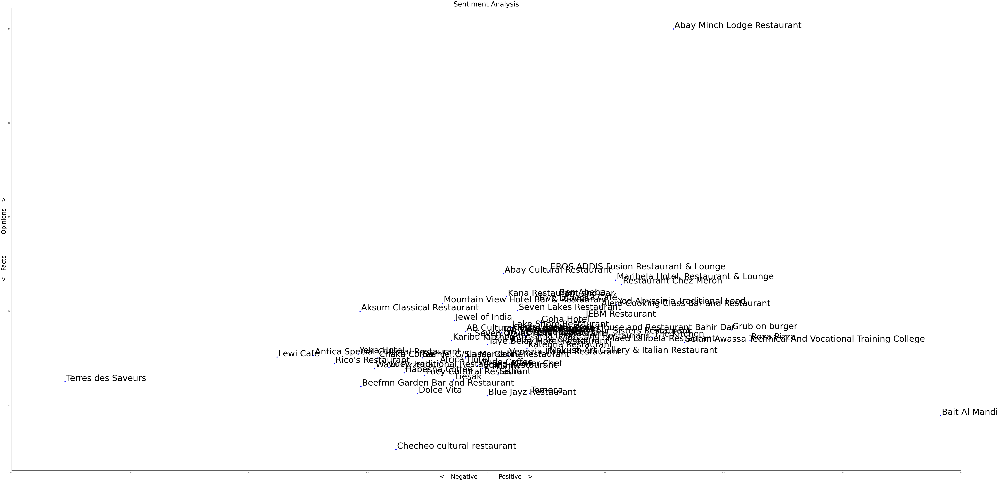

In [85]:
rest_by_place=sentiment(rest_by_place)
plot_sentiment(rest_by_place)

In [95]:
hotel_by_place=reviews_by_place(hoteldata)

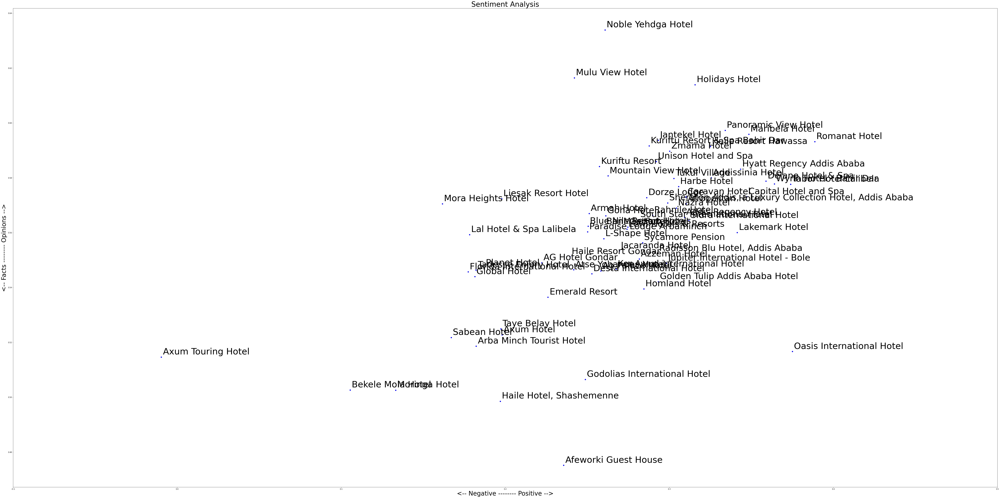

In [97]:
hotel_by_place=sentiment(hotel_by_place)
plot_sentiment(hotel_by_place, -0.1,0.5)

In [98]:
exploration_by_place= reviews_by_place(explorationdata)

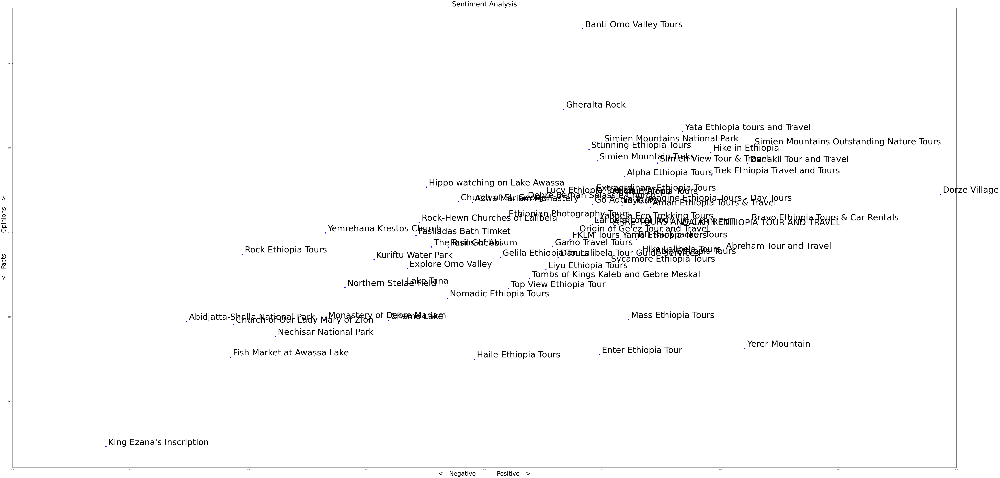

In [99]:
exploration_by_place=sentiment(exploration_by_place)
plot_sentiment(exploration_by_place, 0.1, 0.5)

### Sentiment analysis by location


In [100]:
def reviews_by_location(data):
    location_data=pd.DataFrame()
    list_of_locations=get_location_names(data)
    location_data["Location"]=list_of_locations
    location_data["Location_review"]=""
    for i, location in enumerate(list_of_locations):
        location_review = get_reviews_by_location(location, data)
        for review in location_review.Review_Whole:
            location_data.loc[location_data["Location"]==location, "Location_review"]=location_data.loc[location_data["Location"]==location, "Location_review"]+review
    return location_data
    

In [123]:
def sentiment_location(data):
    from textblob import TextBlob
    pol = lambda x: TextBlob(x).sentiment.polarity
    sub = lambda x: TextBlob(x).sentiment.subjectivity
    data['polarity'] = data['Location_review'].apply(pol)
    data['subjectivity'] = data['Location_review'].apply(sub)
    return data

In [102]:
# Let's plot the results
def plot_sentiment_location(data, xmin=-0.1, xmax=0.7):
    import matplotlib.pyplot as plt

    plt.rcParams['figure.figsize'] = [100, 50]

    for index, Location in enumerate(data.index):
        x = data.polarity.loc[Location]
        y = data.subjectivity.loc[Location]
        plt.scatter(x, y, color='blue')
        plt.text(x+.001, y+.001, data['Location'][index], fontsize=50)
        plt.xlim(xmin, xmax) 
    
    plt.title('Sentiment Analysis', fontsize=40)
    plt.xlabel('<-- Negative -------- Positive -->', fontsize=35)
    plt.ylabel('<-- Facts -------- Opinions -->', fontsize=35)
    plt.savefig('sentiment.png', dpi=200)
    plt.show()

In [103]:
rest_by_location=reviews_by_location(restaurantdata)

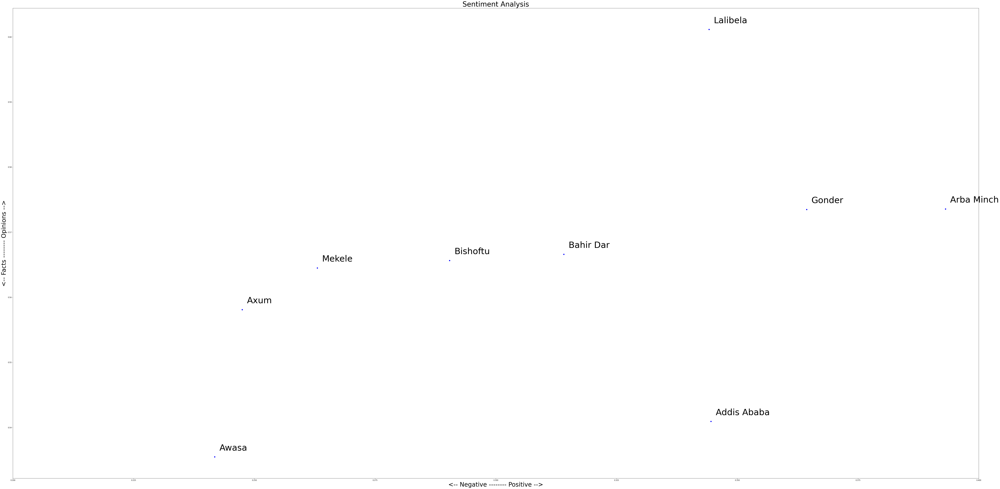

In [104]:
rest_by_location=sentiment_location(rest_by_location)
plot_sentiment_location(rest_by_location, 0.2, 0.4)

In [105]:
hotel_by_location=reviews_by_location(hoteldata)

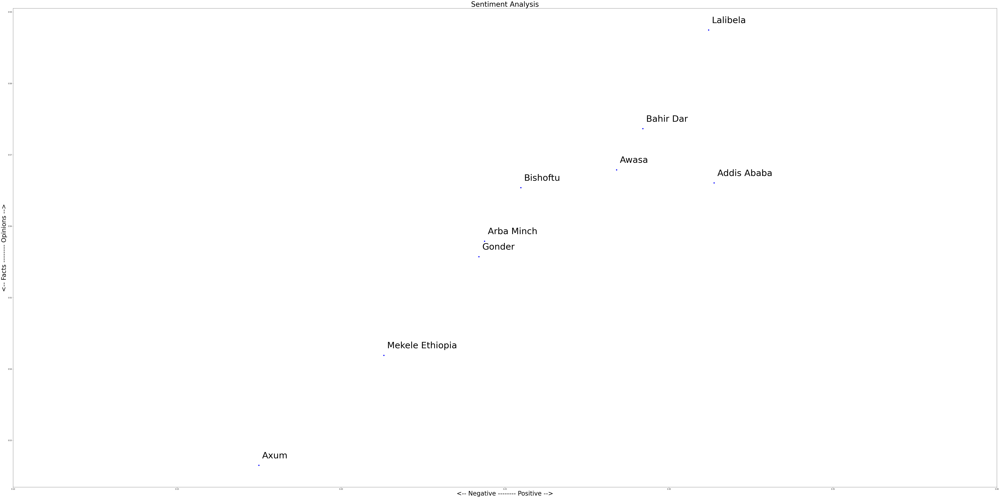

In [106]:
hotel_by_location=sentiment_location(hotel_by_location)
plot_sentiment_location(hotel_by_location, 0.1, 0.4)

In [107]:
exploration_by_location=reviews_by_location(explorationdata)

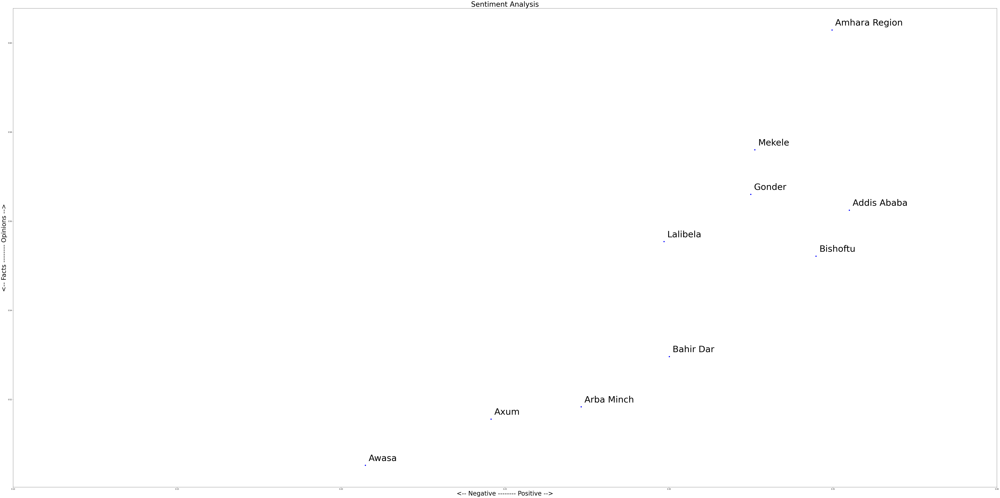

In [108]:
exploration_by_location=sentiment_location(exploration_by_location)
plot_sentiment_location(exploration_by_location, 0.1, 0.4)

### Bigram  Sentiment Analysis


In [159]:

from textblob import TextBlob

In [181]:
rest_bigram=extract_ngram(rest_by_place['Hotel_review'],2)
rest_bigram['polarity'] = rest_bigram['ngram'].apply(lambda x: TextBlob(x).polarity)
rest_bigram['subjectivity'] = rest_bigram['ngram'].apply(lambda x: TextBlob(x).subjectivity)

In [182]:
# Let's plot the results
def plot_sentiment_ngram(data, xmin=-0.1, xmax=0.7, freq=100):
    import matplotlib.pyplot as plt

    plt.rcParams['figure.figsize'] = [100, 50]

    for index, ngram in enumerate(data.index):
        if(data.frequency.loc[ngram]>freq):
            x = data.polarity.loc[ngram]
            y = data.subjectivity.loc[ngram]
            plt.scatter(x, y, color='blue')
            plt.text(x+.001, y+.001, data['ngram'][index], fontsize=50)
            plt.xlim(xmin, xmax) 
    
    plt.title('Sentiment Analysis', fontsize=40)
    plt.xlabel('<-- Negative -------- Positive -->', fontsize=35)
    plt.ylabel('<-- Facts -------- Opinions -->', fontsize=35)
    plt.savefig('sentiment.png', dpi=200)
    plt.show()

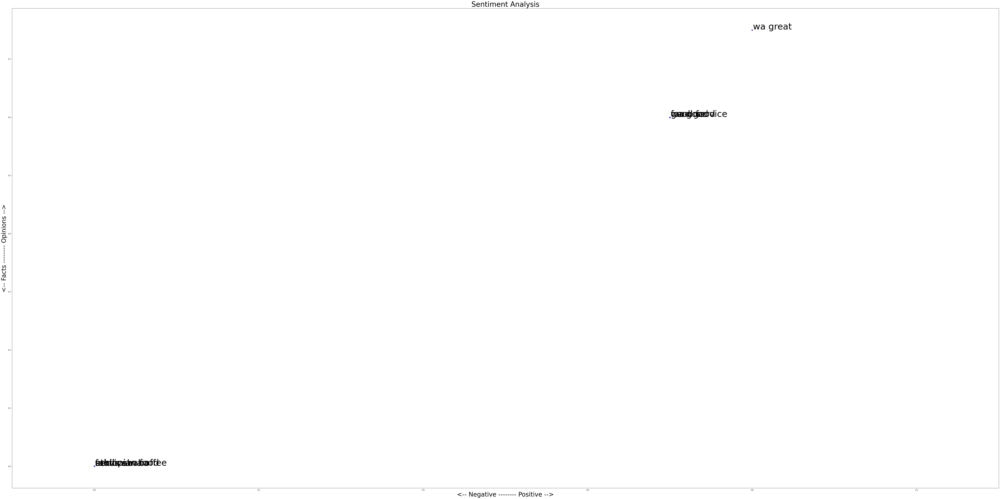

In [207]:
plot_sentiment_ngram(rest_bigram, -0.1, 1.1, 143)

In [206]:
rest_bigram.head(10)

,frequency,ngram,polarity,subjectivity
0,572,food wa,0.0,0.00
1,314,wa good,0.7,0.60
2,224,service wa,0.0,0.00
3,210,ethiopian food,0.0,0.00
4,192,good food,0.7,0.60
5,192,food good,0.7,0.60
6,166,addis ababa,0.0,0.00
7,164,wa great,0.8,0.75
8,147,ethiopian coffee,0.0,0.00
9,144,good service,0.7,0.60


In [178]:
hotel_bigram=extract_ngram(hotel_by_place['Hotel_review'],2)
hotel_bigram['polarity'] = hotel_bigram['ngram'].apply(lambda x: TextBlob(x).polarity)
hotel_bigram['subjectivity'] = hotel_bigram['ngram'].apply(lambda x: TextBlob(x).subjectivity)

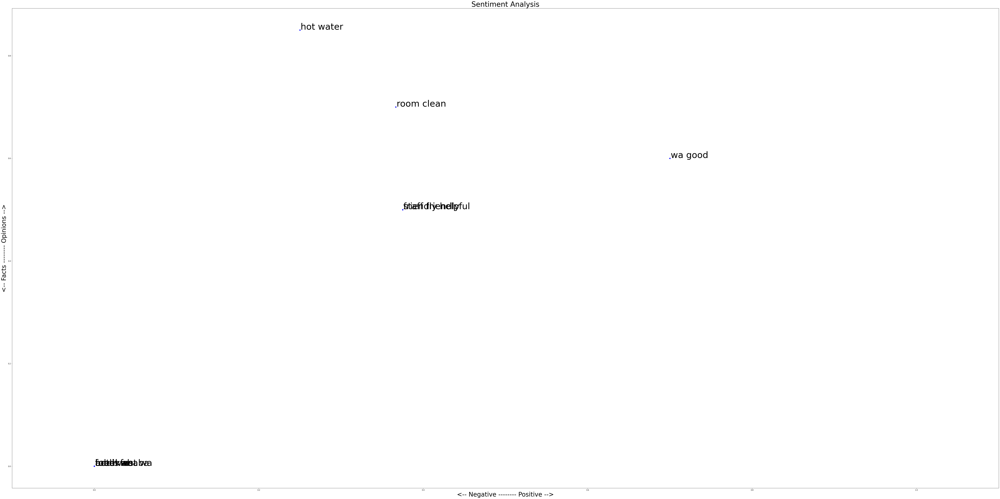

In [209]:
plot_sentiment_ngram(hotel_bigram, -0.1, 1.1, 457)

In [208]:
hotel_bigram.head(10)

,frequency,ngram,polarity,subjectivity
0,1327,room wa,0.000000,0.00
1,712,wa good,0.700000,0.60
2,673,food wa,0.000000,0.00
3,646,hotel wa,0.000000,0.00
4,630,hot water,0.250000,0.85
5,610,staff friendly,0.375000,0.50
6,605,addis ababa,0.000000,0.00
7,497,breakfast wa,0.000000,0.00
8,494,room clean,0.366667,0.70
9,458,friendly helpful,0.375000,0.50


In [175]:
explore_bigram=extract_ngram(exploration_by_place['Hotel_review'],2)
explore_bigram['polarity'] = explore_bigram['ngram'].apply(lambda x: TextBlob(x).polarity)
explore_bigram['subjectivity'] = explore_bigram['ngram'].apply(lambda x: TextBlob(x).subjectivity)

In [211]:
explore_bigram.head(10)

,frequency,ngram,polarity,subjectivity
0,667,simien mountain,0.00,0.00
1,456,tour guide,0.00,0.00
2,375,addis ababa,0.00,0.00
3,350,wa great,0.80,0.75
4,340,tour wa,0.00,0.00
5,338,day tour,0.00,0.00
6,334,ethiopia tour,0.00,0.00
7,316,guide wa,0.00,0.00
8,271,highly recommend,0.16,0.54
9,255,day trip,0.00,0.00


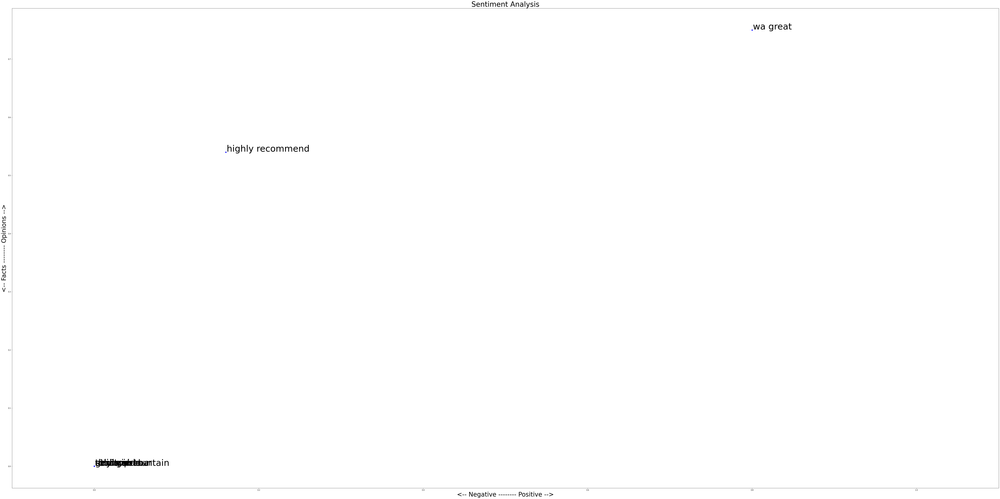

In [212]:
plot_sentiment_ngram(explore_bigram, -0.1, 1.1, 254)

## Trigram Analysis


In [213]:
rest_trigram=extract_ngram(rest_by_place['Hotel_review'],3)
rest_trigram['polarity'] = rest_trigram['ngram'].apply(lambda x: TextBlob(x).polarity)
rest_trigram['subjectivity'] = rest_trigram['ngram'].apply(lambda x: TextBlob(x).subjectivity)

In [214]:
rest_trigram.head(10)

,frequency,ngram,polarity,subjectivity
0,123,food wa good,0.7,0.60
1,51,food wa delicious,1.0,1.00
2,43,food wa great,0.8,0.75
3,42,service wa good,0.7,0.60
4,38,food wa excellent,1.0,1.00
5,34,review reflecting visit,0.0,0.00
6,33,thank review reflecting,0.0,0.00
7,33,guest thank review,0.0,0.00
8,33,food good service,0.7,0.60
9,31,coffee shop addis,0.0,0.00


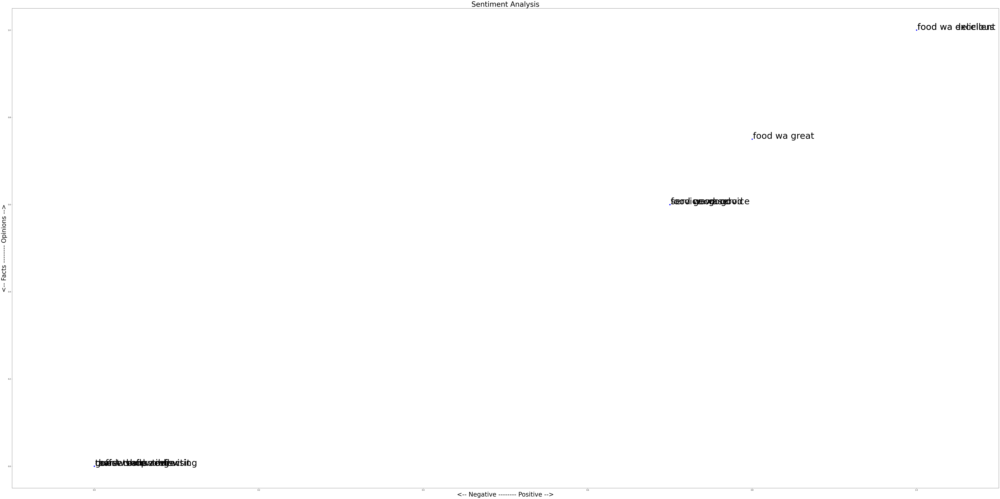

In [215]:
plot_sentiment_ngram(rest_trigram, -0.1, 1.1, 30)

In [201]:
hotel_trigram=extract_ngram(hotel_by_place['Hotel_review'],3)
hotel_trigram['polarity'] = hotel_trigram['ngram'].apply(lambda x: TextBlob(x).polarity)
hotel_trigram['subjectivity'] = hotel_trigram['ngram'].apply(lambda x: TextBlob(x).subjectivity)

In [216]:
hotel_trigram.head(10)

,frequency,ngram,polarity,subjectivity
0,210,staff friendly helpful,0.375000,0.5
1,175,room wa clean,0.366667,0.7
2,166,food wa good,0.700000,0.6
3,101,staff wa friendly,0.375000,0.5
4,85,room wa spacious,0.000000,0.0
5,84,hotel addis ababa,0.000000,0.0
6,77,breakfast wa good,0.700000,0.6
7,75,room spacious clean,0.366667,0.7
8,73,room wa comfortable,0.400000,0.8
9,72,restaurant wa good,0.700000,0.6


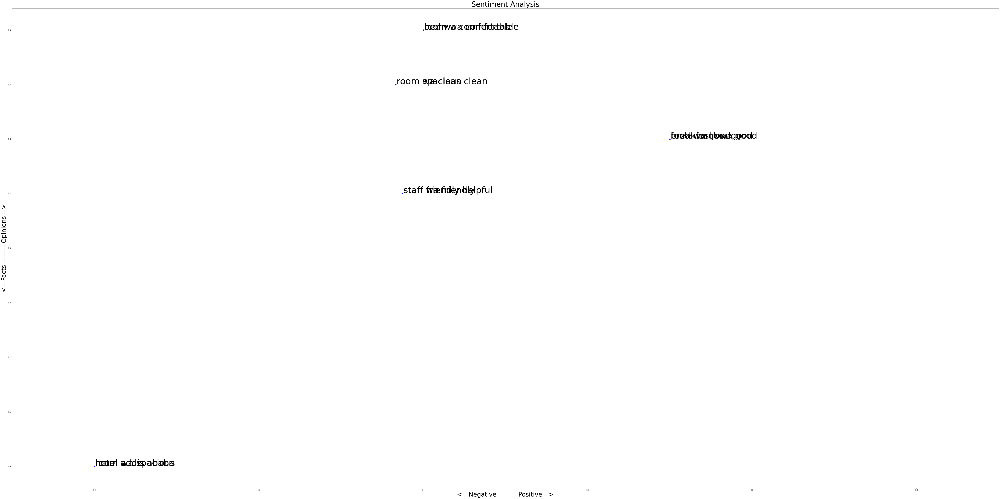

In [217]:
plot_sentiment_ngram(hotel_trigram, -0.1, 1.1, 71)

In [203]:
explore_trigram=extract_ngram(exploration_by_place['Hotel_review'],3)
explore_trigram['polarity'] = explore_trigram['ngram'].apply(lambda x: TextBlob(x).polarity)
explore_trigram['subjectivity'] = explore_trigram['ngram'].apply(lambda x: TextBlob(x).subjectivity)

In [219]:
explore_trigram.head(10)

,frequency,ngram,polarity,subjectivity
0,100,rock hewn church,0.0,0.0
1,79,trek simien mountain,0.0,0.0
2,69,mountain national park,0.0,0.0
3,63,simien mountain national,0.0,0.0
4,63,aman ethiopia tour,0.0,0.0
5,59,tour guide wa,0.0,0.0
6,52,imagine ethiopia tour,0.0,0.0
7,45,trip simien mountain,0.0,0.0
8,44,simien mountain wa,0.0,0.0
9,43,tour addis ababa,0.0,0.0


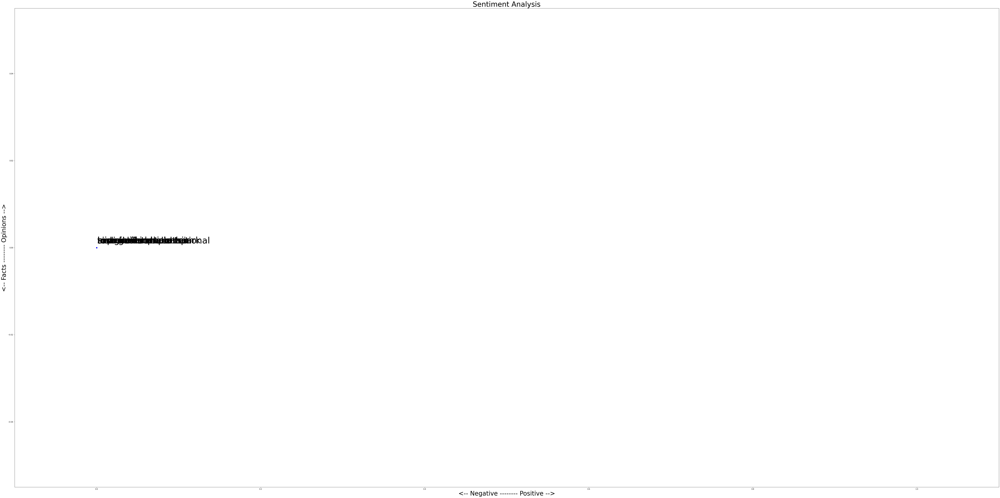

In [220]:
plot_sentiment_ngram(explore_trigram, -0.1, 1.1, 42)

Topic Modeling

In [ ]:
from gensim import matutils, models
import scipy.sparse

In [ ]:
import nltk
nltk.download('punkt')

In [ ]:

from sklearn.feature_extraction import text
from sklearn.feature_extraction.text import CountVectorizer
from nltk import word_tokenize, pos_tag


# Re-add the additional stop words since we are recreating the document-term matrix
add_stop_words = ['like', 'im', 'know', 'just', 'dont', 'thats', 'right', 'people',
                  'youre', 'got', 'gonna', 'time', 'think', 'yeah', 'said']
stop_words = text.ENGLISH_STOP_WORDS.union(add_stop_words)


# Let's create a function to pull out nouns and adjectives from a string of text
def nouns_adj(text):
    '''Given a string of text, tokenize the text and pull out only the nouns and adjectives.'''
    is_noun_adj = lambda pos: pos[:2] == 'NN' or pos[:2] == 'JJ'
    tokenized = word_tokenize(text)
    nouns_adj = [word for (word, pos) in pos_tag(tokenized) if is_noun_adj(pos)] 
    return ' '.join(nouns_adj)

def topics(data):
    data_nouns_adj = pd.DataFrame(data.Review_Whole.apply(nouns_adj))
    data_nouns_adj
    cvna = CountVectorizer(stop_words=stop_words, max_df=.8)
    data_cvna = cvna.fit_transform(data_nouns_adj.Review_Whole)
    data_dtmna = pd.DataFrame(data_cvna.toarray(), columns=cvna.get_feature_names())
    data_dtmna.index = data_nouns_adj.index
    data_dtmna
    corpusna = matutils.Sparse2Corpus(scipy.sparse.csr_matrix(data_dtmna.transpose()))
    id2wordna = dict((v, k) for k, v in cvna.vocabulary_.items())
    ldana = models.LdaModel(corpus=corpusna, num_topics=3, id2word=id2wordna, passes=10)
    return(ldana.print_topics())


In [ ]:
topics(restaurantdata)